# ******************** INX_Future_Inc_Employee_Performance ********************

In [1]:
# Importing IFrame from IPython.display to embed external content (e.g., web pages, PDFs) within a Jupyter Notebook
from IPython.display import IFrame

# Display PDF file inside Jupyter Notebook for reference
IFrame("CDS_Project_2_INX_Future_Emp_Data_V1.6.pdf", width=1080, height=485)

---
# **Domine Analysis:**
---

### **Business Case: INX Future Inc Employee Performance - Project**  

* INX Future Inc , (referred as INX ) , is one of the leading data analytics and automation solutions provider
with over 15 years of global business presence. INX is consistently rated as top 20 best employers past 5
years. INX human resource policies are considered as employee friendly and widely perceived as best
practices in the industry.
* Recent years, the employee performance indexes are not healthy and this is becoming a growing
concerns among the top management. There has been increased escalations on service delivery and
client satisfaction levels came down by 8 percentage points.
* CEO, Mr. Brain, knows the issues but concerned to take any actions in penalizing non-performing
employees as this would affect the employee morale of all the employees in general and may further
reduce the performance. Also, the market perception best employer and thereby attracting best talents
to join the company.
* Mr. Brain decided to initiate a data science project , which analyses the current employee data and find
the core underlying causes of this performance issues. Mr. Brain, being a data scientist himself, expects
the findings of this project will help him to take right course of actions. He also expects a clear indicators
of non performing employees, so that any penalization of non-performing employee, if required, may
not significantly affect other employee morals.
* The following insights are expected from this project.
   * 1. Department wise performances
   * 2. Top 3 Important Factors effecting employee performance
   * 3. A trained model which can predict the employee performance based on factors as inputs. This
will be used to hire employees
   * 4. Recommendations to improve the employee performance based on insights from analysis.

---

### **Feature Information:**

| **Feature Name**                  | **Description** |
|------------------------------------|----------------|
| **EmpNumber**                      | Unique employee identifier |
| **Age**                            | Age of the employee |
| **Gender**                         | Gender of the employee (Male/Female) |
| **EducationBackground**            | The employee's field of education (e.g., Marketing, Life Sciences, Medical, etc.) |
| **MaritalStatus**                  | Employee's marital status (Single/Married/Divorced) |
| **EmpDepartment**                  | The department where the employee works (Sales, HR, Development, Data Science, etc.) |
| **EmpJobRole**                     | The specific job role of the employee (Sales Executive, Manager, Senior Developer, Data Scientist, etc.) |
| **BusinessTravelFrequency**        | Frequency of business-related travel (Travel_Rarely, Travel_Frequently) |
| **DistanceFromHome**               | Distance from home to work (in miles) |
| **EmpEducationLevel**              | Employee's education level (1 to 5) |
| **EmpEnvironmentSatisfaction**     | Employee's satisfaction with work environment (1 to 4) |
| **EmpHourlyRate**                  | Hourly wage of the employee |
| **EmpJobInvolvement**              | Level of job involvement (1 to 4) |
| **EmpJobLevel**                    | Employee's job level in the company hierarchy (1 to 5) |
| **EmpJobSatisfaction**             | Employee's job satisfaction level (1 to 4) |
| **NumCompaniesWorked**             | Number of companies the employee has previously worked for |
| **OverTime**                       | Whether the employee works overtime (Yes/No) |
| **EmpLastSalaryHikePercent**       | Percentage of the last salary hike received |
| **EmpRelationshipSatisfaction**    | Employee's satisfaction with workplace relationships (1 to 4) |
| **TotalWorkExperienceInYears**     | Total years of work experience |
| **TrainingTimesLastYear**          | Number of training programs attended in the last year |
| **EmpWorkLifeBalance**             | Work-life balance rating (1 to 4) |
| **ExperienceYearsAtThisCompany**   | Years of experience within the current company |
| **ExperienceYearsInCurrentRole**   | Years of experience in the current role |
| **YearsSinceLastPromotion**        | Years since the last promotion |
| **YearsWithCurrManager**           | Years working with the current manager |
| **Attrition**                      | Whether the employee has left the company (Yes/No) |
| **PerformanceRating**              | Employee's performance rating |

---

In [155]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from ydata_profiling import ProfileReport

# Suppress warnings to avoid cluttering the output
warnings.filterwarnings("ignore")

In [2]:
# Display all columns in the dataset without truncation
pd.set_option("display.max_columns", None)

In [3]:
# Load the dataset from an Excel file
data = pd.read_excel("INX_Future_Inc_Employee_Performance_CDS_Project2_Data_V1.8.xls")
data

,EmpNumber,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating
0,E1001000,32,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,10,3,4,55,3,2,4,1,No,12,4,10,2,2,10,7,0,8,No,3
1,E1001006,47,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,14,4,4,42,3,2,1,2,No,12,4,20,2,3,7,7,1,7,No,3
2,E1001007,40,Male,Life Sciences,Married,Sales,Sales Executive,Travel_Frequently,5,4,4,48,2,3,1,5,Yes,21,3,20,2,3,18,13,1,12,No,4
3,E1001009,41,Male,Human Resources,Divorced,Human Resources,Manager,Travel_Rarely,10,4,2,73,2,5,4,3,No,15,2,23,2,2,21,6,12,6,No,3
4,E1001010,60,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,16,4,1,84,3,2,1,8,No,14,4,10,1,3,2,2,2,2,No,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1195,E100992,27,Female,Medical,Divorced,Sales,Sales Executive,Travel_Frequently,3,1,4,71,4,2,4,1,Yes,20,2,6,3,3,6,5,0,4,No,4
1196,E100993,37,Male,Life Sciences,Single,Development,Senior Developer,Travel_Rarely,10,2,4,80,4,1,4,3,No,17,1,4,2,3,1,0,0,0,No,3
1197,E100994,50,Male,Medical,Married,Development,Senior Developer,Travel_Rarely,28,1,4,74,4,1,3,1,Yes,11,3,20,3,3,20,8,3,8,No,3
1198,E100995,34,Female,Medical,Single,Data Science,Data Scientist,Travel_Rarely,9,3,4,46,2,3,2,1,No,14,2,9,3,4,8,7,7,7,No,3


---
# **Basic Check:**
---

In [7]:
data.shape    # Print the number of rows and columns

(1200, 28)

In [10]:
data.head()   # Display first few rows

,EmpNumber,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating
0,E1001000,32,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,10,3,4,55,3,2,4,1,No,12,4,10,2,2,10,7,0,8,No,3
1,E1001006,47,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,14,4,4,42,3,2,1,2,No,12,4,20,2,3,7,7,1,7,No,3
2,E1001007,40,Male,Life Sciences,Married,Sales,Sales Executive,Travel_Frequently,5,4,4,48,2,3,1,5,Yes,21,3,20,2,3,18,13,1,12,No,4
3,E1001009,41,Male,Human Resources,Divorced,Human Resources,Manager,Travel_Rarely,10,4,2,73,2,5,4,3,No,15,2,23,2,2,21,6,12,6,No,3
4,E1001010,60,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,16,4,1,84,3,2,1,8,No,14,4,10,1,3,2,2,2,2,No,3


In [12]:
data.tail()    # Display last few rows

,EmpNumber,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating
1195,E100992,27,Female,Medical,Divorced,Sales,Sales Executive,Travel_Frequently,3,1,4,71,4,2,4,1,Yes,20,2,6,3,3,6,5,0,4,No,4
1196,E100993,37,Male,Life Sciences,Single,Development,Senior Developer,Travel_Rarely,10,2,4,80,4,1,4,3,No,17,1,4,2,3,1,0,0,0,No,3
1197,E100994,50,Male,Medical,Married,Development,Senior Developer,Travel_Rarely,28,1,4,74,4,1,3,1,Yes,11,3,20,3,3,20,8,3,8,No,3
1198,E100995,34,Female,Medical,Single,Data Science,Data Scientist,Travel_Rarely,9,3,4,46,2,3,2,1,No,14,2,9,3,4,8,7,7,7,No,3
1199,E100998,24,Female,Life Sciences,Single,Sales,Sales Executive,Travel_Rarely,3,2,1,65,3,2,3,9,No,14,1,4,3,3,2,2,2,0,Yes,2


In [14]:
data.info()    # Display summary information about the dataset

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 28 columns):
 #   Column                        Non-Null Count  Dtype 
---  ------                        --------------  ----- 
 0   EmpNumber                     1200 non-null   object
 1   Age                           1200 non-null   int64 
 2   Gender                        1200 non-null   object
 3   EducationBackground           1200 non-null   object
 4   MaritalStatus                 1200 non-null   object
 5   EmpDepartment                 1200 non-null   object
 6   EmpJobRole                    1200 non-null   object
 7   BusinessTravelFrequency       1200 non-null   object
 8   DistanceFromHome              1200 non-null   int64 
 9   EmpEducationLevel             1200 non-null   int64 
 10  EmpEnvironmentSatisfaction    1200 non-null   int64 
 11  EmpHourlyRate                 1200 non-null   int64 
 12  EmpJobInvolvement             1200 non-null   int64 
 13  EmpJobLevel       

# Insight :-

- consists of **1,200 employee records** with **28 features**, including **demographic, job-related, and performance metrics**.  
- **does not have any null (missing) values** since all columns show **1,200 non-null** entries, meaning every row is complete.  
- **Categorical Variables (9):-**  EmpNumber, Gender, EducationBackground, MaritalStatus, EmpDepartment, EmpJobRole, BusinessTravelFrequency, OverTime, and Attrition.  
- **Numerical Variables (19):-** Age, DistanceFromHome, EmpEducationLevel, EmpEnvironmentSatisfaction, EmpHourlyRate, EmpJobInvolvement, EmpJobLevel, EmpJobSatisfaction, NumCompaniesWorked, EmpLastSalaryHikePercent, EmpRelationshipSatisfaction, TotalWorkExperienceInYears, TrainingTimesLastYear, EmpWorkLifeBalance, ExperienceYearsAtThisCompany, ExperienceYearsInCurrentRole, YearsSinceLastPromotion, YearsWithCurrManager, and PerformanceRating.  

In [17]:
data.describe()    # Display statistical summary of numerical columns

,Age,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,PerformanceRating
count,1200.000000,1200.000000,1200.00000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000
mean,36.918333,9.165833,2.89250,2.715833,65.981667,2.731667,2.067500,2.732500,2.665000,15.222500,2.725000,11.330000,2.785833,2.744167,7.077500,4.291667,2.194167,4.105000,2.948333
std,9.087289,8.176636,1.04412,1.090599,20.211302,0.707164,1.107836,1.100888,2.469384,3.625918,1.075642,7.797228,1.263446,0.699374,6.236899,3.613744,3.221560,3.541576,0.518866
min,18.000000,1.000000,1.00000,1.000000,30.000000,1.000000,1.000000,1.000000,0.000000,11.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,2.000000
25%,30.000000,2.000000,2.00000,2.000000,48.000000,2.000000,1.000000,2.000000,1.000000,12.000000,2.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000,3.000000
50%,36.000000,7.000000,3.00000,3.000000,66.000000,3.000000,2.000000,3.000000,2.000000,14.000000,3.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000,3.000000
75%,43.000000,14.000000,4.00000,4.000000,83.000000,3.000000,3.000000,4.000000,4.000000,18.000000,4.000000,15.000000,3.000000,3.000000,10.000000,7.000000,3.000000,7.000000,3.000000
max,60.000000,29.000000,5.00000,4.000000,100.000000,4.000000,5.000000,4.000000,9.000000,25.000000,4.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000,4.000000


## **Key Insights:**  
- **Age & Experience:** Employees range from **18 to 60 years**, with an average of **~37 years**. Work experience varies significantly (0 to 40 years), indicating a mix of freshers and experienced staff.  
- **Job Satisfaction & Work-Life Balance:** Median scores of **3 (neutral to satisfied)** suggest room for improvement in employee engagement.  
- **Distance from Home:** Varies **1 to 29 km**, with an average of **~9 km**—some employees commute long distances.  
- **Promotion & Growth:** Many employees have **0 years since last promotion**, indicating possible career stagnation.  
- **Performance & Salary Hike:** Most employees have a **performance rating of 3 or 4**, with salary hikes ranging from **11% to 25%**.  


In [20]:
data.describe(include="O")    # Display summary of categorical columns

,EmpNumber,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,OverTime,Attrition
count,1200,1200,1200,1200,1200,1200,1200,1200,1200
unique,1200,2,6,3,6,19,3,2,2
top,E1001000,Male,Life Sciences,Married,Sales,Sales Executive,Travel_Rarely,No,No
freq,1,725,492,548,373,270,846,847,1022


## **Key Insights:**  
- **Gender Distribution:** Majority of employees are **male (725 out of 1200, ~60%)**, indicating a gender imbalance.  
- **Education Background:** **Life Sciences (492 employees, ~41%)** is the most common field of study.  
- **Marital Status:** Most employees are **married (548 employees, ~46%)**, which may impact work-life balance.  
- **Department & Job Role:**  
  - **Sales (373 employees, ~31%)** is the largest department.  
  - **Sales Executive (270 employees)** is the most common job role.  
- **Business Travel:** **846 employees (~71%) travel rarely**, while the rest travel frequently or extensively.  
- **Overtime:** Almost **half of employees (847)** **do not work overtime**.  
- **Attrition:** **Only 178 employees (14.8%)** left, meaning retention is relatively high.  

# Profile Report of This Data

In [25]:
# Generate an automated data profiling report
profile = ProfileReport(data, title="Profile Report", explorative=True)
profile.config.vars.num.chi_squared_threshold = 0.0    # Disable chi-square test
profile.to_notebook_iframe()    # Display the report inside the notebook

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|█████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 120.75it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

---
# **Exploratory Data Analysis (EDA)**:
---

## 1) Unnivariate Analysis

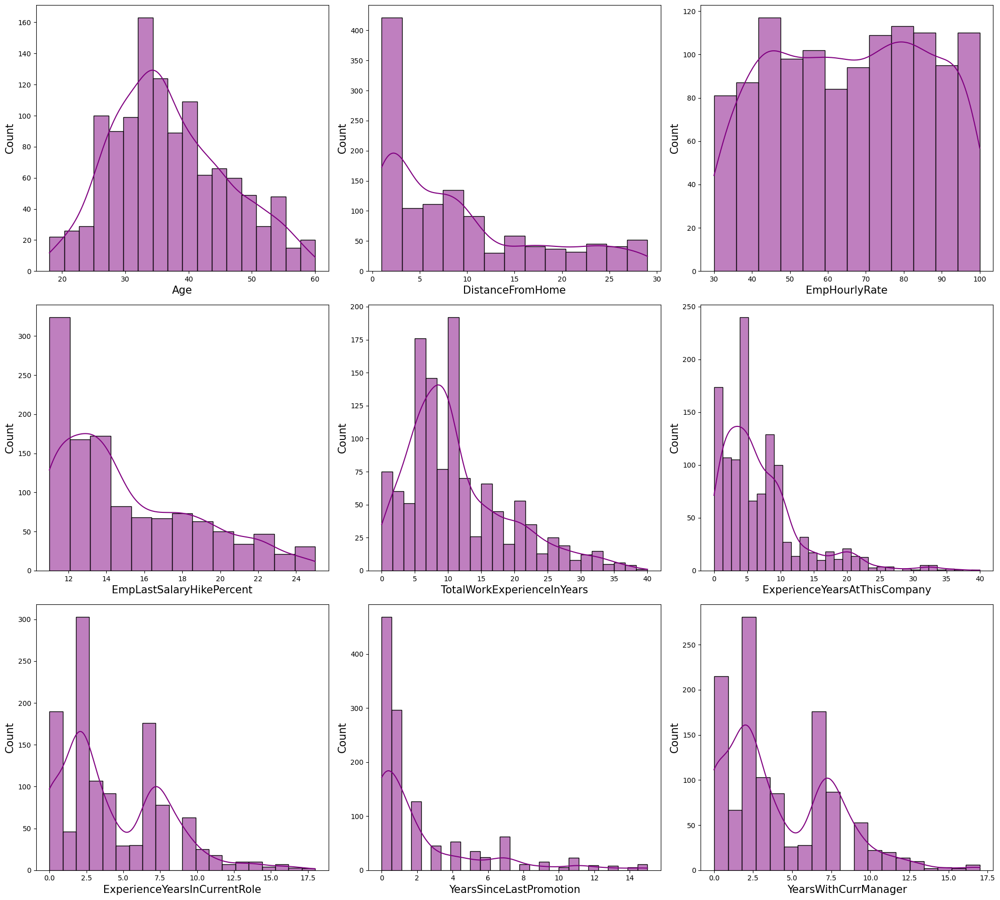

In [27]:
# List of continuous numerical columns for histogram visualization
countinue_col = ["Age","DistanceFromHome","EmpHourlyRate","EmpLastSalaryHikePercent","TotalWorkExperienceInYears",
                 "ExperienceYearsAtThisCompany","ExperienceYearsInCurrentRole","YearsSinceLastPromotion","YearsWithCurrManager"]

# Plot histograms for continuous numerical columns
plt.figure(figsize=(20,18))  # Set figure size
num = 1  # Subplot counter

for column in countinue_col:
    if num<=len(countinue_col):
        plt.subplot(3,3,num)  # Arrange subplots in a 3-row, 3-column grid
        sns.histplot(data[column], kde=True, color='purple')    # Histogram with KDE overlay
        plt.xlabel(column,fontsize=15)  # Set x-axis label with proper font size
        plt.ylabel('Count',fontsize=15)  # Set y-axis label with proper font size
        plt.xticks(fontsize=10)  # Adjust x-axis tick size for better readability
        plt.yticks(fontsize=10)  # Adjust y-axis tick size
    num+=1  # Increment counter only if subplot is created

plt.tight_layout()  # Adjust subplot layout to prevent overlapping
plt.show()  # Display the plots

### **Key Insights Based On The Histograms :-**

1. **Age Distribution**:  
   - Most employees are between **25 to 40 years old**, with a peak around **30-35 years**.  
   - The distribution is **slightly right-skewed**, meaning fewer older employees.  
---
2. **Distance From Home**:  
   - Most employees **live close to work (0-5 km)**.  
   - Fewer employees travel **longer distances (15+ km)**, suggesting proximity to work may be a factor in job retention.  
---
3. **Hourly Rate**:  
   - Fairly **uniformly distributed**, indicating a **diverse pay structure** among employees.  
---
4. **Last Salary Hike Percentage**:  
   - The **most common salary hike is around 12-14%**.  
   - A few employees received **higher raises (20-25%)**, but they are less frequent.  
---
5. **Total Work Experience in Years**:  
   - Peaks around **5-10 years of experience**, with fewer employees having **30+ years of experience**.  
---
6. **Experience at the Current Company**:  
   - Most employees have **less than 5 years** at the company.  
   - Very few employees have stayed for **more than 20 years**, suggesting possible attrition over time.  
---
7. **Experience in Current Role**:  
   - Most employees have been in their **current role for 1-5 years**, with fewer staying in the same role beyond **10 years**.  
---
8. **Years Since Last Promotion**:  
   - A **significant number** of employees **haven’t been promoted in the last 5 years**, which could impact job satisfaction and attrition.  
---
9. **Years With Current Manager**:  
   - Majority of employees have been with their **current manager for 2-5 years**, but some have **stayed for over 10 years**.
--- 

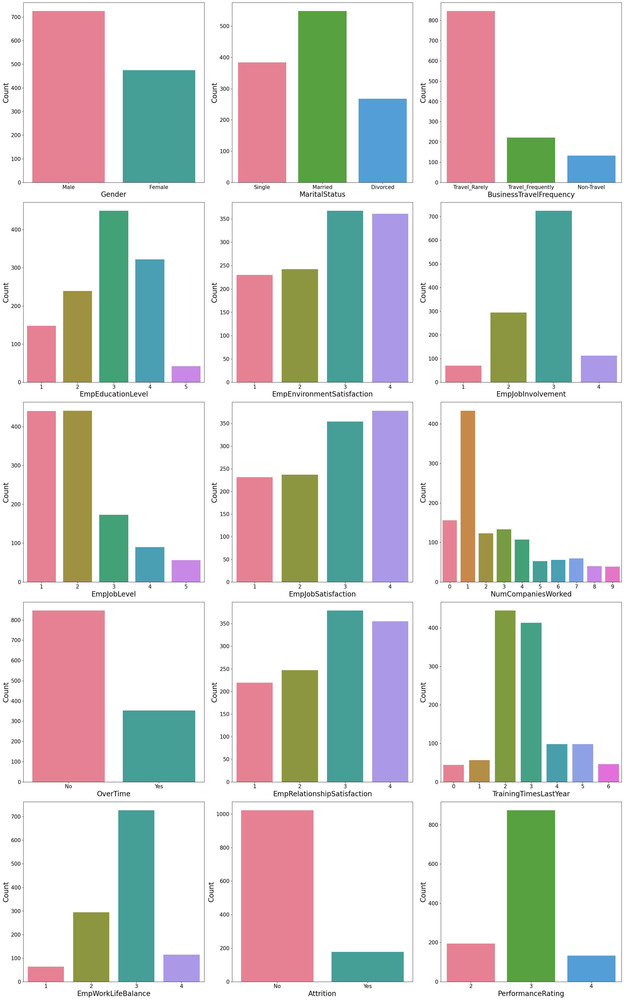

In [33]:
# List of categorical columns for count plots
dis_cat_col = ["Gender","MaritalStatus","BusinessTravelFrequency","EmpEducationLevel","EmpEnvironmentSatisfaction",
               "EmpJobInvolvement","EmpJobLevel","EmpJobSatisfaction","NumCompaniesWorked","OverTime","EmpRelationshipSatisfaction",
               "TrainingTimesLastYear","EmpWorkLifeBalance","Attrition","PerformanceRating"]

# Plot count plots for categorical columns
plt.figure(figsize=(25,40))  # Set figure size
num = 1  # Subplot counter

for column in dis_cat_col:
    if num<=len(dis_cat_col):
        plt.subplot(5, 3, num)  # Arrange subplots in a 5-row, 3-column grid
        sns.countplot(x = data[column], palette="husl")  # Count plot
        plt.xlabel(column, fontsize=20)  # Set x-axis label with proper font size
        plt.ylabel('Count', fontsize=20)  # Set y-axis label with proper font size
        plt.xticks(fontsize=15)  # Adjust x-axis tick size for better readability
        plt.yticks(fontsize=15)  # Adjust y-axis tick size
    num+=1  # Increment counter only if subplot is created

plt.tight_layout()  # Adjust subplot layout to prevent overlapping
plt.show()  # Display the plots

### **Key Insights Based On The Countplot :-**
* **1. Gender**  
    - **Insight:** There are more **male employees** than female employees.
    - **Possible Impact:** This could indicate gender disparity in hiring, retention, or promotion rates.  

---

* **2. Marital Status**  
    - **Insight:** **Married employees** are the most common, followed by single employees, and then divorced employees.  
    - **Possible Impact:** Marital status might influence **work-life balance, stability, and attrition rates**. Married employees may have different priorities compared to single employees.

---

* **3. Business Travel Frequency**  
    - **Insight:** The majority of employees **travel rarely**, with fewer employees traveling frequently or not at all.  
    - **Possible Impact:** Frequent travel could be linked to **higher attrition**, stress, or work-life balance challenges.

---

* **4. Education Level**  
    - **Insight:** Employees have varying education levels, with **levels 2 and 4 being more common**.  
    - **Possible Impact:** Education level may impact **job level, promotions, and satisfaction**.

---

* **5. Environment Satisfaction**  
    - **Insight:** Employees have **moderate to high satisfaction (levels 3 and 4 are dominant)**.  
    - **Possible Impact:** A high environment satisfaction is **good for retention**. If many employees were dissatisfied, it could lead to attrition.

---

* **6. Job Involvement**  
    - **Insight:** Most employees have **moderate to high job involvement (levels 3 and 4)**.  
    - **Possible Impact:** High job involvement often correlates with **better performance and lower attrition**.

---

* **7. Employee Level**  
    - **Insight:** The majority of employees are at **level 1**, with fewer at higher levels.  
    - **Possible Impact:** A large number of lower-level employees might indicate **a young workforce** or **limited internal promotions**.

---

* **8. Job Satisfaction**  
    - **Insight:** Most employees have **satisfaction levels of 3 or 4**, meaning they are generally satisfied.  
    - **Possible Impact:** High job satisfaction reduces attrition. However, some dissatisfaction could indicate **issues with leadership, pay, or workload**.

---

* **9. Number of Companies Worked**  
    - **Insight:** Most employees have worked for **1 or 2 companies** before their current job.  
    - **Possible Impact:** Employees who have worked for multiple companies (higher numbers) may have **higher attrition risks**.

---

* **10. Overtime**  
    - **Insight:** A **majority of employees do not work overtime**, but a smaller group does.  
    - **Possible Impact:** Employees who frequently work overtime may experience **burnout and higher attrition rates**.

---

* **11. Relationship Satisfaction**  
    - **Insight:** Most employees rate their relationship satisfaction as **3 or 4**.  
    - **Possible Impact:** Good workplace relationships can **improve teamwork and job satisfaction**, reducing conflicts and attrition.

---

* **12. Training Times Last Year**  
    - **Insight:** Most employees received **2 or 3 training sessions**, with fewer receiving more than 4.  
    - **Possible Impact:** Regular training helps in **career growth and skill improvement**, leading to higher retention.

---

* **13. Work-Life Balance**  
    - **Insight:** Most employees rate their work-life balance as **level 3**.  
    - **Possible Impact:** If work-life balance is low, it could contribute to **burnout and attrition**.

---

* **14. Attrition**  
    - **Insight:** Most employees **stay**, but a smaller portion has **left the company**.  
    - **Possible Impact:** High attrition rates may indicate **job dissatisfaction, workload issues, or better opportunities elsewhere**.

---

* **15. Performance Rating**  
    - **Insight:** The majority of employees have a **performance rating of 3**, meaning most are **average performers**.  
    - **Possible Impact:** A high concentration in one rating suggests **limited differentiation in performance evaluations**, which could affect **motivation and promotions**.
---

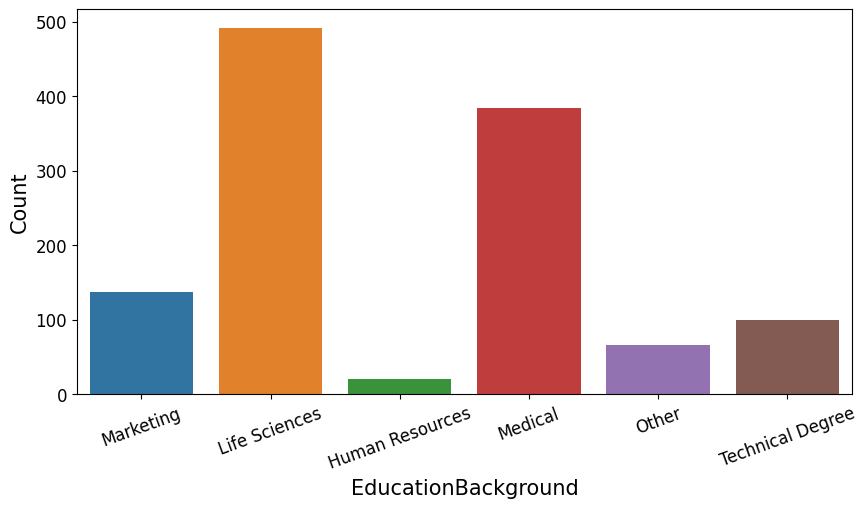

In [35]:
# Count Plots for 'EducationBackground'
plt.figure(figsize=(10,5))  # Set figure size
sns.countplot(x = data['EducationBackground'], palette="tab10")  # count plot
plt.xlabel('EducationBackground', fontsize=15)  # Set x-axis label with proper font size
plt.ylabel('Count', fontsize=15)  # Set y-axis label with proper font size
plt.xticks(fontsize=12,rotation=20)  # Adjust x-axis tick size and Adjust rotation for better readability
plt.yticks(fontsize=12)  # Adjust y-axis tick size
plt.show()  # Display the plots

### **Insights From The Education Background Graph :-**  

1. **Dominant Fields:**  
   - **Life Sciences** is the most common education background, with nearly **500 employees**.  
   - **Medical** is the second most frequent background, with close to **400 employees**.  

2. **Less Common Fields:**  
   - **Marketing**, **Technical Degree**, and **Other** fields have moderate representation.  
   - **Human Resources (HR)** has the lowest count, meaning fewer employees come from an HR background.  

3. **Possible Implications:**  
   - Since most employees come from **Life Sciences and Medical**, the company might be in the **healthcare, pharmaceutical, or biotech industry**.  
   - The low number of HR professionals could indicate **a lean HR department** or **limited HR hiring**.  
   - If technical roles require specialized degrees, a lower count of **Technical Degrees** might suggest the company prefers training employees internally.  

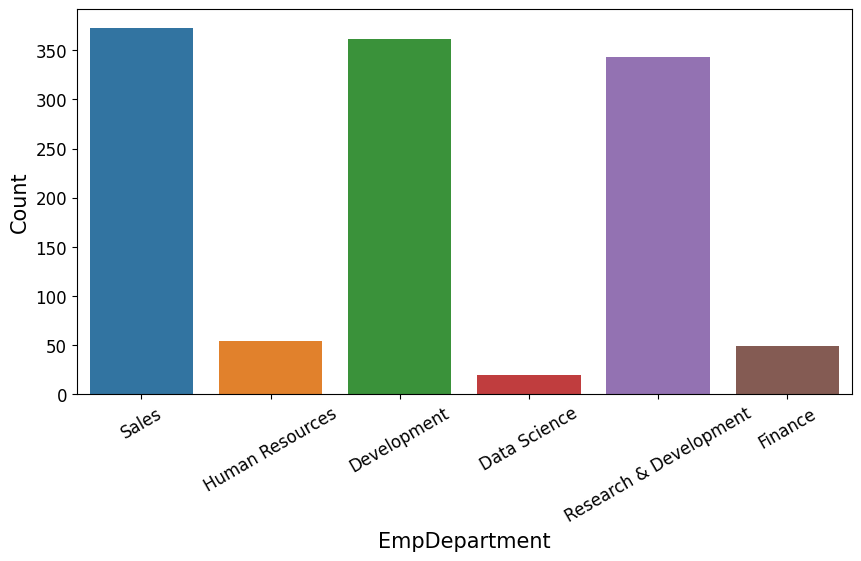

In [37]:
# Count plot for 'EmpDepartment'
plt.figure(figsize=(10,5))  # Set figure size
sns.countplot(x = data['EmpDepartment'], palette="tab10")  # count plot
plt.xlabel("EmpDepartment", fontsize=15)  # Set x-axis label with proper font size
plt.ylabel('Count', fontsize=15)  # Set y-axis label with proper font size
plt.xticks(fontsize=12,rotation=30)  # Adjust x-axis tick size and Adjust rotation for better readability
plt.yticks(fontsize=12)  # Adjust y-axis tick size
plt.show()  # Display the plots

### **Insights From The Employee Department Graph :-**  

1. **Most Common Departments:**  
   - **Sales, Development, and Research & Development (R&D)** have the highest employee counts.  
   - These three departments seem to be the **core functions** of the company.  

2. **Least Common Departments:**  
   - **Data Science has the lowest count**, suggesting that this field might not be a major focus yet.  
   - **Human Resources (HR) and Finance** have relatively small teams, indicating **lean support functions**.  

3. **Possible Implications:**  
   - A high number of employees in **Sales and Development** may indicate that the company is **growth-focused**, selling products/services while expanding technical capabilities.  
   - A **small Data Science team** could mean the company is **not heavily data-driven yet** or is outsourcing these tasks.  
   - A **small HR team** might suggest a **potential challenge in managing employee satisfaction, hiring, and retention**.  


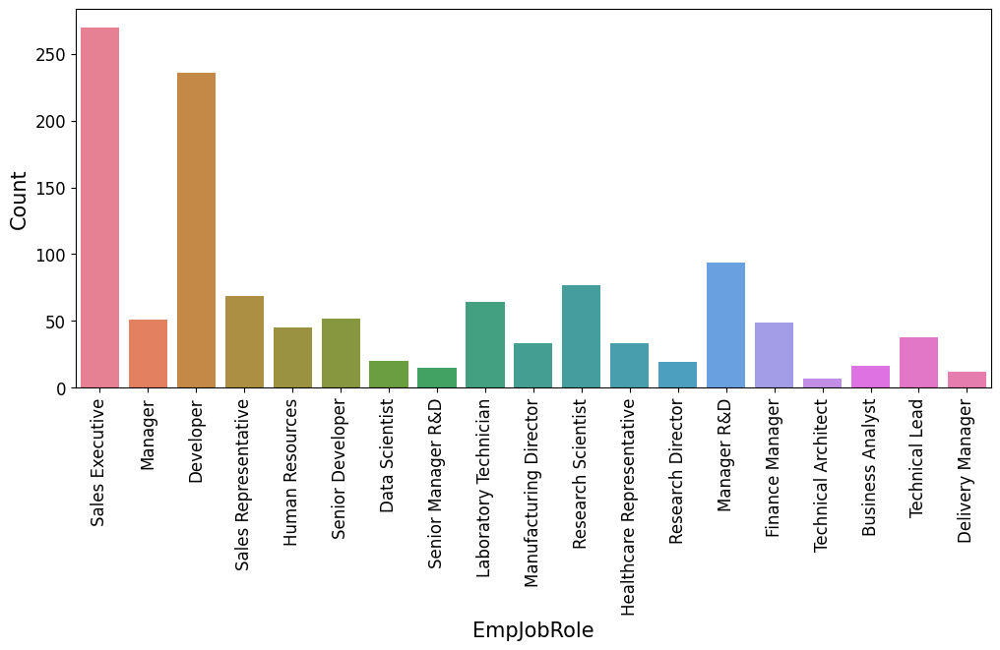

In [39]:
# Count plot for 'EmpJobRole'
plt.figure(figsize=(12,5))  # Set figure size
sns.countplot(x = data['EmpJobRole'], palette="husl")  # count plot
plt.xlabel('EmpJobRole', fontsize=15)  # Set x-axis label with proper font size
plt.ylabel('Count', fontsize=15)  # Set y-axis label with proper font size
plt.xticks(fontsize=12,rotation=90)  # Adjust x-axis tick size and Adjust rotation for better readability
plt.yticks(fontsize=12)  # Adjust y-axis tick size 
plt.show()  # Display the plots

### **Insights From The Employee Job Role Graph :-**  

1. **Most Common Roles:**  
   - **Sales Executive** has the highest count, suggesting a strong focus on **sales and revenue generation**.  
   - **Developer** is the second most common role, indicating a significant emphasis on **technical and product development**.  
   - **Managers** also have a high count, likely due to hierarchical structuring within departments.  

2. **Less Common Roles:**  
   - **Technical Architect, Business Analyst, Delivery Manager, and Data Scientist** have relatively few employees.  
   - This suggests that **data-driven decision-making, business analysis, and technical strategy roles** may not be a primary focus.  

3. **Possible Implications:**  
   - A **large sales team** suggests the company relies on **active selling and client engagement** for growth.  
   - A **strong developer presence** aligns with businesses in **tech, software, or product-driven industries**.  
   - **Few Data Scientists** indicate that **data analytics and AI/ML initiatives** may not be heavily invested in yet.  

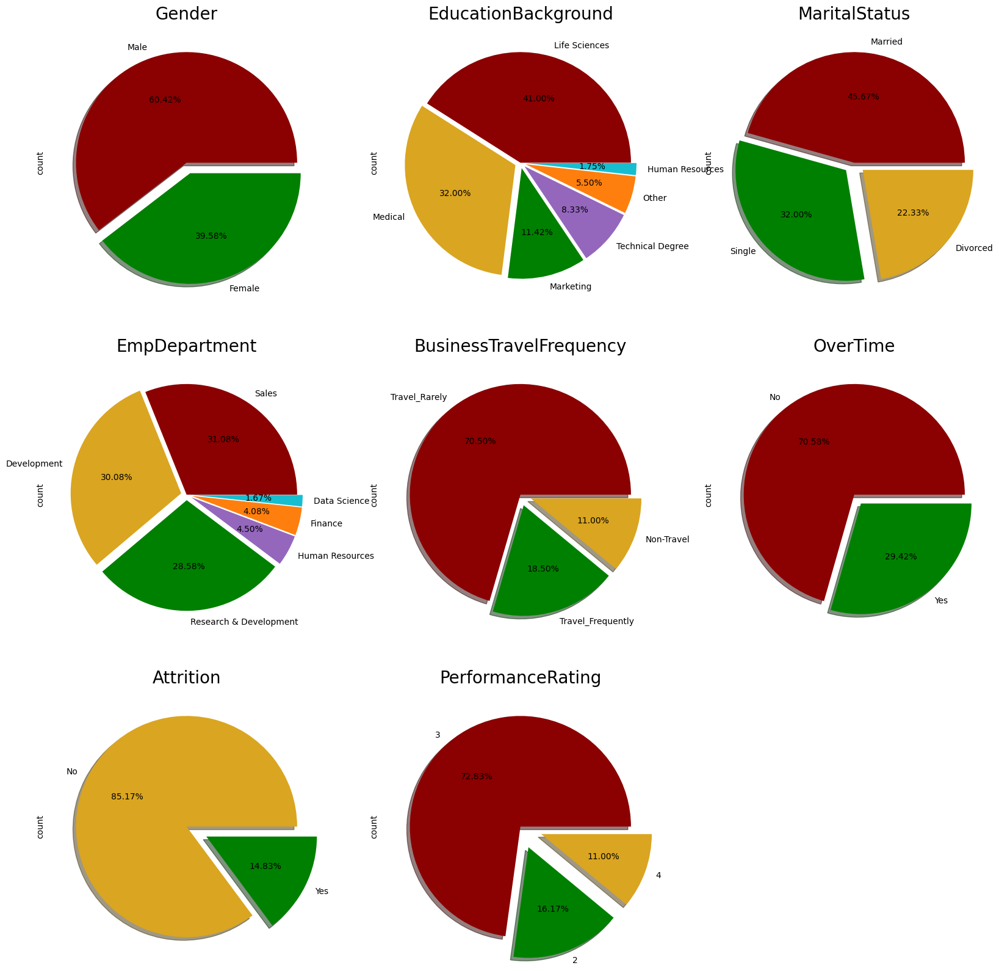

In [41]:
# List of categorical columns to visualize as pie charts
pie_col = ['Gender','EducationBackground','MaritalStatus','EmpDepartment','BusinessTravelFrequency','OverTime','Attrition','PerformanceRating']

# Set figure size for better visibility
plt.figure(figsize=(20,20))

# Pie chart for 'Gender'
plt.subplot(3,3,1)  # Arrange subplots in a 3-row, 3-column, plot-1 grid
data['Gender'].value_counts().plot.pie(autopct="%1.2f%%", explode=(0, 0.1), shadow=True, colors = ['darkred', 'green','goldenrod'])  # Pie Plot
plt.title('Gender',fontsize = 20)  # Set title for the plot

# Pie chart for 'EducationBackground'
plt.subplot(3,3,2)  # Arrange subplots in a 3-row, 3-column, plot-2 grid
data['EducationBackground'].value_counts().plot.pie(autopct="%1.2f%%", explode=(0,0.05,0.05,0.05,0.05,0.05), 
                                                    colors = ['darkred','goldenrod','green','tab:purple','tab:orange','tab:cyan'])  # Pie Plot
plt.title('EducationBackground',fontsize = 20)  # Set title for the plot

# Pie chart for 'MaritalStatus'
plt.subplot(3,3,3)  # Arrange subplots in a 3-row, 3-column, plot-3 grid
data['MaritalStatus'].value_counts().plot.pie(autopct="%1.2f%%", explode=(0, 0.1, 0.1), shadow=True, colors = ['darkred', 'green','goldenrod'])
plt.title('MaritalStatus',fontsize = 20)  # Set title for the plot

# Pie chart for 'EmpDepartment'
plt.subplot(3,3,4)  # Arrange subplots in a 3-row, 3-column, plot-4 grid
data['EmpDepartment'].value_counts().plot.pie(autopct="%1.2f%%", explode=(0,0.05,0.05,0.05,0.05,0.05), 
                                              colors = ['darkred','goldenrod','green','tab:purple','tab:orange','tab:cyan'])  # Pie Plot
plt.title('EmpDepartment',fontsize = 20)  # Set title for the plot

# Pie chart for 'BusinessTravelFrequency'
plt.subplot(3,3,5)  # Arrange subplots in a 3-row, 3-column, plot-5 grid
data['BusinessTravelFrequency'].value_counts().plot.pie(autopct="%1.2f%%", explode=(0, 0.1, 0.1), shadow=True, colors = ['darkred', 'green','goldenrod'])
plt.title('BusinessTravelFrequency',fontsize = 20)  # Set title for the plot

# Pie chart for 'OverTime'# Pie chart for 'OverTime'
plt.subplot(3,3,6)  # Arrange subplots in a 3-row, 3-column, plot-6 grid
data['OverTime'].value_counts().plot.pie(autopct="%1.2f%%", explode=(0, 0.1), shadow=True, colors = ['darkred', 'green','goldenrod'])  # Pie Plot
plt.title('OverTime',fontsize = 20)  # Set title for the plot

# Pie chart for 'Attrition'
plt.subplot(3,3,7)  # Arrange subplots in a 3-row, 3-column, plot-7 grid
data['Attrition'].value_counts().plot.pie(autopct="%1.2f%%", explode=(0, 0.2), shadow=True, colors = ['goldenrod', 'green'])  # Pie Plot
plt.title('Attrition',fontsize = 20)  # Set title for the plot

# Pie chart for 'PerformanceRating'
plt.subplot(3,3,8)  # Arrange subplots in a 3-row, 3-column, plot-8 grid
data['PerformanceRating'].value_counts().plot.pie(autopct="%1.2f%%", explode=(0, 0.2, 0.2), shadow=True, colors = ['darkred', 'green','goldenrod'])
plt.title('PerformanceRating',fontsize = 20)  # Set title for the plot

# Adjust layout and display the plots
plt.show()

### **Insights From The Pie Charts :-**  

1. **Gender Distribution**  
   - **Male employees (60.42%)** outnumber **female employees (39.58%)**, indicating a **gender imbalance** in the workforce.  
   - This could impact workplace diversity and inclusivity initiatives.  
---
2. **Education Background**  
   - The majority of employees come from **Life Sciences (41%)** and **Medical (32%)** fields.  
   - **Technical degrees and Data Science roles are underrepresented**, suggesting **limited technical expertise** in certain areas.  
---
3. **Marital Status**  
   - **Married employees (45.67%)** form the largest group, followed by **Single (32%)** and **Divorced (22.33%)**.  
   - This may influence **benefits planning** (e.g., family insurance, work-life balance policies).  
---
4. **Department Distribution**  
   - **Sales (31.08%), Development (30.08%), and R&D (28.58%)** dominate the workforce.  
   - **Data Science, Finance, and HR have significantly lower representation**, which may impact strategic decision-making in these areas.  
---
5. **Business Travel Frequency**  
   - **70.5% of employees travel rarely**, while **18.5% travel frequently**, and **11% do not travel at all**.  
   - Frequent travelers may have **higher burnout and attrition risks** due to work-life balance challenges.  
---
6. **Overtime Work**  
   - **70.58% of employees do not work overtime**, while **29.42% do**.  
   - Overtime can correlate with **job satisfaction, stress, and retention issues**.  
---
7. **Attrition Rate**  
   - **85.17% of employees remain in the company**, while **14.83% have left**.  
   - Identifying the **departments or roles with the highest attrition** could help improve **retention strategies**.  
---
8. **Performance Rating**  
   - The majority (72.83%) of employees have a **performance rating of 3**.  
   - **16.17% have a rating of 2**, while only **11% have a top rating of 4**.  
   - The **low percentage of top performers** might indicate **a lack of motivation or growth opportunities**.  

---
## 2) Bivariate Analysis

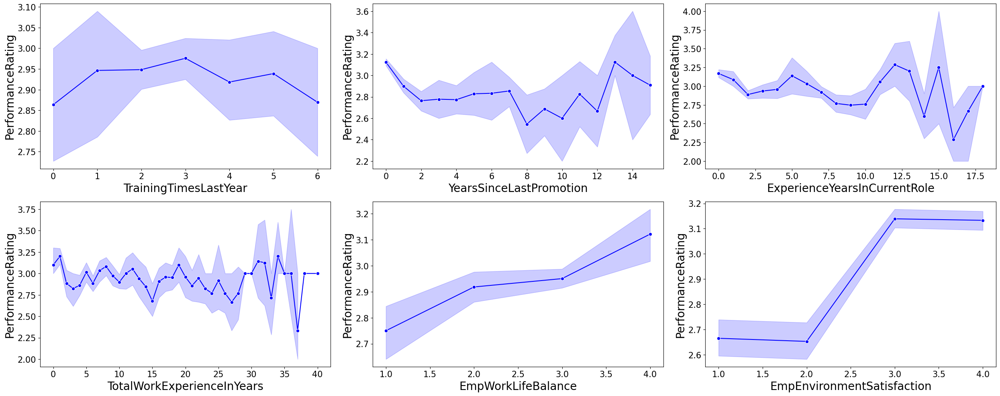

In [44]:
# List of numerical features to compare with PerformanceRating
line1 = ["TrainingTimesLastYear","YearsSinceLastPromotion","ExperienceYearsInCurrentRole","TotalWorkExperienceInYears",
     "EmpWorkLifeBalance","EmpEnvironmentSatisfaction"]
plt.figure(figsize=(25,10))  # Set figure size
num = 1  # Subplot counter

for column in line1:
    if num<=len(line1):
        plt.subplot(2, 3, num)  # Arrange subplots in a 2-row, 3-column grid
        sns.lineplot(x = data[column], y = data['PerformanceRating'], color = "blue",  marker='o')  # Line plot with blue color and markers
        plt.xlabel(column,fontsize=20)  # Set x-axis label with proper font size
        plt.ylabel('PerformanceRating',fontsize=20)  # Set y-axis label with proper font size
        plt.xticks(fontsize=15)  # Adjust x-axis tick size for better readability
        plt.yticks(fontsize=15)  # Adjust y-axis tick size
    num+=1  # Increment counter only if subplot is created

plt.tight_layout()  # Adjust subplot layout to prevent overlapping
plt.show()  # Display the plots

### **Insights from Performance Rating Trends :-**

1. **Training Times Last Year vs. Performance Rating**  
   - Employees who **receive more training generally perform better**.  
   - However, after **3-4 training sessions**, performance stabilizes, suggesting **diminishing returns**.  
   - **Recommendation**: Optimize training programs to ensure employees **gain value without overloading them**.
---
2. **Years Since Last Promotion vs. Performance Rating**  
   - Employees who were **recently promoted tend to have higher performance ratings**.  
   - Performance **declines slightly** over time if a promotion does not happen, indicating **demotivation over time**.  
   - **Recommendation**: Implement a **structured promotion plan** to keep employees motivated.
---
3. **Experience Years in Current Role vs. Performance Rating**  
   - Performance is **stable for the first few years** but shows **a peak around 5-7 years**.  
   - After **10 years, performance fluctuates**, possibly due to **lack of career progression or burnout**.  
   - **Recommendation**: Offer **new challenges and responsibilities** to long-tenured employees.
---
4. **Total Work Experience vs. Performance Rating**  
   - No **strong correlation** between total work experience and performance.  
   - Some employees with **30+ years of experience show strong performance**, but variability is high.  
   - **Recommendation**: Focus on **continuous learning and upskilling**, not just experience.
---
5. **Work-Life Balance vs. Performance Rating**  
   - Employees with **higher work-life balance ratings (3 or 4) perform better**.  
   - **Poor work-life balance negatively impacts performance**.  
   - **Recommendation**: Encourage flexible work arrangements to **improve employee productivity**.
---
6. **Environment Satisfaction vs. Performance Rating**  
   - A **strong positive correlation** exists: **higher environment satisfaction leads to better performance**.  
   - Employees rating **3 or 4 show significantly higher performance ratings**.  
   - **Recommendation**: Enhance **workplace culture, facilities, and job satisfaction initiatives**.

---

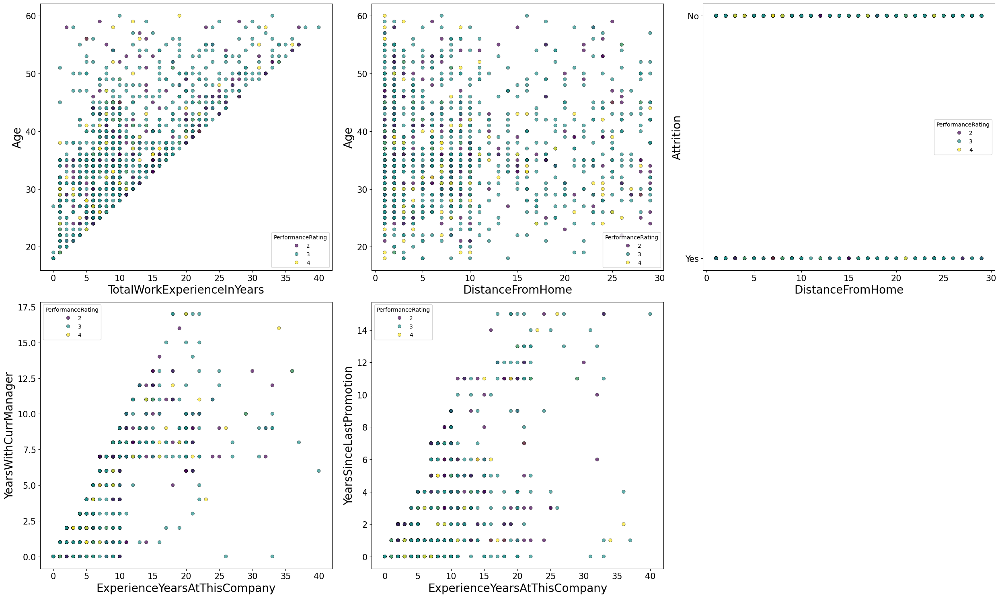

In [46]:
# Define x and y-axis feature pairs
x_axis = ['TotalWorkExperienceInYears','DistanceFromHome','DistanceFromHome','ExperienceYearsAtThisCompany','ExperienceYearsAtThisCompany']
y_axis = ['Age','Age','Attrition','YearsWithCurrManager'	,'YearsSinceLastPromotion']

plt.figure(figsize=(25,15))  # Set figure size  # Set figure size
num = 1  # Subplot counter

for x_column, y_column in zip(x_axis, y_axis):
    if num<=len(x_axis):  # Ensure we don’t exceed subplot count
        plt.subplot(2, 3, num)  # Arrange subplots in a 2-row, 3-column grid
        sns.scatterplot(x = data[x_column], y = data[y_column], hue = data['PerformanceRating'],      # scatter plot
                        palette="viridis", alpha=0.7, edgecolor="black")  # Better visualization
        plt.xlabel(x_column,fontsize=20)  # Set x-axis label with proper font size
        plt.ylabel(y_column,fontsize=20)  # Set y-axis label with proper font size
        plt.xticks(fontsize=15)  # Adjust x-axis tick size for better readability
        plt.yticks(fontsize=15)  # Adjust y-axis tick size
    num+=1  # Increment counter only if subplot is created

plt.tight_layout()  # Adjust subplot layout to prevent overlapping
plt.show()  # Display the plots

### **Insights From scatterplot :-**

1. **Total Work Experience vs. Age**  
   - As expected, **total work experience and age are highly correlated**.  
   - Employees with **higher experience (30+ years) have varying performance ratings**, indicating that tenure alone does not determine performance.  
   - **Recommendation**: Focus on **skill development and engagement strategies** for experienced employees.
---
2. **Age vs. Distance from Home**  
   - No strong pattern is visible, but **younger employees tend to have more variation in commute distances**.  
   - Performance ratings seem **evenly distributed**, meaning distance does not significantly affect performance.  
   - **Recommendation**: Provide **flexible work options** for employees with longer commutes to reduce attrition.
---
3. **Attrition vs. Distance from Home**  
   - Employees who **left (Yes for attrition) are spread across different distances**.  
   - This suggests that **commuting distance alone is not a major factor in attrition**.  
   - **Recommendation**: Investigate other factors (e.g., **career growth, satisfaction**) that contribute to attrition.
---
4. **Years with Current Manager vs. Experience at Company**  
   - Employees with **longer tenure at the company tend to stay longer with the same manager**.  
   - Some employees with **higher years at the company but fewer years with a manager** might indicate **recent managerial changes**.  
   - **Recommendation**: Focus on **managerial effectiveness** to ensure positive relationships with employees.
---
5. **Years Since Last Promotion vs. Experience at Company**  
   - Employees with **longer tenure tend to go many years without a promotion**.  
   - Some employees **haven't been promoted for 10+ years**, which could lead to **low motivation and potential attrition**.  
   - **Recommendation**: Implement **career progression plans** to ensure employees see growth opportunities.
---

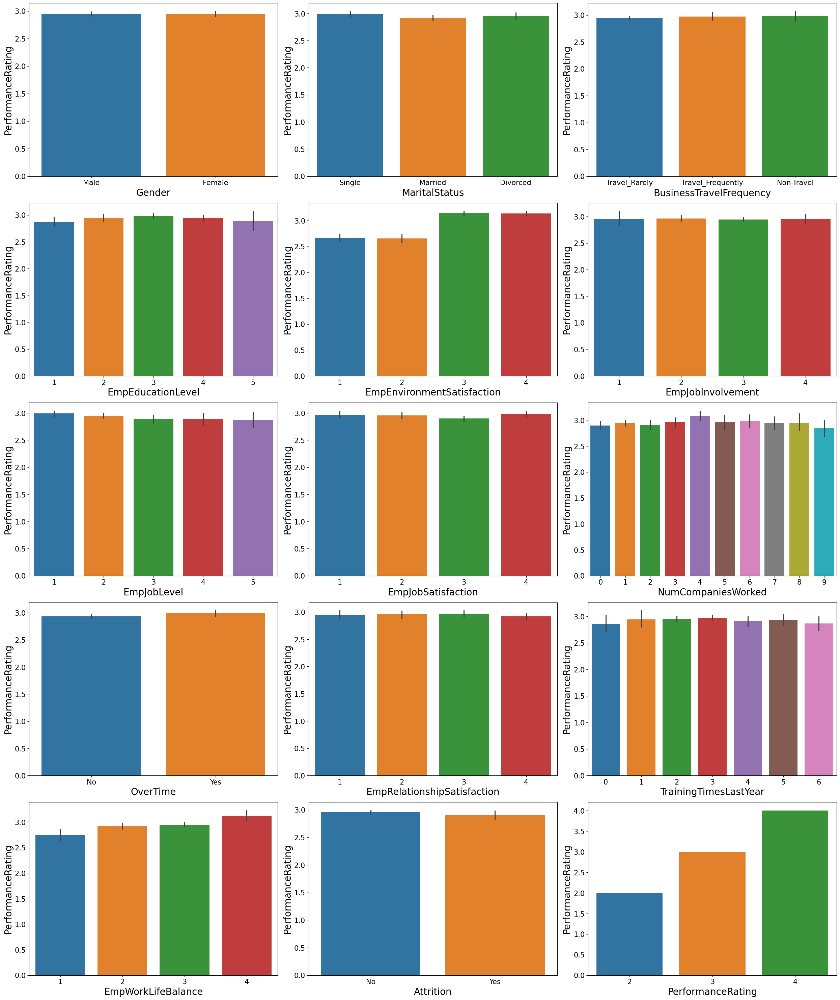

In [48]:
# List of categorical columns
cat_num = ['Gender','MaritalStatus','BusinessTravelFrequency','EmpEducationLevel','EmpEnvironmentSatisfaction','EmpJobInvolvement',
           'EmpJobLevel','EmpJobSatisfaction','NumCompaniesWorked','OverTime','EmpRelationshipSatisfaction','TrainingTimesLastYear',
           'EmpWorkLifeBalance','Attrition','PerformanceRating']

plt.figure(figsize=(25,35))  # Set figure size
num = 1  # Subplot counter

for column in cat_num:
    if num<=len(cat_num):
        plt.subplot(6, 3, num)  # Arrange subplots in a 6-row, 3-column grid
        sns.barplot(x = data[column], y = data['PerformanceRating'], palette="tab10", estimator=np.mean)   # Bar plot
        plt.xlabel(column,fontsize=20)  # Set x-axis label with proper font size
        plt.ylabel('PerformanceRating',fontsize=20)  # Set y-axis label with proper font size
        plt.xticks(fontsize=15)  # Adjust x-axis tick size for better readability
        plt.yticks(fontsize=15)  # Adjust y-axis tick size
    num+=1  # Increment counter only if subplot is created

plt.tight_layout()  # Adjust subplot layout to prevent overlapping
plt.show()  # Display the plots

### **Insights From Performance Barplot :-**  

1. **Gender vs. Performance Rating**
    - **Observation:** Performance ratings are nearly the same for **male and female** employees.
    - **Insight:** **Gender does not significantly influence performance ratings.**
    - **Actionable Recommendation:** No need for gender-based interventions in performance assessments.
---
2. **Marital Status vs. Performance Rating**
    - **Observation:** Performance ratings are slightly higher for **divorced employees** compared to single or married employees.
    - **Insight:** Possible that divorced employees are **more focused on work** or **have fewer distractions outside of work.** However, the difference is minor.
    - **Recommendation:** **No immediate action needed, but further research could explore** why divorced employees perform slightly better.
---
3. **Business Travel Frequency vs. Performance Rating**
    - **Observation:** Employees who **travel frequently tend to have slightly higher performance ratings** than those who rarely travel or do not travel at all.
    - **Insight:** Travel may be associated with **higher job responsibility** or **career advancement.**
    - **Recommendation:** Further investigation can determine **if frequent travel is an enabler or a burden** for employees.
---
4. **Education Level vs. Performance Rating**
    - **Observation:** Employees with **higher education levels (4 & 5) tend to have slightly lower performance ratings** than those with lower education levels.
    - **Insight:** Higher education **does not necessarily translate to better performance.** Skills, experience, and company-specific training may be **more critical.**
    - **Recommendation:** **Focus on skills & experience rather than just education level** in hiring and promotions.
---
5. **Employee Environment Satisfaction vs. Performance Rating**
    - **Observation:** Employees with **higher environment satisfaction (3 & 4) tend to have slightly better performance ratings.**
    - **Insight:** A **positive work environment enhances performance.**
    - **Recommendation:** **Improve workplace conditions** to enhance productivity.
---
6. **Employee Job Involvement vs. Performance Rating**
    - **Observation:** Job involvement **does not show significant variation** in performance ratings.
    - **Insight:** Employee involvement may not directly **translate to higher performance.**
    - **Recommendation:** Focus on **engagement strategies** that drive productivity.
---
7. **Number of Companies Worked vs. Performance Rating**
    - **Observation:** Employees who worked at **more companies (higher job mobility)** have **similar performance ratings** as those with fewer job changes.
    - **Insight:** **Switching jobs does not negatively impact performance.**
    - **Recommendation:** Retention strategies should **focus on career growth rather than penalizing job hoppers.**
---
8. **Training Times Last Year vs. Performance Rating**
    - **Observation:** Performance ratings **do not show a strong link** to the number of training sessions attended.
    - **Insight:** Training may **not be directly improving performance** or may not be tailored effectively.
    - **Recommendation:** **Reevaluate training programs** to ensure they are impactful.
---
9. **Overtime vs. Performance Rating**
    - **Observation:** Employees who work **overtime tend to have slightly higher performance ratings.**
    - **Insight:** High performers may be **more willing to work extra hours.**
    - **Recommendation:** **Ensure work-life balance** to prevent burnout among high performers.
---
10. **Employee Relationship Satisfaction vs. Performance Rating**
    - **Observation:** Higher **relationship satisfaction (3 & 4) correlates with better performance.**
    - **Insight:** **Good workplace relationships contribute to productivity.**
    - **Recommendation:** **Encourage team bonding & collaboration** initiatives.
---
11. **Work-Life Balance vs. Performance Rating**
    - **Observation:** Employees with **better work-life balance tend to have slightly better performance.**
    - **Insight:** Work-life balance **positively affects performance.**
    - **Recommendation:** **Implement flexible work policies** to enhance productivity.
---
12. **Attrition vs. Performance Rating**
    - **Observation:** Employees who **left the company (Attrition: Yes) had slightly lower performance ratings.**
    - **Insight:** Lower performers are **more likely to leave.**
    - **Recommendation:** **Identify struggling employees early** and provide support to improve retention.
---
13. **Performance Rating Distribution**
    - **Observation:** The majority of employees have a **performance rating of 3 or 4, with very few receiving a rating of 2.**
    - **Insight:** **Performance evaluations may need adjustment** to differentiate employees more effectively.
    - **Recommendation:** **Review performance evaluation criteria** to ensure fair distribution.
---

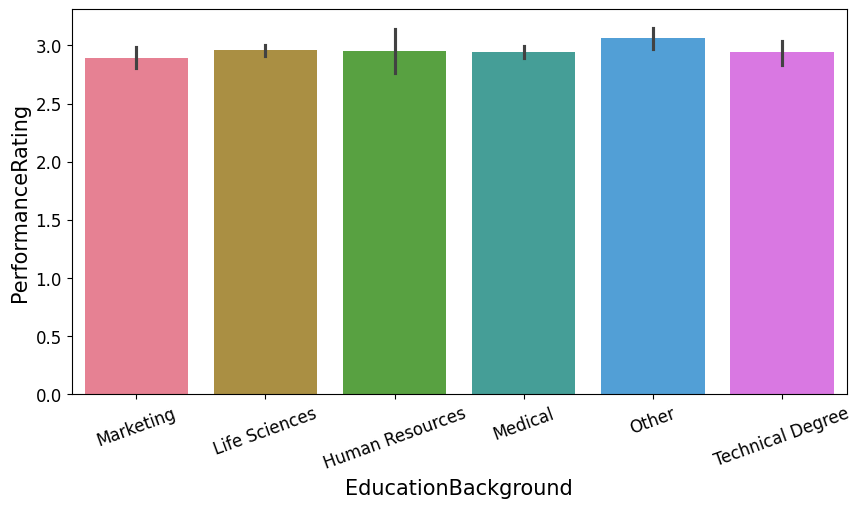

In [50]:
# Bar plot for 'EducationBackground vs PerformanceRating'
plt.figure(figsize=(10,5))  # Set figure size
sns.barplot(x= data['EducationBackground'], y = data['PerformanceRating'], palette="husl")  # Bar plot
plt.xlabel('EducationBackground', fontsize=15)  # Set x-axis label with proper font size
plt.ylabel('PerformanceRating', fontsize=15)  # Set y-axis label with proper font size
plt.xticks(fontsize=12,rotation=20)  # Adjust x-axis tick size and Adjust rotation for better readability
plt.yticks(fontsize=12)  # Adjust y-axis tick size
plt.show()  # Display the plots

### **Insight: Education Background vs. Performance Rating :-**  

- **Observation:**  
  - Employees from **all educational backgrounds** have similar **average performance ratings (~3.0).**  
  - The **Medical** and **Other** categories show slightly **higher performance ratings.**  
  - The **Marketing** category appears to have a slightly **lower** performance rating than the rest.  
  - The **error bars** indicate slight variability, but overall differences are **minor.**  

- **Insight:**  
  - **Educational background does not significantly impact performance ratings.**  
  - Performance is likely **more dependent on experience, skills, and job role** rather than the specific field of education.  


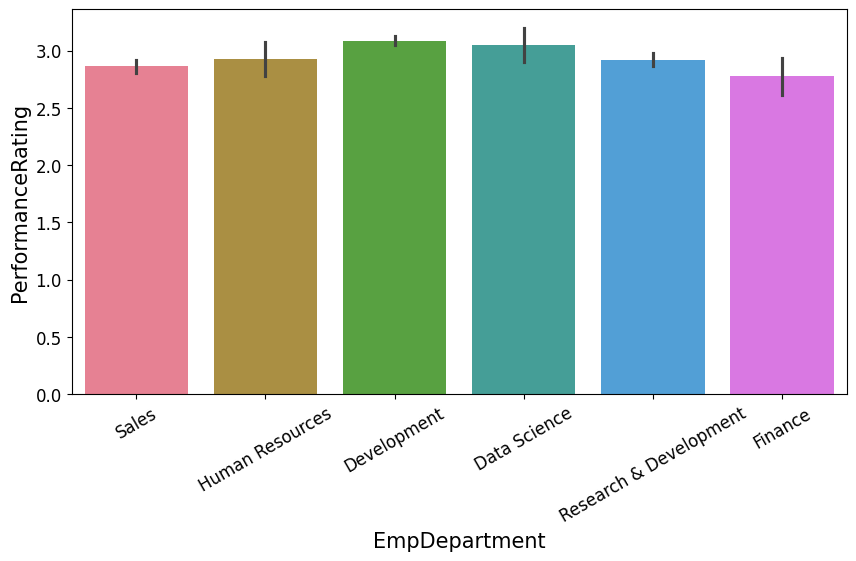

In [52]:
# Bar plot for 'EmpDepartment vs PerformanceRating'
plt.figure(figsize=(10,5))  # Set figure size 
sns.barplot(x= data['EmpDepartment'], y = data['PerformanceRating'], palette="husl")   # Bar Plot
plt.xlabel("EmpDepartment", fontsize=15)  # Set x-axis label with proper font size
plt.ylabel('PerformanceRating', fontsize=15)  # Set y-axis label with proper font size
plt.xticks(fontsize=12,rotation=30)  # Adjust x-axis tick size and Adjust rotation for better readability
plt.yticks(fontsize=12)  # Adjust y-axis tick size
plt.show()  # Display the plots

### **Insight: Employee Department vs. Performance Rating :-**  

#### **Key Observations:**  
- **Development & Data Science** departments have **slightly higher performance ratings (~3.1).**  
- **Sales & Finance** have **slightly lower ratings (~2.8 - 2.9).**  
- **Human Resources and Research & Development** are in the middle range (~2.9 - 3.0).  
- **Error bars** show small variability, indicating that differences are **not extreme.**  

#### **Insights & Possible Explanations:**  
1. **Technical departments (Development & Data Science) may have clearer performance metrics, leading to slightly higher ratings.**  
2. **Sales & Finance employees may have more subjective performance evaluations, affecting ratings.**  
3. **Human Resources & Research & Development fall in the middle, possibly due to a mix of quantitative and qualitative evaluation criteria.**  

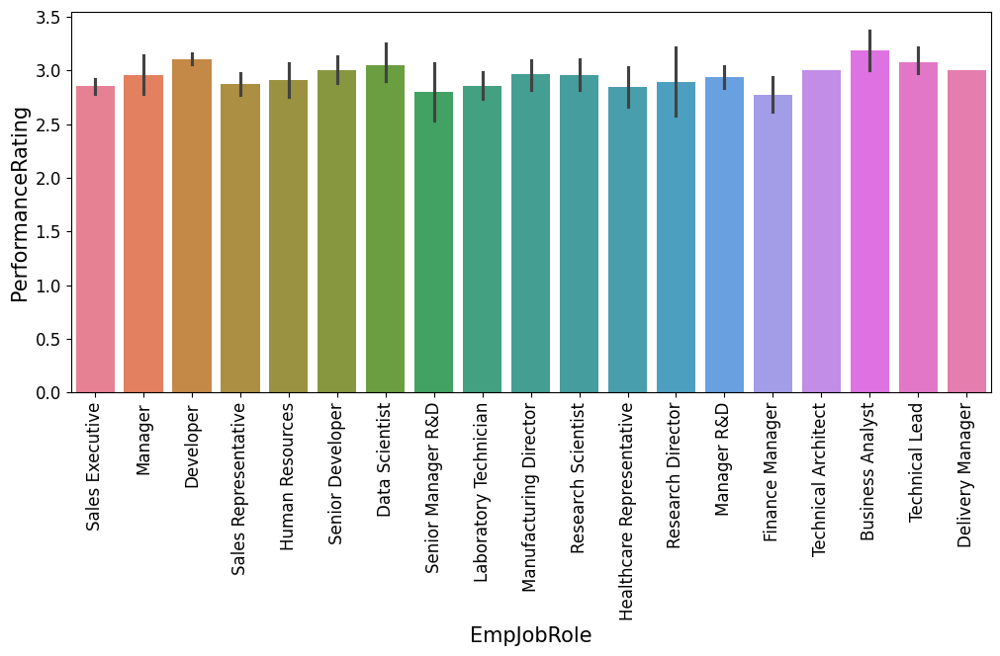

In [54]:
# Bar plot for 'EmpJobRole vs PerformanceRating'
plt.figure(figsize=(12,5))  # Set figure size
sns.barplot(x= data['EmpJobRole'], y = data['PerformanceRating'], palette="husl")   # Bar Plot
plt.xlabel('EmpJobRole', fontsize=15)  # Set x-axis label with proper font size
plt.ylabel('PerformanceRating', fontsize=15)  # Set y-axis label with proper font size
plt.xticks(fontsize=12,rotation=90)  # Adjust x-axis tick size and Adjust rotation for better readability
plt.yticks(fontsize=12)  # Adjust y-axis tick size
plt.show()  # Display the plots

### **Insight: Employee Job Role vs. Performance Rating :-**  

#### **Key Observations:**  
- Business Analyst and Technical Lead have the highest performance ratings (~3.2 - 3.3)   
- Sales Executive, Finance Manager, and Research Director have slightly lower ratings (~2.8 - 2.9)   
- Most technical and managerial roles (Developer, Data Scientist, Senior Developer, Manager R&D) hover around 3.0   
- There is variability in ratings across job roles, but overall, differences are not extreme   

#### **Insights & Possible Explanations:**  
1. Technical & analytical roles (e.g., Business Analyst, Technical Lead) might have clearer KPIs, leading to better ratings   
2. Sales and Finance roles may have subjective performance evaluations or more external dependencies, leading to slightly lower ratings   
3. Managers across different departments have relatively stable performance ratings (~3.0), indicating consistent expectations for leadership roles   

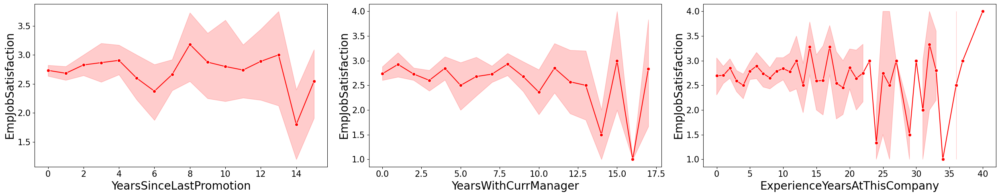

In [56]:
# List of numerical columns to plot against 'EmpJobSatisfaction'
line_p = ['YearsSinceLastPromotion','YearsWithCurrManager','ExperienceYearsAtThisCompany']

plt.figure(figsize=(25,5))  # Set figure size
num = 1  # Subplot counter

for column in line_p:
    if num<=len(line_p):
        plt.subplot(1, 3, num)  # Arrange subplots in a 1-row, 3-column grid
        sns.lineplot(x = data[column], y = data['EmpJobSatisfaction'], color = 'red', marker='o')  # Line plot with red color and markers
        plt.xlabel(column,fontsize=20)  # Set x-axis label with proper font size
        plt.ylabel('EmpJobSatisfaction',fontsize=20)  # Set y-axis label with proper font size
        plt.xticks(fontsize=15)  # Adjust x-axis tick size for better readability
        plt.yticks(fontsize=15)  # Adjust y-axis tick size
    num+=1  # Increment counter only if subplot is created

plt.tight_layout()  # Adjust subplot layout to prevent overlapping
plt.show()  # Display the plots

### **Insight :-**  

#### **1. Years Since Last Promotion vs. EmpJobSatisfaction:**
* **Initial Stability:** Job satisfaction is relatively stable in the first few years after a promotion.
* **Mid-Term Decline:** There's a noticeable dip in satisfaction between approximately 4 and 10 years after the last promotion. This could indicate stagnation or a feeling of being overlooked for advancement.
* **Sharp Decline After 12 Years:** A dramatic drop in job satisfaction occurs beyond 12 years since the last promotion. This is a significant red flag. Employees who haven't been promoted in over a decade may feel undervalued and disengaged.

#### **Potential Implications:**
* **Promotion Frequency:** Organizations might want to review their promotion policies to ensure employees have opportunities for advancement more frequently than every 10-12 years.
* **Career Development:** Focus on career development conversations and opportunities for employees who haven't been promoted in a while.
---
#### **2. Years With Current Manager vs. EmpJobSatisfaction:**

* **Initial Stability:** Similar to the previous plot, job satisfaction is relatively stable in the initial years with a manager.
* **Mid-Term Fluctuation:** There's some fluctuation in satisfaction between 5 and 15 years, but it's not as pronounced as the decline in the "Years Since Last Promotion" plot.
* **Sharp Decline After 15 Years:** A significant drop in satisfaction occurs after 15 years with the same manager. This could indicate burnout, a lack of new challenges, or a strained relationship.

#### **Potential Implications:**
* **Manager Rotation:** Organizations might consider rotating managers or providing opportunities for employees to work with different leaders to prevent stagnation.
* **Manager Training:** Managers should be equipped to keep long-term employees engaged and motivated.
---
#### **3. Experience Years at This Company vs. EmpJobSatisfaction:**
* **High Variability:** Job satisfaction shows the most variability in this plot. There are many peaks and valleys, suggesting a more complex relationship between tenure and satisfaction.
* **No Clear Trend:** There's no clear linear trend or pattern. Satisfaction fluctuates significantly throughout an employee's time with the company.
* **Potential "Honeymoon" Phase:** There might be a slight "honeymoon" phase in the first few years (though not strongly evident).

#### **Potential Implications:**
* **Segmented Analysis:** This plot suggests that job satisfaction might be influenced by factors other than just tenure. Organizations might need to segment employees based on other demographics or roles to understand the drivers of satisfaction at different tenure levels.
* **Ongoing Engagement:** Focus on continuous engagement efforts to maintain satisfaction throughout an employee's journey.

---
## 3) Multivariate Analysis

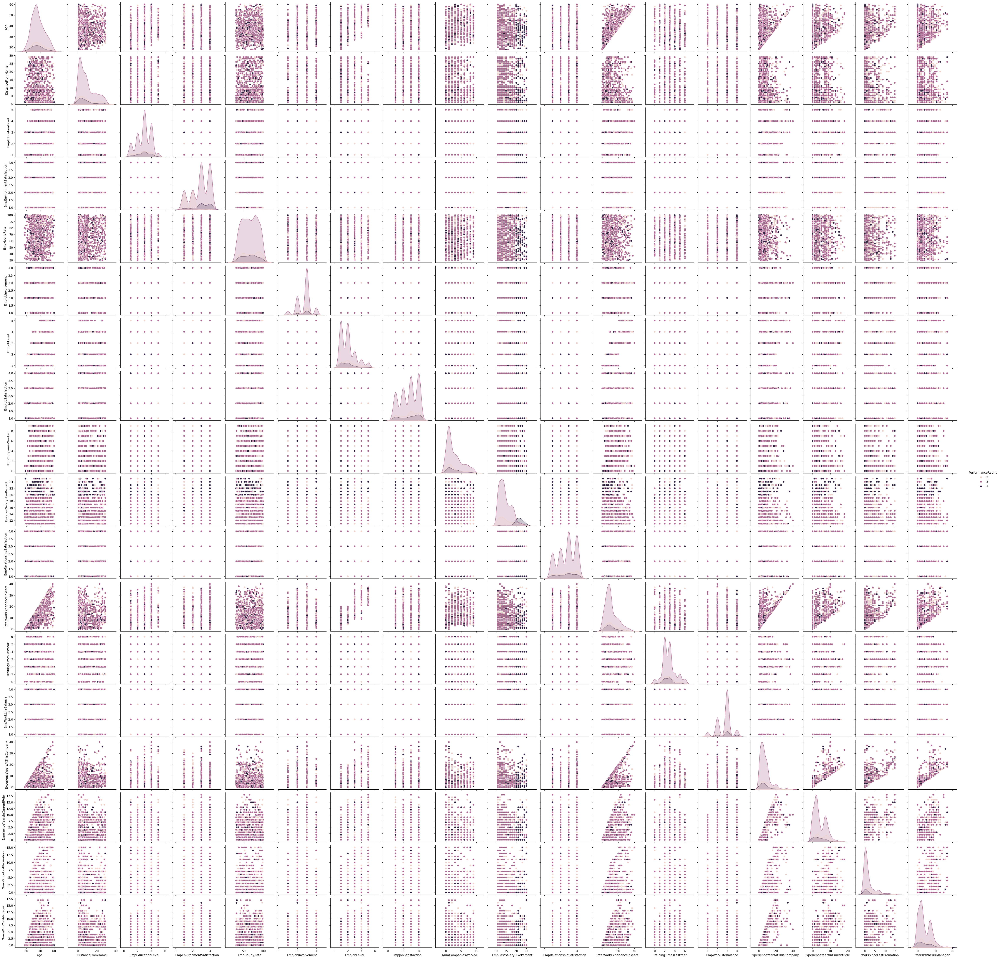

In [60]:
# Create pairplot to visualize relationships between numerical variables
# The 'hue' parameter differentiates data points based on 'PerformanceRating'
sns.pairplot(data, hue = "PerformanceRating", height=2.5)  # Adjust height for better readability
plt.show()  # Display the plots

### **Understanding the Pair Plot:**

* **Matrix Structure:** The plot is a grid (matrix) of smaller plots.
* **Diagonal Plots:** The plots along the diagonal (running from the top left to the bottom right) show the **distribution** of each individual variable in your dataset.  These are typically histograms or kernel density estimates (KDEs).
* **Off-Diagonal Plots:** The plots outside the diagonal are **scatter plots**.  Each scatter plot represents the relationship between two variables.
* **Color Coding (Hue):** The `hue="PerformanceRating"` argument means that the points in the scatter plots and the bars in the histograms are colored according to the "PerformanceRating" of each data point. This allows you to visually see if there are any patterns or trends related to performance.

**Insights You Can Gain:**

1. **Relationships Between Variables:**
   * **Correlation:** You can visually assess the correlation between pairs of variables. Are there any strong linear relationships? Do you see clusters or patterns?  For example, do higher values of one variable tend to correspond with higher values of another?
   * **Non-Linear Relationships:** You can also spot non-linear relationships.  Are there curved patterns or other non-straight-line trends?
   * **Outliers:** You can identify outliers (data points that are far away from the rest) in the scatter plots.

2. **Impact of Performance Rating:**
   * **Separation of Clusters:** The color coding helps you see if the "PerformanceRating" variable separates the data into distinct clusters in the scatter plots. If the points with different performance ratings are well separated, it suggests that performance rating is strongly related to the relationship between those two variables.
   * **Distribution Differences:** By comparing the histograms/KDEs on the diagonal, you can see if the distribution of any single variable differs significantly across different performance ratings.

3. **Feature Importance (Indirectly):**
   * **Variables Correlated with Performance:** If you see that the color coding (performance rating) is strongly associated with the patterns in a particular scatter plot, it suggests that the corresponding variables are potentially important predictors of performance.

---
# **Feature Engineering:**
---

* mFeature engineering is the process of using domain knowledge to select, modify, or create new features (variables) from raw data that make machine learning models more effective.
* Create new features from existing ones to improve the model’s performance.

## 1) Data Preprocessing

* <b>**Data Preprocessing :** </b> It is  cleaning, transforming, and organizing the data into a suitable structure.

## Finding Missing Values

<b><u>**Handling Missing Value :** </u></b> Missing or incomplete data can distort statistical analyses and models.

### Imputation Methods

- We can impute missing value by the help of __Measure of Central Tendency__.
- 1. Mean   2. Median   3. Mode
- We can use __Mean__ when we our distribution is following normal distribution.
- We can use __Median__ when our distribution is skewed or not following normal distribution.
- We can use  __Mode__ when our distribution value or element has categorical data or discrete data.


In [64]:
data.isnull().sum()    # Check for missing values in the dataset

EmpNumber                       0
Age                             0
Gender                          0
EducationBackground             0
MaritalStatus                   0
EmpDepartment                   0
EmpJobRole                      0
BusinessTravelFrequency         0
DistanceFromHome                0
EmpEducationLevel               0
EmpEnvironmentSatisfaction      0
EmpHourlyRate                   0
EmpJobInvolvement               0
EmpJobLevel                     0
EmpJobSatisfaction              0
NumCompaniesWorked              0
OverTime                        0
EmpLastSalaryHikePercent        0
EmpRelationshipSatisfaction     0
TotalWorkExperienceInYears      0
TrainingTimesLastYear           0
EmpWorkLifeBalance              0
ExperienceYearsAtThisCompany    0
ExperienceYearsInCurrentRole    0
YearsSinceLastPromotion         0
YearsWithCurrManager            0
Attrition                       0
PerformanceRating               0
dtype: int64

## Finding Duplicated Data

In [65]:
data.duplicated().sum()    # Check for duplicate records

0

## Checking The Outlier

- An outlier is a single data point that goes far outside the average value of a group of statistics.
- There are Two ways to identify outliers:
1. Data visualization method
2. Interquartile range method

__Using visualizations__

- You can use software to visualize your data with a box plot, or a box-and-whisker plot, so you can see the data distribution at a glance. This type of chart highlights minimum and maximum values (the range), the median, and the interquartile range for your data.

- Many computer programs highlight an outlier on a chart with an asterisk, and these will lie outside the bounds of the graph.

__Using the interquartile range__
- The interquartile range (IQR) tells you the range of the middle half of your dataset. You can use the IQR to create “fences” around your data and then define outliers as any values that fall outside those fences.
#### Interquartile range method

- Sort your data from low to high
- Identify the first quartile (Q1), the median, and the third quartile (Q3).
- Calculate your IQR = Q3 – Q1
- Calculate your upper fence = Q3 + (1.5 * IQR)
- Calculate your lower fence = Q1 – (1.5 * IQR)
- Use your fences to highlight any outliers, all values that fall outside your fences.
- Your outliers are any values greater than your upper fence or less than your lower fence.


* __We will handling the outliers only for Countinous features.__

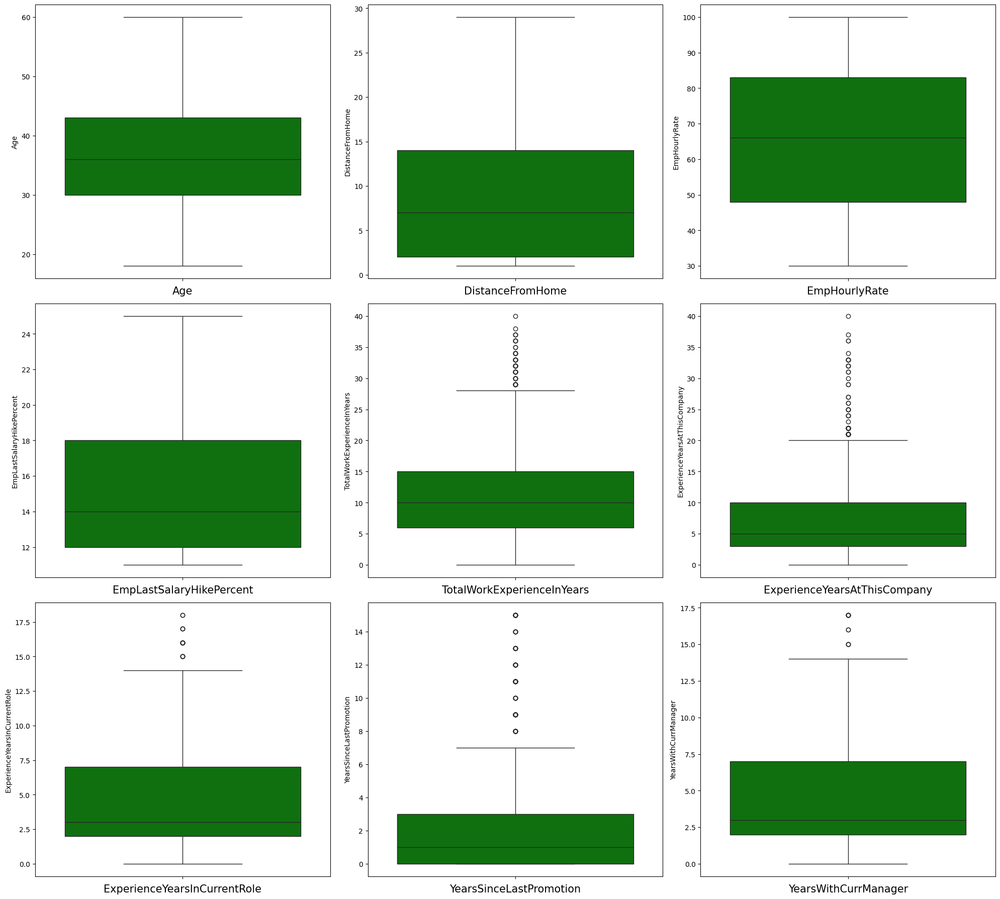

In [68]:
# Define continuous numerical columns for visualization
countinue_col = ["Age","DistanceFromHome","EmpHourlyRate","EmpLastSalaryHikePercent","TotalWorkExperienceInYears",
                 "ExperienceYearsAtThisCompany","ExperienceYearsInCurrentRole","YearsSinceLastPromotion","YearsWithCurrManager"]

plt.figure(figsize=(20,18))  # Set figure size
num = 1  # Subplot counter

for column in countinue_col:
    if num<=len(countinue_col):
        plt.subplot(3,3,num)  # Arrange subplots in a 3-row, 3-column grid
        sns.boxplot(data[column], color='green')  # Box Plot to detect outliers
        plt.xlabel(column,fontsize=15)  # Set x-axis label with proper font size
        plt.xticks(fontsize=10)  # Adjust x-axis tick size for better readability
        plt.yticks(fontsize=10)  # Adjust y-axis tick size
    num+=1  # Increment counter only if subplot is created

plt.tight_layout()  # Adjust subplot layout to prevent overlapping
plt.show()  # Display the plots

### **Insights from Box Plots :-**

* **Age:**
    * **Distribution:** Roughly symmetrical, suggesting a relatively even distribution of ages.
    * **Median:** Around 35 (estimated).
    * **Range:** Approximately 18 to 60.
* **DistanceFromHome:**
    * **Distribution:** Right-skewed, indicating that most employees live relatively close to work, but some live much farther away.
    * **Median:** Around 8 (estimated).
    * **Range:** 0 to 30.
* **EmpHourlyRate:**
    * **Distribution:** Relatively uniform, with a wide range of hourly rates.
    * **Median:** Around 65 (estimated).
    * **Range:** 30 to 100.
* **EmpLastSalaryHikePercent:**
    * **Distribution:** Right-skewed, meaning most employees received relatively small salary hikes, but some received larger hikes.
    * **Median:** Around 14 (estimated).
    * **Outliers:** Several employees received significantly larger salary hikes.
* **TotalWorkExperienceInYears:**
    * **Distribution:** Right-skewed, indicating that most employees have relatively little work experience, but some have a lot.
    * **Median:** Around 10 (estimated).
    * **Outliers:** Some employees have significantly more work experience.
* **ExperienceYearsAtThisCompany:**
    * **Distribution:** Right-skewed, suggesting that most employees are relatively new to the company, but some have been there for a long time.
    * **Median:** Around 5 (estimated).
    * **Outliers:** Some employees have much longer tenure.
* **ExperienceYearsInCurrentRole:**
    * **Distribution:** Right-skewed, indicating that most employees have been in their current role for a relatively short time.
    * **Median:** Around 3 (estimated).
    * **Outliers:** Some employees have been in their roles for a much longer time.
* **YearsSinceLastPromotion:**
    * **Distribution:** Right-skewed, meaning most employees were promoted relatively recently, but some haven't been promoted in a long time.
    * **Median:** Around 2 (estimated).
    * **Outliers:** Some employees haven't been promoted in a decade or more.
* **YearsWithCurrManager:**
    * **Distribution:** Right-skewed, indicating that most employees have been with their current manager for a relatively short time.
    * **Median:** Around 3 (estimated).
    * **Outliers:** Some employees have been with their managers for a long time.

In [70]:
np.median(data.TotalWorkExperienceInYears)    # Handling outliers in 'TotalWorkExperienceInYears'

10.0

In [71]:
# Replace values greater than 28 with 10.0 to reduce the effect of extreme outliers
data.loc[data['TotalWorkExperienceInYears']>28, "TotalWorkExperienceInYears"] = 10.0

In [72]:
np.median(data.ExperienceYearsAtThisCompany)    # Handling outliers in 'ExperienceYearsAtThisCompany'

5.0

In [73]:
# Replace values greater than 20 with 5.0 to reduce extreme outliers
data.loc[data['ExperienceYearsAtThisCompany']>20, "ExperienceYearsAtThisCompany"] = 5.0

## Converting Categoricall Data To Numerical 

### Categorical Feature Encoding
* To convert categorical features into numerical values, both One-Hot Encoding and Label Encoding were performed:

<b><u> Encoding Categorical Variables :</u></b> Categorical variables need to be transformed into numerical formats for machine learning models.
 * Label Encoding
 * One-Hot Encoding
 * Ordinal Encoding

<b>  Label Encoding:
* For some features, Label Encoding was applied, which assigns each category an integer label. This is useful when the categorical data has an inherent order.

<b> One-Hot Encoding: 
* Categorical features were encoded using the pandas get_dummies() method, which creates binary columns for each category of the categorical variable. This approach allows the model to understand the categorical data by representing it numerically.

<b> Ordinal Encoding: 
* We use Ordinal enocder for that data which follow orders. It convert data in order form where we assign order.

#### **Basically we will apply these technique in these following features >>>>**

#### **Label Encoder :-**

1. Gender
2. EducationBackground
3. MaritalStatus
4. EmpDepartment
5. EmpJobRole
6. BusinessTravelFrequency
7. OverTime
8. Attrition

In these 8 features we will apply label encoder


In [74]:
# List of categorical variables that need to be encoded
Categorical = ['Gender','EducationBackground','MaritalStatus','EmpDepartment','EmpJobRole','BusinessTravelFrequency','OverTime','Attrition']

In [75]:
# Label encoding will be applied to categorical columns to convert them into machine-readable numerical format
from sklearn.preprocessing import LabelEncoder  # For encoding categorical variables
# Initialize LabelEncoder to convert categorical features into numerical values
le = LabelEncoder()

# Apply Label Encoding to categorical columns
for column in Categorical:
    data[column] = le.fit_transform(data[column])

## Scaling The Continous Variable

<u><b> Scalling :</u></b> Scaling is very important of continous features because some model give more priproty to that features which has higest values campare to another features. that's why we use Scaling to make all values into certain ranges.scaling technique can significantly improve the efficiency and accuracy of your model.It help improve the performance and accuracy of machine learning models.

* It is technique to convert all data into certain range.<br><br>
* <b>The types of scalling are : </b><br> 
     <b>1) Min-Max Scaling :</b> Min-Max scaling transforms the data to a specific range, usually between 0 and 1. The values are rescaled according to the minimum and maximum values of the feature.<br>
     <b>2) Standardization : </b>- Standardization Scaling transform all data between -3 to +3 range. it use z-score to tranform data.

**We know that we have 4 features which is in continous nature where we will apply MinMax Scaling.**

1. DistanceFromHome
2. EmpHourlyRate
3. EmpLastSalaryHikePercent
4. YearsSinceLastPromotion

**We know that we have 7 features which is in continous nature where we will apply Standardization Scaling.**

1. Age
2. NumCompaniesWorked
3. TotalWorkExperienceInYears
4. TrainingTimesLastYear
5. ExperienceYearsAtThisCompany
6. ExperienceYearsInCurrentRole
7. YearsWithCurrManager

In [76]:
# StandardScaler is used to scale features by removing the mean and scaling to unit variance
# MinMaxScaler scales the features to a fixed range (usually 0 to 1)
from sklearn.preprocessing import StandardScaler, MinMaxScaler  # For feature scaling

# Define columns for different scaling techniques
MMS_col = ['DistanceFromHome','EmpHourlyRate','EmpLastSalaryHikePercent','YearsSinceLastPromotion']
STD_col = ['Age','NumCompaniesWorked','TotalWorkExperienceInYears','TrainingTimesLastYear','ExperienceYearsAtThisCompany',
           'ExperienceYearsInCurrentRole','YearsWithCurrManager']

In [77]:
# Initialize Standard Scaler and MinMax Scaler
std_s = StandardScaler()  # Standard scaling for normalizing numerical columns
mm_s = MinMaxScaler()  # Min-Max scaling for certain features

# Apply transformations
data[STD_col] = std_s.fit_transform(data[STD_col])  # Standard scaling
data[MMS_col] = mm_s.fit_transform(data[MMS_col])  # Min-Max scaling

## Transformation

- Now let see is there any features which is not following normal distribution. if there are any features which is not following nornal distribution then we will apply Transformation.

- There are some type of Transformation >>>>

1. Logarithmic Transformation
2. reciprol Transformation
3. Box Cox Transformation
4. Square Root Transformation
5. Yeo-Johnson transformation
    * Yeo-Johnson transformation is used to normalize data by making it more Gaussian-like
    * It handles both positive and negative values, unlike log transformation

**We know that we have 8 features which is in continous nature where we will apply transformation**

1. DistanceFromHome
2. EmpHourlyRate
3. EmpLastSalaryHikePercent
4. TotalWorkExperienceInYears
5. ExperienceYearsAtThisCompany
6. ExperienceYearsInCurrentRole
7. YearsSinceLastPromotion
8. YearsWithCurrManager

In [78]:
# Define columns for transformation visualization
Transform_col = ["DistanceFromHome","EmpHourlyRate","EmpLastSalaryHikePercent","TotalWorkExperienceInYears",
                 "ExperienceYearsAtThisCompany","ExperienceYearsInCurrentRole","YearsSinceLastPromotion","YearsWithCurrManager"]

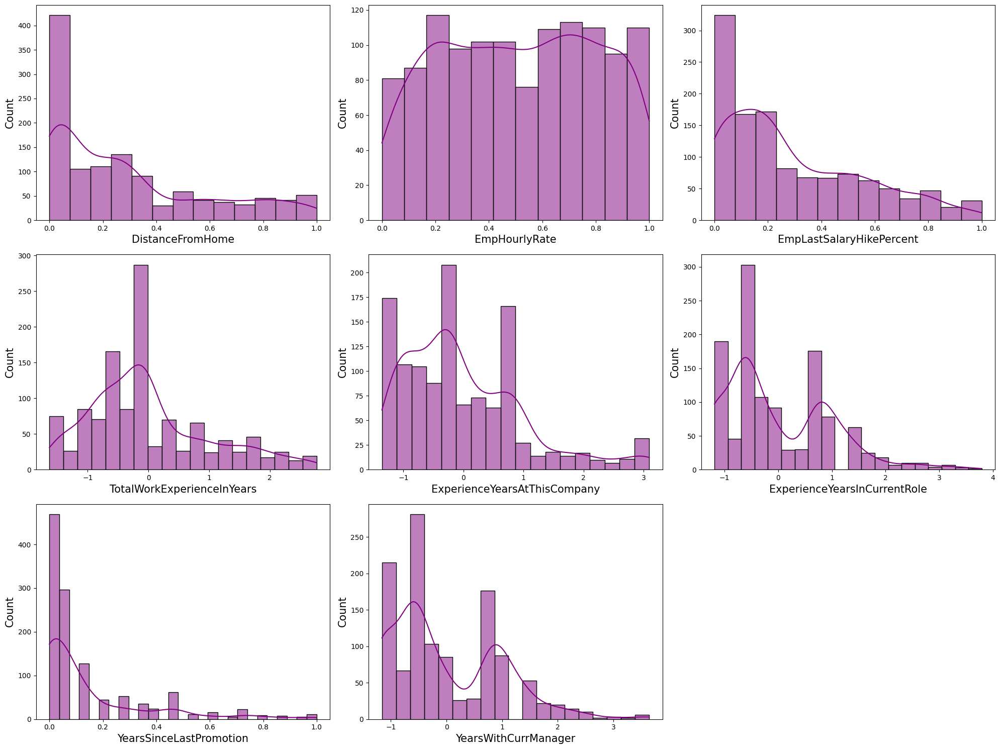

In [79]:
# Histogram visualization of transformed numerical columns
plt.figure(figsize=(20,15))  # Set figure size
num = 1  # Subplot counter

for column in Transform_col:
    if num<=len(Transform_col):
        plt.subplot(3,3,num)  # Arrange subplots in a 3-row, 3-column grid
        sns.histplot(data[column], kde=True, color='purple')    # Histogram with KDE overlay
        plt.xlabel(column,fontsize=15)  # Set x-axis label with proper font size
        plt.ylabel('Count',fontsize=15)  # Set y-axis label with proper font size
        plt.xticks(fontsize=10)  # Adjust x-axis tick size for better readability
        plt.yticks(fontsize=10)  # Adjust y-axis tick size
    num+=1  # Increment counter only if subplot is created

plt.tight_layout()  # Adjust subplot layout to prevent overlapping
plt.show()  # Display the plots

In [80]:
from scipy.stats import yeojohnson  # For data transformation (normalization)

In [81]:
# Apply Yeo-Johnson transformation to normalize skewed features
for column in Transform_col:
    # Yeo-Johnson transformation is used to normalize data by making it more Gaussian-like
    # It handles both positive and negative values, unlike log transformation
    # Apply Yeo-Johnson transformation
    transformed_column, lambda_val = yeojohnson(data[column])  # Apply transformation
    data[column] = transformed_column  # Store transformed values

    # Alternative transformations (commented out)
    # data[column] = np.sqrt(data[column])  # Square root transformation
    # data[column] = np.log1p(data[column])  # Log transformation (handling zero values)
    # data[column] = np.log(data[column] + 1) # Log transformation here we are adding 1 to avoding 0

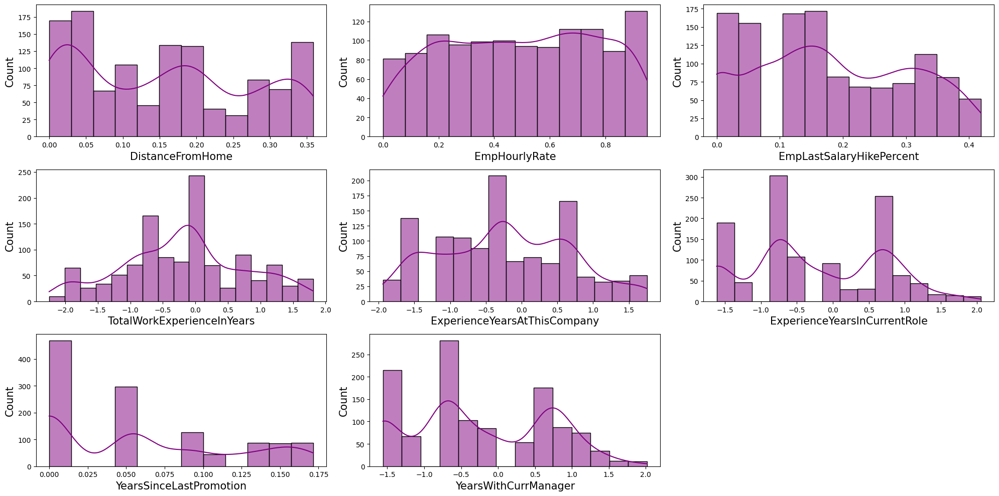

In [82]:
plt.figure(figsize=(20,10))  # Set figure size
num = 1  # Subplot counter

for column in Transform_col:
    if num<=len(Transform_col):
        plt.subplot(3,3,num)  # Arrange subplots in a 3-row, 3-column grid
        sns.histplot(data[column], kde=True, color='purple')    # Histogram with KDE overlay
        plt.xlabel(column,fontsize=15)  # Set x-axis label with proper font size
        plt.ylabel('Count',fontsize=15)  # Set y-axis label with proper font size
        plt.xticks(fontsize=10)  # Adjust x-axis tick size for better readability
        plt.yticks(fontsize=10)  # Adjust y-axis tick size
    num+=1  # Increment counter only if subplot is created

plt.tight_layout()  # Adjust subplot layout to prevent overlapping
plt.show()  # Display the plots

## 2) Feature selection

In [90]:
# Compute correlation matrix excluding 'EmpNumber' column
data.drop('EmpNumber', axis=1).corr()

,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating
Age,1.000000,-0.040107,-0.055905,-0.098368,-0.000104,-0.037665,0.040579,0.002026,0.207313,0.013814,0.062977,0.027216,0.509139,-0.002436,0.284408,0.051910,-0.004138,0.049749,0.575171,-0.016053,-0.019563,0.179879,0.204536,0.199310,0.192987,-0.189317,-0.040164
Gender,-0.040107,1.000000,0.009922,-0.042169,-0.010925,0.011332,-0.043608,0.008923,-0.022960,0.000033,0.002677,0.010949,-0.050685,0.024680,-0.036675,-0.038410,0.001371,0.030707,-0.057650,-0.057654,0.015793,-0.050237,-0.028575,-0.025032,-0.035085,0.035758,-0.001780
EducationBackground,-0.055905,0.009922,1.000000,-0.001097,-0.026874,-0.012325,0.012382,-0.012147,-0.047978,0.045028,-0.030280,-0.025505,-0.056338,-0.030977,-0.032879,0.007046,-0.004739,0.005652,-0.020788,0.051596,0.022890,0.018246,0.005164,0.016757,0.010211,0.027161,0.005607
MaritalStatus,-0.098368,-0.042169,-0.001097,1.000000,0.067272,0.038023,0.028520,-0.025944,0.026737,-0.032467,-0.013893,-0.043355,-0.087359,0.044593,-0.030095,-0.022833,0.011984,0.026410,-0.103232,0.026045,0.014154,-0.066453,-0.069324,-0.035643,-0.071808,0.162969,0.024172
EmpDepartment,-0.000104,-0.010925,-0.026874,0.067272,1.000000,0.568973,-0.045233,0.009723,0.019175,-0.019237,0.003712,-0.076988,0.100526,0.007150,-0.033950,-0.026841,-0.013681,-0.050286,0.016500,0.016438,0.068875,0.071177,0.075517,0.044161,0.036312,0.048006,-0.162615
EmpJobRole,-0.037665,0.011332,-0.012325,0.038023,0.568973,1.000000,-0.086251,0.019958,-0.016792,0.044612,-0.016043,-0.008034,0.004406,0.032916,-0.009111,0.015075,0.003157,-0.043067,-0.026018,0.004452,-0.007519,0.035812,0.023268,0.022476,0.009019,0.037508,-0.096209
BusinessTravelFrequency,0.040579,-0.043608,0.012382,0.028520,-0.045233,-0.086251,1.000000,-0.013426,0.002064,0.012267,0.025166,0.016652,0.036360,-0.031236,0.021476,0.032229,-0.047649,-0.032705,0.031303,0.006720,-0.040969,-0.016014,-0.011367,-0.008965,-0.027700,0.007217,-0.031025
DistanceFromHome,0.002026,0.008923,-0.012147,-0.025944,0.009723,0.019958,-0.013426,1.000000,0.044465,-0.006822,-0.000488,0.023759,0.006428,-0.012167,-0.024667,0.035179,0.034798,-0.005420,0.024743,-0.014995,-0.039713,0.042343,0.022436,0.012498,0.016848,0.060385,-0.041413
EmpEducationLevel,0.207313,-0.022960,-0.047978,0.026737,0.019175,-0.016792,0.002064,0.044465,1.000000,-0.037103,0.014497,0.027544,0.100734,0.000357,0.128674,-0.021119,0.009295,-0.016690,0.149520,-0.013674,0.010276,0.070857,0.068389,0.042813,0.079021,-0.049118,0.020529
EmpEnvironmentSatisfaction,0.013814,0.000033,0.045028,-0.032467,-0.019237,0.044612,0.012267,-0.006822,-0.037103,1.000000,-0.049763,0.004865,-0.008272,-0.004319,0.017270,0.064270,-0.048924,-0.010504,-0.040251,0.001192,-0.000262,0.013920,0.029174,0.016766,-0.006784,-0.123490,0.395561


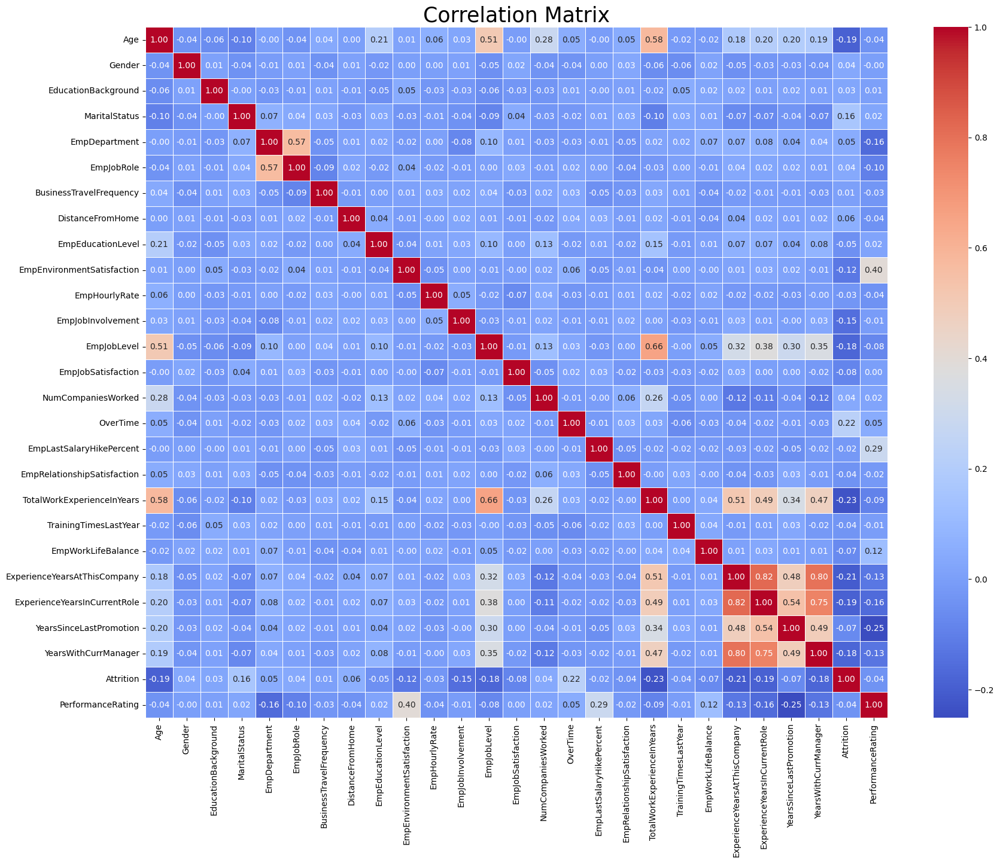

In [91]:
# Plot heatmap of correlation matrix
plt.figure(figsize=(20,15))  # Set figure size
sns.heatmap(data.drop('EmpNumber', axis=1).corr(), annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)  # Heatmap with annotations
plt.title('Correlation Matrix', fontsize = 25)  # Set title
plt.show()  # Display heatmap

### **Key Insights from This Correlation Matrix :-**

1. **Strong Positive Correlations:**
    * **ExperienceYearsAtThisCompany & ExperienceYearsInCurrentRole & YearsSinceLastPromotion & YearsWithCurrManager:** These variables are highly positively correlated with each other. This is expected, as employees with longer tenure at the company tend to have more years in their current role, more time since their last promotion, and more years with their current manager.
    * **EmpJobLevel & TotalWorkExperienceinYears:** There's a strong positive correlation, suggesting that employees with higher job levels tend to have more years of overall work experience.
    * **EmpJobLevel & ExperienceYearsAtThisCompany:** A moderate positive correlation, implying that employees with higher job levels have generally been with the company longer.
---
2. **Strong Negative Correlations:**
    * **Attrition & TotalWorkExperienceinYears:** There's a noticeable negative correlation. Employees with more years of experience are less likely to leave the company.
    * **Attrition & ExperienceYearsAtThisCompany:** Similar to the above, employees with longer tenure at the company are less likely to leave.
    * **Attrition & ExperienceYearsInCurrentRole:** Employees who have been in their current role longer are less likely to leave.
    * **Attrition & YearsWithCurrManager:** Employees who have been with their current manager longer are less likely to leave.
---
3. **Weak Correlations:**
    * **Many Variables:** Most of the other variable pairs show weak or no significant correlation. This suggests that these variables are relatively independent or that their relationships are more complex.
---
4. **Other Notable Correlations:**
    * **Age & EmpJobLevel:** There's a moderate positive correlation, indicating older employees tend to have higher job levels.
    * **NumCompaniesWorked & TotalWorkExperienceinYears:** A moderate positive correlation, as expected, since more experienced employees tend to have worked at more companies.
    * **EmpLastSalaryHikePercent & PerformanceRating:** A weak positive correlation, suggesting that higher salary hikes might be associated with slightly better performance ratings.
---

In [97]:
# Drop 'EmpNumber' column as it is likely an identifier and not useful for analysis
data.drop('EmpNumber', axis=1, inplace=True)

---
# **Model Creation:** 
---

## 1) Independent and Dependent Variable Creation
- Spliting data into Train and Test

In [100]:
# Separate the target variable (PerformanceRating) from the features
x = data.drop('PerformanceRating', axis=1)  # Features (independent variables)
y = data.PerformanceRating  # Target variable (dependent variable)

In [206]:
x  # Display features

,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition
0,-0.541458,1,2,2,5,13,2,0.209241,3,4,0.349491,3,2,4,-0.674538,0,0.065315,4,-0.059474,-0.622235,2,0.687556,0.614654,0.000000,0.844384,0
1,1.109888,1,2,2,5,13,2,0.259570,4,4,0.169557,3,2,1,-0.269410,0,0.065315,4,1.140248,-0.622235,3,0.187735,0.614654,0.053972,0.662858,0
2,0.339260,1,1,1,5,13,1,0.115956,4,4,0.253050,2,3,1,0.945974,1,0.360913,3,1.140248,-0.622235,3,1.582397,1.513618,0.053972,1.441561,0
3,0.449349,1,0,0,3,8,2,0.209241,4,2,0.593259,2,5,4,0.135718,0,0.206859,2,1.410093,-0.622235,2,-0.265398,0.413175,0.168864,0.461645,0
4,2.541054,1,2,2,5,13,2,0.279382,4,1,0.739597,3,2,1,2.161359,0,0.166849,4,-0.059474,-1.414051,3,-1.183257,-0.761158,0.089401,-0.704484,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1195,-1.091906,0,3,0,5,13,1,0.064085,1,4,0.566449,4,2,4,-0.674538,1,0.342349,2,-0.806743,0.169581,3,-0.022436,0.184474,0.000000,-0.029949,0
1196,0.008991,1,1,2,1,15,2,0.209241,2,4,0.686595,4,1,4,0.135718,0,0.271659,1,-1.247440,-0.622235,3,-1.547819,-1.614443,0.000000,-1.559306,0
1197,1.440157,1,3,1,1,15,2,0.354718,1,4,0.606639,4,1,3,-0.674538,1,0.000000,3,1.140248,0.169581,3,1.755229,0.795791,0.113243,0.844384,0
1198,-0.321278,0,3,2,0,1,2,0.193806,3,4,0.225307,2,3,2,-0.674538,0,0.166849,2,-0.228149,0.169581,4,0.372146,0.614654,0.155348,0.662858,0


In [208]:
y  # Display target variable

0       3
1       3
2       4
3       3
4       3
       ..
1195    4
1196    3
1197    3
1198    3
1199    2
Name: PerformanceRating, Length: 1200, dtype: int64

## 2) Traning and Testing Data Creation

In [211]:
# Import train_test_split for splitting dataset
from sklearn.model_selection import train_test_split

# Split data into training (75%) and testing (25%) sets
x_train,x_test,y_train,y_test = train_test_split(x, y, test_size=0.25, random_state=1)

In [213]:
x_train  # Display the Training features

,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition
443,1.880516,0,3,0,4,9,1,0.223410,4,2,0.779197,3,4,4,0.135718,0,0.342349,1,1.657256,-0.622235,3,1.186512,0.961048,0.053972,1.441561,0
938,-0.101099,0,3,2,1,3,1,0.296478,1,2,0.593259,3,1,4,-0.674538,0,0.120208,1,-0.409345,-0.622235,3,0.372146,-1.167100,0.053972,0.662858,0
403,0.449349,1,3,1,4,9,2,0.115956,5,2,0.818670,4,1,3,-0.269410,1,0.065315,1,-0.602397,1.753213,2,-0.540859,-0.761158,0.000000,-0.343207,0
349,-0.321278,0,3,2,5,13,2,0.269849,2,3,0.499135,3,2,1,-0.674538,0,0.065315,4,-0.059474,2.545029,4,0.687556,0.795791,0.163026,0.461645,0
418,-0.321278,1,4,2,5,13,2,0.064085,3,4,0.699868,1,2,1,0.135718,0,0.298154,4,0.619043,-0.622235,3,1.073804,0.961048,0.113243,1.441561,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-1.312086,1,4,0,4,7,2,0.033791,1,4,0.376867,3,1,3,1.351102,1,0.321558,3,-0.602397,-0.622235,2,-1.183257,-0.761158,0.000000,-0.704484,0
905,-0.101099,1,3,2,1,18,1,0.064085,2,4,0.000000,3,1,2,0.540846,0,0.065315,3,0.373776,0.169581,2,0.372146,0.614654,0.155348,-0.704484,0
1096,0.449349,1,2,1,5,13,2,0.000000,3,2,0.266889,4,3,1,-0.674538,0,0.241477,3,-0.059474,-0.622235,3,0.687556,0.614654,0.000000,0.662858,0
235,-0.211189,1,2,0,5,13,1,0.223410,2,4,0.335775,3,2,4,-0.674538,0,0.000000,4,-1.021898,0.169581,3,-0.265398,-0.761158,0.000000,-0.704484,0


In [215]:
x_test  # Display the Testing features

,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition
636,-0.871727,1,1,0,4,5,2,0.358813,1,4,0.858020,1,2,3,2.161359,0,0.271659,4,0.096047,0.169581,3,0.187735,-1.614443,0.053972,0.461645,0
683,-1.091906,0,0,1,3,6,1,0.324307,3,1,0.390526,2,1,2,-0.674538,0,0.065315,1,-1.982845,-0.622235,3,-1.547819,-1.614443,0.000000,-1.559306,1
1033,-0.651548,1,2,0,5,13,2,0.158500,3,4,0.593259,3,2,4,0.540846,0,0.065315,4,0.373776,0.169581,3,0.187735,0.614654,0.053972,0.662858,0
190,-0.981817,1,3,1,5,14,2,0.209241,1,4,0.606639,3,1,2,-0.674538,0,0.377568,2,-1.982845,1.753213,3,-1.547819,-1.614443,0.000000,-1.559306,0
1083,0.008991,0,1,0,1,2,2,0.259570,3,4,0.884186,3,1,1,-0.674538,0,0.065315,3,0.944422,-0.622235,2,1.582397,0.614654,0.168864,2.017476,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
599,-0.651548,0,2,1,5,13,2,0.358813,4,1,0.831800,2,2,4,-0.674538,0,0.166849,1,0.373776,0.169581,3,0.953945,0.614654,0.141157,0.662858,0
207,0.119080,0,1,1,4,5,2,0.288237,1,3,0.485621,2,3,3,-1.079667,0,0.298154,1,1.140248,0.961397,2,1.670552,0.961048,0.053972,1.010454,0
826,-0.101099,0,1,1,1,3,2,0.138248,3,2,0.349491,4,1,4,0.135718,0,0.065315,2,-1.021898,0.169581,3,-1.547819,-1.614443,0.000000,-1.559306,0
325,-0.871727,0,5,0,4,7,2,0.158500,3,2,0.127503,3,1,3,0.135718,1,0.120208,1,-0.059474,-0.622235,3,0.187735,0.614654,0.155348,0.662858,1


In [217]:
y_train  # Display the Training Target variable

443     2
938     3
403     3
349     3
418     3
       ..
715     3
905     3
1096    3
235     3
1061    2
Name: PerformanceRating, Length: 900, dtype: int64

In [219]:
y_test   # Display the Testing Target variable

636     3
683     3
1033    3
190     4
1083    3
       ..
599     2
207     3
826     3
325     2
892     3
Name: PerformanceRating, Length: 300, dtype: int64

## Balancing the data

### SMOTE

In [223]:
# Address class imbalance using SMOTE (Synthetic Minority Over-sampling Technique)
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state=63)  # Initialize SMOTE with a fixed random state

# Apply SMOTE only to the training data to generate synthetic samples for the minority class
x_train_smote, y_train_smote = smote.fit_resample(x_train, y_train)

In [224]:
# Display the shape of new training features data after SMOTE
x_train_smote

,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition
0,1.880516,0,3,0,4,9,1,0.223410,4,2,0.779197,3,4,4,0.135718,0,0.342349,1,1.657256,-0.622235,3,1.186512,0.961048,0.053972,1.441561,0
1,-0.101099,0,3,2,1,3,1,0.296478,1,2,0.593259,3,1,4,-0.674538,0,0.120208,1,-0.409345,-0.622235,3,0.372146,-1.167100,0.053972,0.662858,0
2,0.449349,1,3,1,4,9,2,0.115956,5,2,0.818670,4,1,3,-0.269410,1,0.065315,1,-0.602397,1.753213,2,-0.540859,-0.761158,0.000000,-0.343207,0
3,-0.321278,0,3,2,5,13,2,0.269849,2,3,0.499135,3,2,1,-0.674538,0,0.065315,4,-0.059474,2.545029,4,0.687556,0.795791,0.163026,0.461645,0
4,-0.321278,1,4,2,5,13,2,0.064085,3,4,0.699868,1,2,1,0.135718,0,0.298154,4,0.619043,-0.622235,3,1.073804,0.961048,0.113243,1.441561,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1975,-1.530957,1,1,2,4,12,1,0.133262,1,4,0.531671,2,1,2,-0.510561,0,0.382411,1,-1.664404,-0.461990,3,-1.239116,-1.441757,0.000000,-1.559306,0
1976,1.537621,0,3,1,4,8,0,0.033791,2,3,0.025062,2,4,1,0.089255,0,0.347342,2,-0.059474,0.169581,3,-0.878604,-0.517553,0.100021,-0.704484,0
1977,-1.334733,1,2,1,4,7,2,0.315602,3,3,0.259013,2,1,2,2.207328,0,0.375678,3,-0.721951,-0.532389,2,-0.509603,-0.362983,0.047848,-0.750573,0
1978,0.060174,0,1,1,4,11,2,0.185650,3,3,0.195477,3,2,4,-0.862893,0,0.383085,1,0.201583,-0.622235,3,0.833235,0.957482,0.079929,0.560732,0


In [225]:
# Display the shape of new training target variable after SMOTE
y_train_smote

0       2
1       3
2       3
3       3
4       3
       ..
1975    4
1976    4
1977    4
1978    4
1979    4
Name: PerformanceRating, Length: 1980, dtype: int64

In [226]:
# Check class distribution before and after SMOTE using Counter
from collections import Counter

print("Before Apply SMOTE->>>> ",Counter(y_train))  # Display original class distribution
print("After Apply SMOTE->>>> ",Counter(y_train_smote))  # Display balanced class distribution

Before Apply SMOTE->>>>  Counter({3: 660, 2: 143, 4: 97})
After Apply SMOTE->>>>  Counter({2: 660, 3: 660, 4: 660})


## 3) Model Selection

In [232]:
# Import performance evaluation metrics for classification
from sklearn.metrics import  confusion_matrix,accuracy_score,recall_score,precision_score,f1_score,classification_report

### * **Logistic Regression**

In [235]:
# Import Logistic Regression Model
from sklearn.linear_model import LogisticRegression

# Initialize and train Logistic Regression model
lr = LogisticRegression()
lr.fit(x_train_smote,y_train_smote)

LogisticRegression()

In [237]:
# Predict on test data
y_pred1 = lr.predict(x_test)
y_pred1  # Display test predictions

array([4, 2, 3, 4, 3, 4, 2, 3, 4, 3, 4, 3, 3, 2, 4, 3, 4, 3, 3, 2, 3, 3,
       3, 3, 4, 4, 3, 3, 3, 3, 3, 4, 4, 3, 2, 3, 4, 2, 3, 3, 2, 3, 3, 3,
       3, 3, 2, 3, 3, 3, 3, 2, 2, 2, 3, 3, 2, 2, 4, 2, 2, 3, 2, 3, 3, 3,
       3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 3, 2, 3, 3, 3, 4, 3, 3, 2, 3, 3, 2,
       4, 4, 3, 3, 3, 3, 4, 2, 3, 4, 3, 2, 3, 4, 3, 3, 2, 3, 3, 3, 3, 3,
       2, 2, 3, 4, 3, 3, 3, 3, 3, 2, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3,
       2, 4, 4, 2, 4, 2, 3, 3, 2, 2, 4, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 4,
       3, 2, 3, 3, 2, 3, 4, 3, 3, 2, 4, 4, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3,
       4, 2, 3, 2, 4, 3, 4, 4, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 4, 2, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 4, 4, 4, 3, 3, 3, 3, 3, 4,
       3, 3, 2, 3, 4, 3, 4, 3, 3, 2, 2, 4, 4, 3, 3, 2, 2, 3, 4, 3, 3, 3,
       3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 3, 2, 3, 3, 4,
       3, 3, 3, 2, 3, 3, 3, 3, 3, 4, 3, 3, 2, 3, 4, 3, 4, 3, 3, 4, 3, 4,
       4, 3, 4, 2, 3, 3, 3, 3, 3, 2, 2, 3, 2, 3], d

In [238]:
# Predict on training data
y_train_pred1 = lr.predict(x_train)
y_train_pred1  # Display training predictions

array([4, 3, 3, 3, 4, 2, 2, 3, 3, 2, 2, 2, 4, 3, 4, 3, 3, 4, 3, 3, 3, 2,
       3, 2, 3, 4, 2, 3, 2, 3, 3, 2, 4, 3, 3, 4, 2, 2, 2, 3, 2, 4, 3, 4,
       3, 2, 3, 2, 3, 4, 4, 3, 3, 3, 3, 2, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3,
       2, 3, 3, 3, 4, 3, 2, 2, 4, 3, 2, 3, 3, 3, 3, 4, 3, 4, 4, 2, 3, 2,
       3, 3, 4, 4, 3, 4, 3, 4, 4, 3, 3, 2, 4, 3, 3, 3, 3, 3, 3, 3, 3, 4,
       3, 2, 4, 3, 3, 3, 3, 3, 4, 2, 3, 4, 2, 3, 3, 3, 3, 3, 2, 4, 3, 4,
       2, 3, 3, 3, 4, 3, 3, 3, 4, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 2, 2,
       3, 2, 3, 3, 4, 3, 3, 3, 4, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3, 4, 3,
       3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 2, 4, 4, 3, 3, 3, 3, 4, 3, 3, 3, 3,
       4, 3, 2, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 2, 2, 3, 3, 4, 3, 3, 3,
       3, 3, 2, 3, 3, 3, 2, 3, 2, 4, 4, 3, 3, 2, 3, 2, 3, 3, 4, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 2, 3, 3, 2, 3, 4, 4, 2, 3, 2, 3, 4, 3, 2, 3, 4,
       3, 2, 3, 4, 3, 3, 3, 3, 2, 2, 2, 3, 3, 4, 3, 3, 3, 4, 4, 3, 3, 3,
       2, 2, 2, 4, 4, 4, 3, 3, 2, 4, 3, 3, 3, 4, 3,

In [239]:
# Compute confusion matrix
confusion_matrix(y_test,y_pred1)

array([[ 39,  12,   0],
       [ 25, 159,  30],
       [  5,  10,  20]], dtype=int64)

In [240]:
# Print classification report for test data
print(classification_report(y_test,y_pred1))

              precision    recall  f1-score   support

           2       0.57      0.76      0.65        51
           3       0.88      0.74      0.81       214
           4       0.40      0.57      0.47        35

    accuracy                           0.73       300
   macro avg       0.61      0.69      0.64       300
weighted avg       0.77      0.73      0.74       300



In [241]:
# Print classification report for train data
print(classification_report(y_train,y_train_pred1))

              precision    recall  f1-score   support

           2       0.56      0.70      0.62       143
           3       0.89      0.77      0.82       660
           4       0.42      0.66      0.51        97

    accuracy                           0.74       900
   macro avg       0.62      0.71      0.65       900
weighted avg       0.78      0.74      0.76       900



### * **Support Vector Machine**

In [243]:
# Import Support Vector Machine (SVM) Model
from sklearn.svm import SVC

# Initialize and train SVM model
svc = SVC()
svc.fit(x_train_smote,y_train_smote)

SVC()

In [244]:
# Predict on test data
y_pred2 = svc.predict(x_test)
y_pred2  # Display test predictions

array([4, 4, 3, 3, 3, 3, 2, 4, 4, 4, 4, 3, 4, 2, 3, 3, 2, 3, 2, 2, 3, 3,
       3, 3, 4, 4, 3, 3, 3, 3, 3, 4, 3, 3, 3, 2, 3, 2, 3, 3, 2, 3, 4, 3,
       3, 4, 2, 3, 3, 3, 3, 2, 2, 2, 4, 3, 2, 2, 4, 2, 2, 3, 2, 3, 3, 3,
       3, 3, 3, 2, 3, 4, 2, 2, 3, 2, 3, 2, 3, 4, 4, 3, 4, 3, 2, 3, 4, 2,
       3, 3, 3, 4, 3, 3, 3, 2, 3, 4, 3, 4, 3, 4, 3, 3, 2, 3, 3, 3, 3, 3,
       2, 2, 4, 4, 3, 4, 3, 3, 3, 2, 2, 3, 3, 2, 3, 3, 3, 4, 3, 3, 4, 3,
       2, 3, 4, 2, 4, 2, 3, 3, 2, 2, 3, 3, 4, 3, 2, 3, 2, 3, 3, 4, 2, 3,
       4, 2, 3, 4, 2, 4, 4, 3, 2, 3, 4, 4, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3,
       4, 2, 3, 2, 4, 3, 3, 3, 2, 3, 3, 4, 2, 3, 3, 3, 3, 3, 3, 3, 3, 2,
       3, 2, 2, 3, 3, 3, 3, 2, 2, 2, 3, 3, 3, 4, 2, 3, 3, 3, 4, 4, 4, 4,
       3, 2, 3, 3, 4, 3, 3, 3, 3, 4, 2, 4, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 4, 2, 3, 2, 4, 3, 4,
       3, 3, 3, 2, 3, 3, 3, 4, 3, 4, 4, 3, 2, 3, 3, 4, 3, 3, 3, 4, 3, 4,
       3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 2, 3, 2, 4], d

In [245]:
# Predict on training data
y_train_pred2 = svc.predict(x_train)
y_train_pred2  # Display training predictions

array([2, 4, 3, 3, 3, 2, 2, 4, 3, 2, 2, 2, 4, 3, 4, 2, 2, 4, 3, 3, 3, 2,
       3, 2, 4, 2, 2, 4, 2, 3, 4, 3, 2, 3, 4, 3, 3, 2, 2, 3, 2, 2, 2, 3,
       3, 2, 4, 2, 3, 3, 4, 4, 3, 3, 3, 3, 3, 3, 3, 4, 2, 3, 3, 3, 3, 3,
       2, 3, 3, 3, 4, 3, 2, 2, 3, 3, 2, 3, 3, 3, 3, 4, 3, 3, 3, 3, 4, 3,
       3, 4, 2, 2, 3, 4, 3, 4, 2, 3, 4, 2, 2, 3, 3, 3, 2, 3, 4, 3, 3, 4,
       3, 2, 4, 4, 3, 3, 3, 3, 4, 2, 3, 3, 2, 4, 4, 3, 2, 3, 3, 2, 4, 3,
       2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 2, 4, 3, 3, 3, 2, 3, 4, 3, 2, 2,
       3, 2, 3, 3, 3, 3, 3, 3, 4, 3, 3, 4, 4, 3, 2, 3, 3, 3, 3, 3, 3, 3,
       3, 2, 2, 4, 3, 3, 3, 2, 3, 3, 4, 4, 3, 3, 3, 4, 2, 3, 3, 3, 3, 3,
       4, 3, 2, 3, 3, 4, 3, 4, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3,
       4, 3, 3, 3, 3, 3, 2, 3, 2, 3, 4, 3, 3, 2, 3, 2, 3, 3, 2, 3, 3, 3,
       3, 4, 3, 3, 3, 4, 2, 3, 4, 2, 3, 2, 4, 2, 3, 2, 3, 4, 3, 3, 3, 3,
       3, 2, 4, 4, 3, 4, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 4, 4, 3, 4, 3,
       2, 3, 2, 4, 4, 3, 4, 3, 2, 3, 3, 3, 3, 3, 4,

In [246]:
# Compute confusion matrix
confusion_matrix(y_test,y_pred2)

array([[ 40,  10,   1],
       [ 25, 142,  47],
       [  4,  20,  11]], dtype=int64)

In [247]:
# Print classification report for test data
print(classification_report(y_test,y_pred2))

              precision    recall  f1-score   support

           2       0.58      0.78      0.67        51
           3       0.83      0.66      0.74       214
           4       0.19      0.31      0.23        35

    accuracy                           0.64       300
   macro avg       0.53      0.59      0.55       300
weighted avg       0.71      0.64      0.67       300



In [248]:
# Print classification report for train data
print(classification_report(y_train,y_train_pred2))

              precision    recall  f1-score   support

           2       0.58      0.80      0.68       143
           3       0.87      0.71      0.78       660
           4       0.28      0.46      0.35        97

    accuracy                           0.70       900
   macro avg       0.58      0.66      0.60       900
weighted avg       0.76      0.70      0.72       900



### * **K-Nearest Neighbor**

In [261]:
# Import K-Nearest Neighbors (KNN) Model
from sklearn.neighbors import KNeighborsClassifier

# Initialize and train KNN model
knnc = KNeighborsClassifier()
knnc.fit(x_train_smote,y_train_smote)

KNeighborsClassifier()

In [262]:
# Predict on test data
y_pred3 = knnc.predict(x_test)
y_pred3  # Display test predictions

array([4, 4, 4, 3, 4, 3, 2, 2, 4, 4, 3, 4, 3, 2, 2, 3, 4, 3, 2, 2, 3, 3,
       3, 3, 3, 4, 4, 3, 3, 4, 4, 3, 3, 4, 3, 3, 3, 2, 4, 4, 4, 3, 4, 3,
       4, 4, 2, 4, 2, 4, 4, 3, 2, 4, 4, 4, 2, 2, 4, 2, 2, 4, 2, 3, 3, 3,
       4, 3, 4, 2, 3, 4, 2, 2, 3, 4, 3, 2, 3, 4, 3, 3, 4, 3, 2, 3, 3, 2,
       3, 3, 4, 4, 3, 3, 3, 4, 3, 4, 4, 2, 3, 4, 3, 3, 2, 4, 4, 4, 3, 4,
       2, 2, 4, 4, 4, 4, 3, 3, 2, 4, 2, 3, 3, 2, 3, 4, 3, 4, 3, 2, 4, 3,
       2, 4, 4, 2, 4, 2, 3, 3, 2, 2, 3, 4, 4, 3, 2, 4, 3, 2, 3, 3, 3, 4,
       3, 3, 2, 4, 3, 4, 4, 3, 2, 2, 4, 3, 4, 3, 2, 2, 3, 4, 2, 4, 2, 4,
       4, 2, 4, 2, 3, 3, 4, 2, 2, 4, 4, 4, 2, 3, 3, 3, 4, 2, 4, 3, 4, 2,
       4, 3, 2, 2, 4, 3, 4, 4, 2, 2, 3, 4, 2, 4, 2, 2, 4, 4, 3, 2, 3, 3,
       4, 2, 3, 2, 4, 3, 4, 4, 3, 3, 3, 4, 4, 3, 4, 3, 3, 3, 4, 4, 3, 3,
       4, 3, 3, 2, 3, 4, 4, 4, 4, 4, 4, 2, 3, 3, 3, 2, 2, 2, 2, 3, 4, 3,
       4, 4, 3, 2, 4, 3, 3, 3, 4, 3, 3, 3, 2, 4, 3, 4, 3, 4, 4, 2, 3, 4,
       4, 3, 2, 4, 4, 3, 4, 4, 3, 2, 2, 3, 2, 2], d

In [265]:
# Predict on training data
y_train_pred3 = knnc.predict(x_train)
y_train_pred3  # Display training predictions

array([2, 4, 3, 2, 3, 2, 2, 3, 2, 3, 2, 3, 3, 3, 4, 2, 2, 3, 3, 4, 3, 2,
       4, 3, 4, 2, 2, 3, 3, 3, 3, 2, 3, 3, 4, 3, 2, 2, 4, 2, 2, 2, 2, 4,
       4, 2, 3, 2, 3, 4, 3, 4, 3, 3, 3, 3, 3, 4, 4, 3, 2, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 4, 3, 2, 2, 4, 3, 2, 2, 4, 3, 3, 4, 2, 2, 4, 2, 4, 3,
       3, 3, 2, 2, 4, 4, 2, 3, 2, 3, 4, 2, 3, 3, 4, 3, 3, 3, 3, 4, 3, 4,
       3, 2, 4, 3, 3, 4, 2, 3, 4, 2, 3, 4, 2, 3, 3, 4, 4, 3, 2, 2, 3, 3,
       2, 3, 2, 3, 3, 3, 3, 4, 3, 3, 4, 3, 4, 3, 4, 4, 2, 2, 3, 3, 2, 2,
       3, 2, 3, 3, 4, 3, 2, 3, 3, 4, 4, 4, 4, 4, 2, 3, 3, 3, 3, 3, 4, 4,
       3, 2, 2, 4, 3, 3, 4, 2, 3, 2, 3, 4, 4, 3, 3, 4, 2, 3, 4, 3, 4, 3,
       3, 2, 2, 3, 3, 2, 3, 4, 4, 2, 3, 3, 3, 4, 4, 2, 3, 4, 3, 3, 4, 3,
       3, 3, 3, 4, 3, 3, 2, 4, 2, 4, 4, 4, 3, 2, 4, 2, 3, 4, 3, 3, 2, 3,
       3, 4, 4, 3, 4, 3, 2, 3, 3, 2, 4, 2, 4, 2, 3, 2, 3, 3, 3, 3, 3, 4,
       4, 2, 4, 4, 3, 3, 3, 3, 2, 2, 2, 3, 3, 3, 4, 4, 4, 4, 4, 2, 4, 3,
       2, 3, 2, 4, 4, 3, 3, 4, 2, 2, 2, 4, 3, 4, 3,

In [267]:
# Compute confusion matrix
confusion_matrix(y_test,y_pred3)

array([[35, 10,  6],
       [36, 85, 93],
       [ 3, 17, 15]], dtype=int64)

In [269]:
# Print classification report for test data
print(classification_report(y_test,y_pred3))

              precision    recall  f1-score   support

           2       0.47      0.69      0.56        51
           3       0.76      0.40      0.52       214
           4       0.13      0.43      0.20        35

    accuracy                           0.45       300
   macro avg       0.45      0.50      0.43       300
weighted avg       0.64      0.45      0.49       300



In [271]:
# Print classification report for train data
print(classification_report(y_train,y_train_pred3))

              precision    recall  f1-score   support

           2       0.62      0.97      0.75       143
           3       0.99      0.60      0.74       660
           4       0.35      1.00      0.52        97

    accuracy                           0.70       900
   macro avg       0.65      0.86      0.67       900
weighted avg       0.86      0.70      0.72       900



### * **Decision Tree**

In [274]:
# Import Decision Tree Classifier Model
from sklearn.tree import DecisionTreeClassifier

# Initialize and train Decision Tree model
dtc = DecisionTreeClassifier()
dtc.fit(x_train_smote,y_train_smote)

DecisionTreeClassifier()

In [276]:
# Predict on test data
y_pred4 = dtc.predict(x_test)
y_pred4  # Display test predictions

array([3, 3, 3, 4, 3, 4, 2, 3, 4, 3, 3, 3, 3, 2, 4, 3, 4, 3, 3, 3, 3, 4,
       3, 4, 3, 3, 3, 3, 3, 4, 3, 4, 3, 3, 3, 2, 4, 4, 3, 4, 2, 3, 3, 3,
       3, 3, 2, 4, 3, 3, 3, 2, 2, 2, 3, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 2, 3, 3, 3, 3, 3, 4, 2, 3, 2, 3, 3, 3, 4, 4, 3, 4, 3, 3, 3,
       4, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 4, 3, 3, 3, 3, 2, 3, 4, 3, 3, 3,
       4, 2, 3, 4, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3,
       4, 3, 3, 2, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3,
       3, 2, 3, 3, 3, 3, 4, 3, 2, 2, 3, 4, 3, 3, 2, 3, 3, 3, 2, 4, 2, 4,
       4, 3, 3, 2, 3, 3, 4, 3, 2, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 4, 3,
       3, 4, 2, 3, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 4,
       3, 2, 3, 2, 3, 4, 4, 3, 3, 2, 3, 4, 3, 3, 3, 3, 2, 3, 3, 4, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 2, 2, 3, 2, 3, 3, 4,
       2, 3, 3, 2, 4, 3, 3, 3, 3, 4, 3, 3, 2, 4, 3, 4, 3, 3, 3, 4, 3, 4,
       4, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2, 3], d

In [278]:
# Predict on training data
y_train_pred4 = dtc.predict(x_train)
y_train_pred4  # Display training predictions

array([2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 4, 2, 2, 3, 3, 3, 3, 2,
       3, 3, 4, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 4, 2, 3, 3, 3, 4,
       3, 2, 3, 2, 3, 4, 3, 4, 3, 3, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 2, 2, 4, 3, 2, 3, 4, 3, 3, 4, 2, 3, 3, 3, 3, 3,
       3, 3, 3, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 4,
       3, 3, 3, 3, 3, 4, 3, 3, 4, 2, 3, 4, 2, 3, 3, 4, 3, 3, 2, 2, 3, 3,
       2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 2, 3, 3, 3, 2, 3,
       3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3, 4, 3,
       3, 2, 3, 3, 3, 3, 4, 2, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 2, 3, 4, 3, 2, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 4, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 4,
       3, 2, 3, 4, 3, 3, 3, 3, 2, 2, 2, 3, 3, 3, 3, 4, 3, 4, 3, 3, 4, 3,
       2, 3, 2, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3,

In [1129]:
# Compute confusion matrix
confusion_matrix(y_test,y_pred4)

array([[ 39,   8,   4],
       [ 12, 188,  14],
       [  0,   7,  28]], dtype=int64)

In [1131]:
# Print classification report for test data
print(classification_report(y_test,y_pred4))

              precision    recall  f1-score   support

           2       0.76      0.76      0.76        51
           3       0.93      0.88      0.90       214
           4       0.61      0.80      0.69        35

    accuracy                           0.85       300
   macro avg       0.77      0.81      0.79       300
weighted avg       0.86      0.85      0.85       300



In [1133]:
# Print classification report for train data
print(classification_report(y_train,y_train_pred4))

              precision    recall  f1-score   support

           2       1.00      1.00      1.00       143
           3       1.00      1.00      1.00       660
           4       1.00      1.00      1.00        97

    accuracy                           1.00       900
   macro avg       1.00      1.00      1.00       900
weighted avg       1.00      1.00      1.00       900



### * **Bagging**

In [1136]:
# Import Bagging Classifier Model
from sklearn.ensemble import BaggingClassifier

# Initialize and train Bagging Classifier model
bc = BaggingClassifier()
bc.fit(x_train_smote,y_train_smote)

BaggingClassifier()

In [1138]:
# Predict on test data
y_pred5 = bc.predict(x_test)
y_pred5  # Display test predictions

array([3, 3, 3, 4, 3, 4, 2, 3, 4, 3, 3, 3, 3, 2, 4, 3, 3, 3, 3, 4, 3, 4,
       2, 4, 3, 3, 3, 3, 3, 4, 3, 4, 3, 3, 3, 2, 4, 3, 3, 3, 2, 3, 3, 3,
       3, 3, 2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 2, 3, 3, 3, 3, 3, 4, 2, 3, 2, 3, 3, 3, 4, 3, 3, 4, 3, 3, 3,
       4, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 4, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3,
       3, 3, 3, 4, 3, 3, 3, 3, 2, 4, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3,
       4, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3,
       3, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 4, 3, 3, 2, 3, 3, 3, 2, 3, 2, 4,
       4, 3, 3, 2, 3, 3, 4, 4, 2, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 4, 2, 3, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4,
       3, 2, 3, 2, 3, 4, 4, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 3, 4, 4, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 2, 2, 2, 2, 3, 3, 4,
       2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 4, 3, 3, 3, 3, 4, 3, 4,
       4, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2, 3], d

In [1140]:
# Predict on training data
y_train_pred5 = bc.predict(x_train)
y_train_pred5  # Display training predictions

array([2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 4, 2, 2, 3, 3, 3, 3, 2,
       3, 3, 4, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 4, 2, 3, 3, 3, 4,
       3, 2, 3, 2, 3, 4, 3, 4, 3, 3, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 2, 2, 4, 3, 2, 3, 4, 3, 3, 4, 2, 3, 3, 3, 3, 3,
       3, 3, 3, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 4,
       3, 3, 3, 3, 3, 4, 3, 3, 4, 2, 3, 4, 2, 3, 3, 4, 3, 3, 2, 2, 3, 3,
       2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 2, 3, 3, 3, 2, 3,
       3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3, 4, 3,
       3, 2, 3, 3, 3, 3, 4, 2, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 2, 3, 4, 3, 2, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 4, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 4,
       3, 2, 3, 4, 3, 3, 3, 3, 2, 2, 2, 3, 3, 3, 3, 4, 3, 4, 3, 3, 3, 3,
       2, 3, 2, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3,

In [1142]:
# Compute confusion matrix
confusion_matrix(y_test,y_pred5)

array([[ 40,  10,   1],
       [ 10, 198,   6],
       [  0,   7,  28]], dtype=int64)

In [1144]:
# Print classification report for test data
print(classification_report(y_test,y_pred5))

              precision    recall  f1-score   support

           2       0.80      0.78      0.79        51
           3       0.92      0.93      0.92       214
           4       0.80      0.80      0.80        35

    accuracy                           0.89       300
   macro avg       0.84      0.84      0.84       300
weighted avg       0.89      0.89      0.89       300



In [1146]:
# Print classification report for train data
print(classification_report(y_train,y_train_pred5))

              precision    recall  f1-score   support

           2       0.98      0.99      0.99       143
           3       1.00      1.00      1.00       660
           4       1.00      0.99      0.99        97

    accuracy                           0.99       900
   macro avg       0.99      0.99      0.99       900
weighted avg       0.99      0.99      0.99       900



### * **AdaBoost**

In [1149]:
# Import AdaBoost Classifier Model
from sklearn.ensemble import AdaBoostClassifier

# Initialize and train AdaBoost Classifier model
abc = AdaBoostClassifier(random_state=42)
abc.fit(x_train_smote,y_train_smote)

AdaBoostClassifier(random_state=42)

In [1150]:
# Predict on test data
y_pred6 = abc.predict(x_test)
y_pred6  # Display test predictions

array([4, 3, 3, 4, 3, 3, 2, 3, 4, 3, 4, 3, 3, 2, 3, 3, 3, 4, 3, 3, 3, 3,
       2, 4, 4, 3, 3, 3, 3, 4, 4, 4, 4, 4, 3, 2, 4, 2, 3, 3, 2, 3, 3, 3,
       4, 4, 2, 4, 3, 3, 3, 2, 2, 2, 4, 3, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3,
       3, 2, 3, 3, 3, 3, 3, 3, 4, 2, 3, 2, 3, 3, 3, 3, 3, 4, 4, 3, 3, 3,
       4, 3, 3, 4, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 4, 3,
       2, 2, 3, 4, 3, 3, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       2, 3, 4, 2, 3, 3, 3, 3, 3, 3, 4, 3, 4, 3, 2, 2, 3, 3, 3, 3, 2, 4,
       3, 2, 3, 3, 2, 3, 3, 3, 2, 2, 3, 4, 4, 4, 2, 3, 3, 3, 2, 4, 2, 4,
       4, 3, 3, 2, 4, 3, 4, 4, 2, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3,
       3, 4, 2, 3, 3, 2, 3, 2, 2, 2, 3, 4, 4, 2, 3, 3, 3, 3, 3, 3, 3, 4,
       3, 2, 3, 2, 3, 3, 4, 3, 3, 2, 3, 3, 4, 3, 3, 3, 3, 4, 4, 4, 3, 3,
       4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 2, 3, 3, 3, 3, 2, 2, 2, 4, 3, 4,
       3, 3, 4, 2, 3, 3, 3, 3, 3, 3, 3, 4, 2, 3, 4, 3, 3, 3, 3, 4, 3, 4,
       4, 3, 3, 3, 3, 3, 4, 3, 3, 2, 3, 4, 2, 3], d

In [1153]:
# Predict on training data
y_train_pred6 = abc.predict(x_train)
y_train_pred6  # Display training predictions

array([2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 4, 3, 2, 4, 3, 3, 3, 2,
       3, 3, 4, 2, 2, 3, 3, 4, 3, 2, 3, 3, 3, 3, 2, 2, 3, 3, 2, 4, 3, 4,
       3, 2, 4, 2, 3, 3, 4, 3, 4, 3, 4, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 4, 3, 2, 2, 4, 4, 2, 3, 3, 3, 3, 4, 2, 3, 4, 3, 3, 2,
       3, 3, 4, 2, 4, 3, 2, 3, 2, 3, 4, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 4,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 4, 2, 3, 3, 3, 4, 3, 2, 2, 3, 4,
       2, 3, 2, 4, 3, 4, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3,
       3, 3, 4, 3, 4, 3, 3, 3, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3, 4, 3,
       3, 2, 3, 3, 3, 3, 4, 2, 3, 3, 4, 4, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 4, 3, 2, 3, 3, 4, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 4, 3, 3, 2, 3, 4, 4, 3, 3, 3, 3, 4,
       3, 4, 4, 3, 3, 3, 2, 4, 4, 2, 4, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 4,
       3, 2, 4, 4, 4, 3, 3, 3, 2, 2, 2, 3, 3, 4, 3, 4, 3, 4, 4, 3, 4, 3,
       2, 3, 2, 4, 3, 3, 3, 3, 3, 2, 3, 3, 3, 4, 4,

In [1155]:
# Compute confusion matrix
confusion_matrix(y_test,y_pred6)

array([[ 44,   7,   0],
       [  8, 167,  39],
       [  0,  13,  22]], dtype=int64)

In [1157]:
# Print classification report for test data
print(classification_report(y_test,y_pred6))

              precision    recall  f1-score   support

           2       0.85      0.86      0.85        51
           3       0.89      0.78      0.83       214
           4       0.36      0.63      0.46        35

    accuracy                           0.78       300
   macro avg       0.70      0.76      0.72       300
weighted avg       0.82      0.78      0.79       300



In [1159]:
# Print classification report for train data
print(classification_report(y_train,y_train_pred6))

              precision    recall  f1-score   support

           2       0.86      0.92      0.89       143
           3       0.92      0.81      0.86       660
           4       0.38      0.67      0.49        97

    accuracy                           0.81       900
   macro avg       0.72      0.80      0.75       900
weighted avg       0.86      0.81      0.83       900



### * **Random Forest**

In [1162]:
# Import Random Forest Classifier Model
from sklearn.ensemble import RandomForestClassifier

# Initialize and train Random Forest model
rfc = RandomForestClassifier()
rfc.fit(x_train_smote,y_train_smote)

RandomForestClassifier()

In [1163]:
# Predict on test data
y_pred7 = rfc.predict(x_test)
y_pred7  # Display test predictions

array([3, 3, 3, 4, 3, 4, 2, 3, 4, 3, 3, 3, 3, 2, 4, 3, 3, 3, 3, 3, 3, 4,
       2, 4, 3, 3, 3, 3, 3, 4, 3, 4, 3, 3, 3, 2, 4, 2, 3, 3, 2, 3, 3, 3,
       3, 3, 2, 3, 3, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 4, 2, 3, 2, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3,
       4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3,
       2, 2, 3, 4, 3, 3, 3, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3,
       3, 2, 3, 3, 2, 3, 3, 3, 2, 2, 3, 4, 3, 3, 2, 3, 3, 3, 2, 3, 2, 4,
       4, 3, 3, 2, 3, 3, 4, 4, 2, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 4, 2, 3, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4,
       3, 2, 3, 2, 3, 4, 4, 3, 3, 2, 4, 3, 3, 3, 3, 3, 2, 3, 4, 4, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 2, 3, 3, 4,
       3, 3, 3, 2, 3, 4, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 4,
       4, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2, 3], d

In [1164]:
# Predict on training data
y_train_pred7 = rfc.predict(x_train)
y_train_pred7  # Display training predictions

array([2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 4, 2, 2, 3, 3, 3, 3, 2,
       3, 3, 4, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 4, 2, 3, 3, 3, 4,
       3, 2, 3, 2, 3, 4, 3, 4, 3, 3, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 2, 2, 4, 3, 2, 3, 4, 3, 3, 4, 2, 3, 3, 3, 3, 3,
       3, 3, 3, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 4,
       3, 3, 3, 3, 3, 4, 3, 3, 4, 2, 3, 4, 2, 3, 3, 4, 3, 3, 2, 2, 3, 3,
       2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 2, 3, 3, 3, 2, 3,
       3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3, 4, 3,
       3, 2, 3, 3, 3, 3, 4, 2, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 2, 3, 4, 3, 2, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 4, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 4,
       3, 2, 3, 4, 3, 3, 3, 3, 2, 2, 2, 3, 3, 3, 3, 4, 3, 4, 3, 3, 4, 3,
       2, 3, 2, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3,

In [1168]:
# Compute confusion matrix
confusion_matrix(y_test,y_pred7)

array([[ 44,   6,   1],
       [  6, 206,   2],
       [  0,   7,  28]], dtype=int64)

In [1170]:
# Print classification report for test data
print(classification_report(y_test,y_pred7))

              precision    recall  f1-score   support

           2       0.88      0.86      0.87        51
           3       0.94      0.96      0.95       214
           4       0.90      0.80      0.85        35

    accuracy                           0.93       300
   macro avg       0.91      0.88      0.89       300
weighted avg       0.93      0.93      0.93       300



In [1172]:
# Print classification report for train data
print(classification_report(y_train,y_train_pred7))

              precision    recall  f1-score   support

           2       1.00      1.00      1.00       143
           3       1.00      1.00      1.00       660
           4       1.00      1.00      1.00        97

    accuracy                           1.00       900
   macro avg       1.00      1.00      1.00       900
weighted avg       1.00      1.00      1.00       900



### * **Gradient Boosting**

In [1175]:
# Import Gradient Boosting Classifier Model
from sklearn.ensemble import GradientBoostingClassifier

# Initialize and train Gradient Boosting model
gbc = GradientBoostingClassifier(random_state=3)
gbc.fit(x_train_smote,y_train_smote)

GradientBoostingClassifier(random_state=3)

In [1176]:
# Predict on test data
y_pred8 = gbc.predict(x_test)
y_pred8  # Display test predictions

array([3, 3, 3, 4, 3, 4, 2, 3, 4, 3, 3, 3, 3, 2, 4, 3, 3, 3, 3, 4, 3, 4,
       3, 4, 3, 3, 3, 3, 3, 4, 3, 4, 3, 3, 3, 2, 4, 2, 3, 3, 2, 3, 3, 3,
       3, 3, 2, 3, 3, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 4, 2, 3, 2, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3,
       4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3,
       2, 2, 3, 4, 4, 3, 3, 3, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3,
       3, 2, 3, 3, 2, 3, 3, 3, 2, 2, 3, 4, 3, 3, 2, 3, 3, 3, 2, 3, 2, 4,
       4, 3, 3, 2, 3, 3, 4, 3, 2, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 4, 2, 3, 3, 2, 3, 2, 2, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 4,
       3, 2, 3, 2, 3, 4, 4, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 3, 3, 4, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 2, 3, 3, 4,
       3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 4, 3, 3, 3, 3, 4, 3, 4,
       4, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2, 3], d

In [1177]:
# Predict on training data
y_train_pred8 = gbc.predict(x_train)
y_train_pred8  # Display training predictions

array([2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 4, 2, 2, 3, 3, 3, 3, 2,
       3, 3, 4, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 4, 2, 3, 3, 3, 4,
       3, 2, 3, 2, 3, 4, 3, 4, 3, 3, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 2, 2, 4, 3, 2, 3, 4, 3, 3, 4, 2, 3, 3, 3, 3, 3,
       3, 3, 3, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 4,
       3, 3, 3, 3, 3, 4, 3, 3, 4, 2, 3, 4, 2, 3, 3, 4, 3, 3, 2, 2, 3, 3,
       2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 2, 3, 3, 3, 2, 3,
       3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3, 4, 3,
       3, 2, 3, 3, 3, 3, 4, 2, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 2, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 4, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 4,
       3, 2, 3, 4, 3, 3, 3, 3, 2, 2, 2, 3, 3, 3, 3, 4, 3, 4, 3, 3, 4, 3,
       2, 3, 2, 4, 3, 3, 3, 3, 3, 2, 3, 3, 3, 4, 3,

In [1178]:
# Compute confusion matrix
confusion_matrix(y_test,y_pred8)

array([[ 45,   5,   1],
       [  8, 203,   3],
       [  0,   7,  28]], dtype=int64)

In [1179]:
# Print classification report for test data
print(classification_report(y_test,y_pred8))

              precision    recall  f1-score   support

           2       0.85      0.88      0.87        51
           3       0.94      0.95      0.95       214
           4       0.88      0.80      0.84        35

    accuracy                           0.92       300
   macro avg       0.89      0.88      0.88       300
weighted avg       0.92      0.92      0.92       300



In [1180]:
# Print classification report for train data
print(classification_report(y_train,y_train_pred8))

              precision    recall  f1-score   support

           2       0.96      0.99      0.98       143
           3       1.00      0.99      0.99       660
           4       0.99      0.98      0.98        97

    accuracy                           0.99       900
   macro avg       0.98      0.99      0.98       900
weighted avg       0.99      0.99      0.99       900



### * **eXtreme Gradient Boosting**

In [1188]:
# Import XGBoost Classifier Model
from xgboost import XGBClassifier

# Initialize and train XGBoost model
xgbc = XGBClassifier()
xgbc.fit(x_train_smote,y_train_smote - 2)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [1189]:
# Predict on test data and adjust labels back
y_pred9 = xgbc.predict(x_test)
y_pred9  # Display test predictions


array([1, 1, 1, 2, 1, 2, 0, 1, 2, 1, 1, 1, 1, 0, 2, 1, 1, 1, 1, 1, 1, 2,
       1, 2, 1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 1, 0, 2, 0, 1, 1, 0, 1, 1, 1,
       1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 2, 0, 1, 0, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1,
       2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
       0, 0, 1, 2, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1,
       1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 2, 1, 1, 0, 1, 1, 1, 0, 1, 0, 2,
       2, 1, 1, 0, 1, 1, 2, 1, 0, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 2, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 2, 1, 1, 1, 1, 1, 1, 2,
       1, 0, 1, 0, 1, 2, 2, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 2, 2, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 2,
       1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 2, 1, 2,
       2, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1], d

In [1192]:
# Predict on training data and adjust labels back
y_train_pred9 = xgbc.predict(x_train)
y_train_pred9  # Display training predictions

array([0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 2, 0, 0, 1, 1, 1, 1, 0,
       1, 1, 2, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 2, 0, 1, 1, 1, 2,
       1, 0, 1, 0, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 2, 1, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 0, 0, 2, 1, 0, 1, 2, 1, 1, 2, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 2,
       1, 1, 1, 1, 1, 2, 1, 1, 2, 0, 1, 2, 0, 1, 1, 2, 1, 1, 0, 0, 1, 1,
       0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 0, 1, 1, 1, 0, 1,
       1, 1, 1, 1, 2, 1, 0, 1, 1, 1, 1, 1, 2, 1, 0, 1, 1, 1, 1, 1, 2, 1,
       1, 0, 1, 1, 1, 1, 2, 0, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 0, 1, 2, 1, 0, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 2, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 2,
       1, 0, 1, 2, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 2, 1, 2, 1, 1, 2, 1,
       0, 1, 0, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1,

In [1194]:
# Compute confusion matrix
confusion_matrix(y_test,y_pred9 + 2)

array([[ 45,   6,   0],
       [  7, 204,   3],
       [  0,   7,  28]], dtype=int64)

In [1196]:
# Print classification report for test data
print(classification_report(y_test,y_pred9 + 2))

              precision    recall  f1-score   support

           2       0.87      0.88      0.87        51
           3       0.94      0.95      0.95       214
           4       0.90      0.80      0.85        35

    accuracy                           0.92       300
   macro avg       0.90      0.88      0.89       300
weighted avg       0.92      0.92      0.92       300



In [1198]:
# Print classification report for train data
print(classification_report(y_train,y_train_pred9 + 2))

              precision    recall  f1-score   support

           2       1.00      1.00      1.00       143
           3       1.00      1.00      1.00       660
           4       1.00      1.00      1.00        97

    accuracy                           1.00       900
   macro avg       1.00      1.00      1.00       900
weighted avg       1.00      1.00      1.00       900



### * **LightGBM**

In [1201]:
# Import LightGBM Classifier Model
from lightgbm import LGBMClassifier

# Initialize and train LightGBM Classifier model
lgbmc = LGBMClassifier()
lgbmc.fit(x_train_smote,y_train_smote)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000716 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2882
[LightGBM] [Info] Number of data points in the train set: 1980, number of used features: 26
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


LGBMClassifier()

In [1203]:
# Predict on test data and adjust labels back
y_pred10 = lgbmc.predict(x_test)
y_pred10  # Display test predictions

array([3, 3, 3, 4, 3, 4, 2, 3, 4, 3, 3, 3, 3, 2, 4, 3, 3, 3, 3, 3, 3, 4,
       3, 4, 3, 3, 3, 3, 3, 4, 3, 4, 3, 3, 3, 2, 4, 2, 3, 3, 2, 3, 3, 3,
       3, 3, 2, 3, 3, 3, 3, 2, 2, 2, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 4, 2, 3, 2, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3,
       4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3,
       2, 2, 3, 4, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 2, 3,
       3, 2, 3, 3, 2, 3, 3, 3, 2, 2, 3, 4, 3, 3, 2, 3, 3, 3, 2, 3, 2, 4,
       4, 3, 3, 2, 3, 3, 4, 3, 2, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 4, 2, 3, 3, 2, 3, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4,
       3, 2, 3, 2, 3, 4, 4, 3, 3, 2, 2, 3, 3, 3, 3, 3, 2, 3, 4, 4, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 2, 2, 2, 3, 3, 4,
       3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 4,
       4, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2, 3], d

In [1205]:
# Predict on training data and adjust labels back
y_train_pred10 = lgbmc.predict(x_train)
y_train_pred10  # Display training predictions

array([2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 3, 3, 3, 4, 2, 2, 3, 3, 3, 3, 2,
       3, 3, 4, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 4, 2, 3, 3, 3, 4,
       3, 2, 3, 2, 3, 4, 3, 4, 3, 3, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 2, 2, 4, 3, 2, 3, 4, 3, 3, 4, 2, 3, 3, 3, 3, 3,
       3, 3, 3, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 4,
       3, 3, 3, 3, 3, 4, 3, 3, 4, 2, 3, 4, 2, 3, 3, 4, 3, 3, 2, 2, 3, 3,
       2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 2, 3, 3, 3, 2, 3,
       3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3, 4, 3,
       3, 2, 3, 3, 3, 3, 4, 2, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 2, 3, 4, 3, 2, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 4, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 4,
       3, 2, 3, 4, 3, 3, 3, 3, 2, 2, 2, 3, 3, 3, 3, 4, 3, 4, 3, 3, 4, 3,
       2, 3, 2, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3,

In [1207]:
# Compute confusion matrix
confusion_matrix(y_test,y_pred10)

array([[ 46,   5,   0],
       [  5, 209,   0],
       [  0,   7,  28]], dtype=int64)

In [1209]:
# Print classification report for test data
print(classification_report(y_test,y_pred10))

              precision    recall  f1-score   support

           2       0.90      0.90      0.90        51
           3       0.95      0.98      0.96       214
           4       1.00      0.80      0.89        35

    accuracy                           0.94       300
   macro avg       0.95      0.89      0.92       300
weighted avg       0.94      0.94      0.94       300



In [1211]:
# Print classification report for train data
print(classification_report(y_train,y_train_pred10))

              precision    recall  f1-score   support

           2       1.00      1.00      1.00       143
           3       1.00      1.00      1.00       660
           4       1.00      1.00      1.00        97

    accuracy                           1.00       900
   macro avg       1.00      1.00      1.00       900
weighted avg       1.00      1.00      1.00       900



---
# * **Model Eveluation:**
---

In [573]:
# List of test set predictions from different models
all_model_pred = [y_pred1,y_pred2,y_pred3,y_pred4,y_pred5,y_pred6,y_pred7,y_pred8,y_pred9+2,y_pred10]
# Lists to store evaluation metrics for test set
all_model_accuracy_score = []
all_model_recall_score = []
all_model_precision_score = []
all_model_f1_score = []

# List of train set predictions from different models
all_model_train_pred = [y_train_pred1,y_train_pred2,y_train_pred3,y_train_pred4,y_train_pred5,y_train_pred6,y_train_pred7,y_train_pred8,y_train_pred9+2,y_train_pred10]
# Lists to store evaluation metrics for train set
all_model_train_accuracy_score = []
all_model_train_recall_score = []
all_model_train_precision_score = []
all_model_train_f1_score = []

# Loop through each model's predictions and compute performance metrics
for i,j in zip(all_model_pred,all_model_train_pred):
    # Compute test set metrics
    all_model_accuracy_score.append(accuracy_score(y_test, i) * 100)
    all_model_recall_score.append(recall_score(y_test, i, average='macro') * 100)
    all_model_precision_score.append(precision_score(y_test, i, average='macro') * 100)
    all_model_f1_score.append(f1_score(y_test, i, average='macro') * 100)

    # Compute train set metrics
    all_model_train_accuracy_score.append(accuracy_score(y_train, j) * 100)
    all_model_train_recall_score.append(recall_score(y_train, j, average='macro') * 100)
    all_model_train_precision_score.append(precision_score(y_train, j, average='macro') * 100)
    all_model_train_f1_score.append(f1_score(y_train, j, average='macro') * 100)

# Define model names corresponding to the stored predictions
model_name = ['Logistic Regression',
              'Support Vector Machine',
              'K-Nearest Neighbor',
              'Decision Tree',
              'Bagging',
              'AdaBoost',
              'Random Forest',
              'Gradient Boosting',
              'Extreme Gradient Boosting',
              'LightGBM']

# Create a DataFrame for test set evaluation metrics
dt_test = {'accuracy_score_test':all_model_accuracy_score,
           'recall_score_test':all_model_recall_score,
           'precision_score_test':all_model_precision_score,
           'f1_score_test':all_model_f1_score}
df_model_ev_test = pd.DataFrame(dt_test, index=model_name)

# Create a DataFrame for train set evaluation metrics
dt_train = {'accuracy_score_train':all_model_train_accuracy_score,
            'recall_score_train':all_model_train_recall_score,
            'precision_score_train':all_model_train_precision_score,
            'f1_score_train':all_model_train_f1_score}
df_model_ev_train = pd.DataFrame(dt_train, index=model_name)

In [574]:
# Displaying the evaluation metrics DataFrame for the test set
# This will show accuracy, recall, precision, and F1 score for each model
df_model_ev_test

,accuracy_score_test,recall_score_test,precision_score_test,f1_score_test
Logistic Regression,72.666667,69.304170,61.455681,64.188384
Support Vector Machine,64.333333,58.738361,53.057741,54.548684
K-Nearest Neighbor,45.000000,50.401407,45.449350,42.760489
Decision Tree,84.333333,82.224229,75.370247,77.833217
Bagging,89.000000,83.010725,83.641975,83.295892
AdaBoost,77.666667,75.723012,69.995257,71.520666
Random Forest,92.000000,87.200538,88.952567,88.048409
Gradient Boosting,92.000000,87.698369,88.941422,88.253082
Extreme Gradient Boosting,92.333333,87.854132,90.290086,88.963566
LightGBM,94.333333,89.286543,94.922071,91.725640


In [575]:
# Displaying the evaluation metrics DataFrame for the training set
# This will show accuracy, recall, precision, and F1 score for each model
df_model_ev_train

,accuracy_score_train,recall_score_train,precision_score_train,f1_score_train
Logistic Regression,74.333333,70.808201,62.307911,65.271274
Support Vector Machine,70.111111,66.058323,57.752801,60.347504
K-Nearest Neighbor,69.888889,85.582751,65.212978,67.167968
Decision Tree,100.000000,100.000000,100.000000,100.000000
Bagging,99.222222,99.646465,98.444444,99.025930
AdaBoost,81.111111,79.842597,72.269016,74.590291
Random Forest,100.000000,100.000000,100.000000,100.000000
Gradient Boosting,98.888889,98.726079,98.148987,98.426740
Extreme Gradient Boosting,100.000000,100.000000,100.000000,100.000000
LightGBM,100.000000,100.000000,100.000000,100.000000


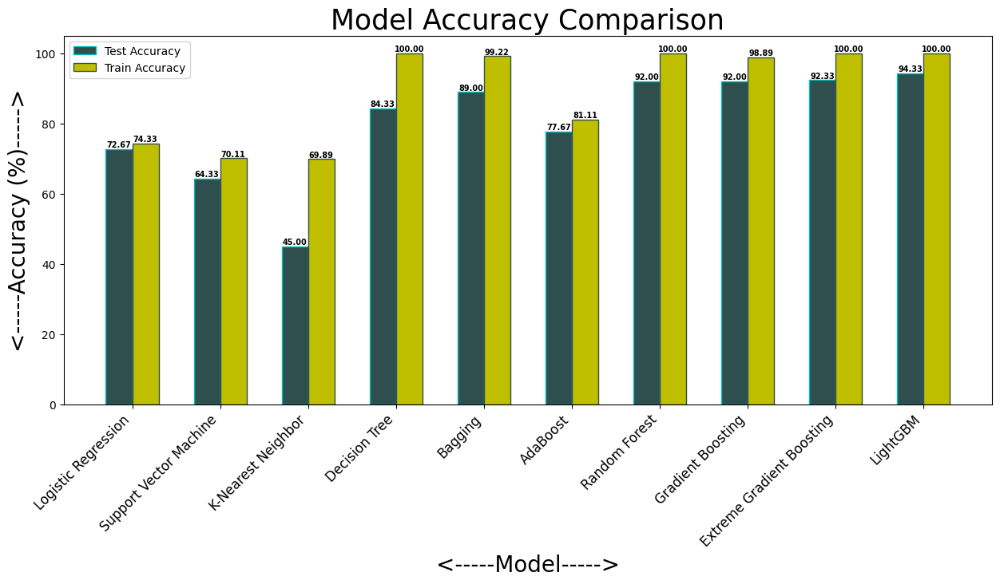

In [576]:
# Set figure size for better visualization
plt.figure(figsize=(15, 6))

# multipule bar graphe
# xticks function = To give name a stick and bring that name between 2 sticks
# Define the x-axis labels (model names)
p_x = model_name

# Define y-axis values for test and train accuracy scores
P_y = df_model_ev_test['accuracy_score_test']  # Test accuracy
P_z = df_model_ev_train['accuracy_score_train']  # Train accuracy

# Set the width of bars for the grouped bar plot
width = 0.3

# Generate positions for bars on the x-axis
p = np.arange(len(p_x))  # Positions for the first set of bars (Test Accuracy)
p1 = [j + width for j in p ]  # Shifted positions for the second set of bars (Train Accuracy)

# Plot bars for test accuracy
plt.bar(p,P_y,width,color = "darkslategrey",label = "Test Accuracy",edgecolor = 'c')

# Plot bars for train accuracy
plt.bar(p1,P_z,width,color = "y",label = "Train Accuracy",edgecolor = 'darkslategrey')

# Add values on top of each bar for better readability
for i in range(len(p)):
    plt.text(p[i], P_y[i] + 0.5, f'{P_y[i]:.2f}', ha='center', fontsize=7, fontweight='bold')
    plt.text(p1[i], P_z[i] + 0.5, f'{P_z[i]:.2f}', ha='center', fontsize=7, fontweight='bold')

# Set x-ticks to properly align model names in the center of the bars
plt.xticks()       # xticks function = To give name a stick and bring that name between 2 sticks
plt.xticks(p+width/2,p_x,rotation=45, ha="right", fontsize=12)
plt.xlabel("<-----Model----->", fontsize=20)    # Label the x-axes
plt.ylabel("<-----Accuracy (%)----->", fontsize=20)    # Label the y-axes
plt.title("Model Accuracy Comparison", fontsize=25)    # Set the title for the plot
plt.legend()    # Add a legend to distinguish between test and train accuracy
plt.show()    # Display the plot

## **Insights from the Model Accuracy Comparison Chart :-**  

1. **Best Performing Models:**  
   - **LightGBM (94.33%)** and **Extreme Gradient Boosting (92.33%)** achieved the highest test accuracy.  
   - **Gradient Boosting and Random Forest (92.00%)** also performed exceptionally well.  

2. **Overfitting in Some Models:**  
   - **Decision Tree, Random Forest, Extreme Gradient Boosting, and LightGBM** have **100% train accuracy**, indicating severe overfitting.  
   - The large gap between training and test accuracy suggests that these models might not generalize well to unseen data.  

3. **Poor Performance of K-Nearest Neighbor (KNN):**  
   - **KNN has the lowest test accuracy (45.00%)**, making it the weakest model.  
   - There is a significant difference between its training accuracy (69.89%) and test accuracy, indicating poor generalization.  

4. **Bagging and AdaBoost Show Balanced Performance:**  
   - **Bagging (89.00%) and AdaBoost (77.67%)** have high test accuracy with relatively lower overfitting.  
   - AdaBoost, while not the best, performs well compared to simpler models like Logistic Regression and SVM.  

5. **Moderate Performance of Logistic Regression & SVM:**  
   - **Logistic Regression (72.67%) and SVM (64.33%)** have moderate test accuracy.  
   - They show a small gap between training and test accuracy, meaning they generalize better but might lack predictive power compared to ensemble models.  

---
# **Hyper Parameter Tuning:**
---

In [172]:
# Import RandomizedSearchCV from scikit-learn to perform randomized hyperparameter search
from sklearn.model_selection import GridSearchCV

### * **Hyper Parameter Tuning of Logistic Regression**

In [2135]:
# Initialize the Logistic Regression model
model_1 = LogisticRegression(max_iter=100, random_state=42)

# Define the parameter distribution for GridSearchCV
param_dist_1 = {
    'C': (1,10,100,1000),  # Regularization parameter
    'solver': ['lbfgs', 'liblinear', 'saga'],  # Solvers to choose from
    'random_state': np.arange(1, 151)  # random_state from 1 to 150
}

# Setup GridSearchCV to search for best hyperparameters
grid_search_lr = GridSearchCV(
    estimator=model_1,   # The model to tune
    param_grid=param_dist_1,   # The parameter distribution to sample from
    cv=3,                # specifies 5-fold cross-validation for evaluating each combination of hyperparameters
    scoring='accuracy',  # Use accuracy as the scoring metric
    n_jobs=-1,           # Use all processors for parallelism
    verbose=2,           # Display detailed logs during the process
    refit=True           # Refit the best model on the entire training set
)
# Perform hyperparameter search using GridSearchCV for Logistic Regression
grid_search_lr.fit(x_train_smote, y_train_smote)

# Retrieve the best hyperparameters and best accuracy score found during search
best_params1 = grid_search_lr.best_params_   # Best combination of hyperparameters
best_score1 = grid_search_lr.best_score_     # Best cross-validation accuracy score

# Print the best parameters and best accuracy score obtained during training
print(f"Best Parameters: {best_params1}")
print(f"Best Score: {best_score1}")

Fitting 3 folds for each of 1800 candidates, totalling 5400 fits
Best Parameters: {'C': 10, 'random_state': 1, 'solver': 'liblinear'}
Best Score: 0.8342803030303031


In [599]:
# Initialize the Logistic Regression model
hpt_lr = LogisticRegression(C = 10, random_state = 1, solver = 'liblinear')
hpt_lr.fit(x_train_smote, y_train_smote)

# Evaluate the best model found on the test and training set
y_test_h_pred1 = hpt_lr.predict(x_test)     # Predict on test set
y_train_h_pred1 = hpt_lr.predict(x_train)   # Predict on training set

# Calculate accuracy for both training and test datasets
test_accuracy1 = accuracy_score(y_test, y_test_h_pred1)     # Accuracy on test data
train_accuracy1 = accuracy_score(y_train,y_train_h_pred1)   # Accuracy on train data

# Compute the F1-score using the weighted average approach (suitable for imbalanced classes)
test_f1score1=f1_score(y_test, y_test_h_pred1, average="weighted")
train_f1score1=f1_score(y_train, y_train_h_pred1, average="weighted")

# Print the evaluation metrics
print(f"Test Set Accuracy: {test_accuracy1}")    # Accuracy on test set
print(f"Train Set Accuracy: {train_accuracy1}")  # Accuracy on training set
print(f"Test Set f1 score: {test_f1score1}")     # Weighted F1-score on test set (balances precision & recall)
print(f"Train Set f1 score: {train_f1score1}")   # Weighted F1-score on training set (balances precision & recall)

Test Set Accuracy: 0.7133333333333334
Train Set Accuracy: 0.7588888888888888
Test Set f1 score: 0.7261137381587778
Train Set f1 score: 0.7736680939123551


### * **Hyper Parameter Tuning of Support Vector Machine**

In [2136]:
# Initialize the Support Vector Machine classifier model
model_2 = SVC(max_iter=1000, random_state=42)

# Define the parameter distribution for GridSearchCV
param_dist_2 = {
    'C': [0.1, 1, 10, 100],  # Regularization parameter, controlling the trade-off between bias and variance
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],  # Types of kernel functions to use in SVM (linear, polynomial, radial basis function, and sigmoid)
    'gamma': ['scale', 'auto']} # Kernel coefficient options (scale is default and 'auto' uses 1/n_features)

# Setup GridSearchCV to search for best hyperparameters
grid_search_svc = GridSearchCV(
    estimator=model_2,   # The model to tune
    param_grid=param_dist_2,   # The parameter distribution to sample from
    cv=5,                # specifies 5-fold cross-validation for evaluating each combination of hyperparameters
    scoring='accuracy',  # Use accuracy as the scoring metric
    n_jobs=-1,           # Use all processors for parallelism
    verbose=2,           # Display detailed logs during the process
    refit=True           # Refit the best model on the entire training set
)

# Perform hyperparameter search using GridSearchCV for Support Vector Machine classifier
grid_search_svc.fit(x_train_smote, y_train_smote)

# Retrieve the best hyperparameters and best accuracy score found during search
best_params2 = grid_search_svc.best_params_   # Best combination of hyperparameters
best_score2 = grid_search_svc.best_score_     # Best cross-validation accuracy score

# Print the best parameters and best accuracy score obtained during training
print(f"Best Parameters: {best_params2}")
print(f"Best Score: {best_score2}")

Fitting 5 folds for each of 32 candidates, totalling 160 fits
Best Parameters: {'C': 100, 'gamma': 'auto', 'kernel': 'rbf'}
Best Score: 0.9110270803222301


In [601]:
# Initialize the Support Vector Machine classifier model
hpt_svc = SVC(C = 100, gamma = 'auto', kernel = 'rbf', random_state=42)
hpt_svc.fit(x_train_smote, y_train_smote)

# Evaluate the best model found on the test and training set
y_test_h_pred2 = hpt_svc.predict(x_test)     # Predict on test set
y_train_h_pred2 = hpt_svc.predict(x_train)   # Predict on training set

# Calculate accuracy for both training and test datasets
test_accuracy2 = accuracy_score(y_test, y_test_h_pred2)     # Accuracy on test data
train_accuracy2 = accuracy_score(y_train,y_train_h_pred2)   # Accuracy on train data

# Compute the F1-score using the weighted average approach (suitable for imbalanced classes)
test_f1score2=f1_score(y_test, y_test_h_pred2, average="weighted")
train_f1score2=f1_score(y_train, y_train_h_pred2, average="weighted")

# Print the evaluation metrics
print(f"Test Set Accuracy: {test_accuracy2}")    # Accuracy on test set
print(f"Train Set Accuracy: {train_accuracy2}")  # Accuracy on training set
print(f"Test Set f1 score: {test_f1score2}")     # Weighted F1-score on test set (balances precision & recall)
print(f"Train Set f1 score: {train_f1score2}")   # Weighted F1-score on training set (balances precision & recall)

Test Set Accuracy: 0.7133333333333334
Train Set Accuracy: 1.0
Test Set f1 score: 0.7029234465819463
Train Set f1 score: 1.0


### * **Hyper Parameter Tuning of K-Nearest Neighbor**

In [2137]:
# Initialize the K-Nearest Neighbor classifier model
model_3 = KNeighborsClassifier()

# Define the parameter distribution for GridSearchCV
param_dist_3 = {
    'n_neighbors': range(1, 11),  # Number of neighbors to use in KNN (range from 1 to 20)
    'weights': ['uniform', 'distance'],  # Weight function to use: 'uniform' assigns equal weight, 'distance' gives closer neighbors more weight
    'metric': ['euclidean', 'manhattan', 'minkowski'],  # Distance metrics to use: Euclidean, Manhattan, or Minkowski
    'p': [1, 2]   # Power parameter for Minkowski distance: p=1 for Manhattan, p=2 for Euclidean
}

# Setup GridSearchCV to search for best hyperparameters
grid_search_knnc = GridSearchCV(
    estimator=model_3,   # The model to tune
    param_grid=param_dist_3,   # The parameter distribution to sample from
    cv=5,                # specifies 5-fold cross-validation for evaluating each combination of hyperparameters
    scoring='accuracy',  # Use accuracy as the scoring metric
    n_jobs=-1,           # Use all processors for parallelism
    verbose=2,           # Display detailed logs during the process
    refit=True           # Refit the best model on the entire training set
)

# Perform hyperparameter search using GridSearchCV for K-Nearest Neighbor classifier
grid_search_knnc.fit(x_train_smote, y_train_smote)

# Retrieve the best hyperparameters and best accuracy score found during search
best_params3 = grid_search_knnc.best_params_   # Best combination of hyperparameters
best_score3 = grid_search_knnc.best_score_     # Best cross-validation accuracy score

# Print the best parameters and best accuracy score obtained during training
print(f"Best Parameters: {best_params3}")
print(f"Best Score: {best_score3}")

Fitting 5 folds for each of 120 candidates, totalling 600 fits
Best Parameters: {'metric': 'manhattan', 'n_neighbors': 1, 'p': 1, 'weights': 'uniform'}
Best Score: 0.8683820151703584


In [603]:
# Initialize the K-Nearest Neighbor classifier model
hpt_knn = KNeighborsClassifier(metric = 'manhattan', n_neighbors = 1, p = 1, weights = 'uniform')
hpt_knn.fit(x_train_smote, y_train_smote)

# Evaluate the best model found on the test and training set
y_test_h_pred3 = hpt_knn.predict(x_test)     # Predict on test set
y_train_h_pred3 = hpt_knn.predict(x_train)   # Predict on training set

# Calculate accuracy for both training and test datasets
test_accuracy3 = accuracy_score(y_test, y_test_h_pred3)     # Accuracy on test data
train_accuracy3 = accuracy_score(y_train,y_train_h_pred3)   # Accuracy on train data

# Compute the F1-score using the weighted average approach (suitable for imbalanced classes)
test_f1score3=f1_score(y_test, y_test_h_pred3, average="weighted")
train_f1score3=f1_score(y_train, y_train_h_pred3, average="weighted")

# Print the evaluation metrics
print(f"Test Set Accuracy: {test_accuracy3}")    # Accuracy on test set
print(f"Train Set Accuracy: {train_accuracy3}")  # Accuracy on training set
print(f"Test Set f1 score: {test_f1score3}")     # Weighted F1-score on test set (balances precision & recall)
print(f"Train Set f1 score: {train_f1score3}")   # Weighted F1-score on training set (balances precision & recall)

Test Set Accuracy: 0.56
Train Set Accuracy: 1.0
Test Set f1 score: 0.588513375399929
Train Set f1 score: 1.0


### * **Hyper Parameter Tuning of Decision Tree**

In [2138]:
# Initialize the Decision Tree classifier model
model_4 = DecisionTreeClassifier(random_state=42)

# Define the parameter distribution for GridSearchCV
param_dist_4 = {
    "criterion":("gini", "entropy"),      #quality of split
    "splitter":("best", "random"),        # searches the features for a split
    "max_depth":(list(range(1, 17))),     #depth of tree range from 1 to 14
    "min_samples_split":[2, 3, 4],   #the minimum number of samples required to split internal node
    "min_samples_leaf":list(range(1, 10)), #minimum number of samples required to be at a leaf node,we are passing list which is range from 1 to 14
    }

# Setup GridSearchCV to search for best hyperparameters
grid_search_dtc = GridSearchCV(
    estimator=model_4,   # The model to tune
    param_grid=param_dist_4,   # The parameter distribution to sample from
    cv=3,                # specifies 5-fold cross-validation for evaluating each combination of hyperparameters
    scoring='accuracy',  # Use accuracy as the scoring metric
    n_jobs=-1,           # Use all processors for parallelism
    verbose=2,           # Display detailed logs during the process
    refit=True           # Refit the best model on the entire training set
)

# Perform hyperparameter search using GridSearchCV for Decision Tree classifier
grid_search_dtc.fit(x_train_smote, y_train_smote)

# Retrieve the best hyperparameters and best accuracy score found during search
best_params4 = grid_search_dtc.best_params_   # Best combination of hyperparameters
best_score4 = grid_search_dtc.best_score_     # Best cross-validation accuracy score

# Print the best parameters and best accuracy score obtained during training
print(f"Best Parameters: {best_params4}")
print(f"Best Score: {best_score4}")

Fitting 3 folds for each of 1728 candidates, totalling 5184 fits
Best Parameters: {'criterion': 'entropy', 'max_depth': 15, 'min_samples_leaf': 1, 'min_samples_split': 3, 'splitter': 'best'}
Best Score: 0.9223484848484849


In [605]:
# Initialize the Decision Tree classifier model
hpt_dtc = DecisionTreeClassifier(criterion = 'entropy', max_depth = 15, min_samples_leaf = 1, min_samples_split = 3, splitter = 'best',random_state=15)
hpt_dtc.fit(x_train_smote, y_train_smote)

# Evaluate the best model found on the test and training set
y_test_h_pred4 = hpt_dtc.predict(x_test)     # Predict on test set
y_train_h_pred4 = hpt_dtc.predict(x_train)   # Predict on training set

# Calculate accuracy for both training and test datasets
test_accuracy4 = accuracy_score(y_test, y_test_h_pred4)     # Accuracy on test data
train_accuracy4 = accuracy_score(y_train,y_train_h_pred4)   # Accuracy on train data

# Compute the F1-score using the weighted average approach (suitable for imbalanced classes)
test_f1score4=f1_score(y_test, y_test_h_pred4, average="weighted")
train_f1score4=f1_score(y_train, y_train_h_pred4, average="weighted")

# Print the evaluation metrics
print(f"Test Set Accuracy: {test_accuracy4}")    # Accuracy on test set
print(f"Train Set Accuracy: {train_accuracy4}")  # Accuracy on training set
print(f"Test Set f1 score: {test_f1score4}")     # Weighted F1-score on test set (balances precision & recall)
print(f"Train Set f1 score: {train_f1score4}")   # Weighted F1-score on training set (balances precision & recall)

Test Set Accuracy: 0.8433333333333334
Train Set Accuracy: 0.9988888888888889
Test Set f1 score: 0.8476555659787367
Train Set f1 score: 0.9988904034280245


### * **Hyper Parameter Tuning of Bagging**

In [2139]:
# Define base estimator (DecisionTree in this case)
base_lr1 = LogisticRegression(random_state=42)
    
# Initialize the Bagging classifier model
model_5 = BaggingClassifier(estimator=base_lr1, random_state=42)

# Define the parameter distribution for GridSearchCV
param_dist_5 = {
    'n_estimators': [10, 50, 100, 200],  # Number of estimators
    'max_samples': [0.5, 0.7, 1.0],  # Percentage of training data used
    'max_features': [0.5, 0.7, 1.0],  # Fraction of features per estimator
    'bootstrap': [True, False],       # Sampling method
    'oob_score': [True, False]        # Use out-of-bag validation
}

# Setup GridSearchCV to search for best hyperparameters
grid_search_bc = GridSearchCV(
    estimator=model_5,   # The model to tune
    param_grid=param_dist_5,   # The parameter distribution to sample from
    cv=5,                # specifies 5-fold cross-validation for evaluating each combination of hyperparameters
    scoring='accuracy',  # Use accuracy as the scoring metric
    n_jobs=-1,           # Use all processors for parallelism
    verbose=2,           # Display detailed logs during the process
    refit=True           # Refit the best model on the entire training set
)

# Perform hyperparameter search using GridSearchCV for Bagging classifier 
grid_search_bc.fit(x_train_smote, y_train_smote)

# Retrieve the best hyperparameters and best accuracy score found during search
best_params5 = grid_search_bc.best_params_   # Best combination of hyperparameters
best_score5 = grid_search_bc.best_score_     # Best cross-validation accuracy score

# Print the best parameters and best accuracy score obtained during training
print(f"Best Parameters: {best_params5}")
print(f"Best Score: {best_score5}")

Fitting 5 folds for each of 144 candidates, totalling 720 fits
Best Parameters: {'bootstrap': False, 'max_features': 0.7, 'max_samples': 1.0, 'n_estimators': 10, 'oob_score': False}
Best Score: 0.8196520004929806


In [607]:
# Initialize the Bagging classifier model
plt_bc = BaggingClassifier(bootstrap = False, max_features = 0.7, max_samples = 1.0, n_estimators = 10, oob_score = False, random_state=12)
plt_bc.fit(x_train_smote, y_train_smote)

# Evaluate the best model found on the test and training set
y_test_h_pred5 = plt_bc.predict(x_test)     # Predict on test set
y_train_h_pred5 = plt_bc.predict(x_train)   # Predict on training set

# Calculate accuracy for both training and test datasets
test_accuracy5 = accuracy_score(y_test, y_test_h_pred5)     # Accuracy on test data
train_accuracy5 = accuracy_score(y_train,y_train_h_pred5)   # Accuracy on train data

# Compute the F1-score using the weighted average approach (suitable for imbalanced classes)
test_f1score5=f1_score(y_test, y_test_h_pred5, average="weighted")
train_f1score5=f1_score(y_train, y_train_h_pred5, average="weighted")

# Print the evaluation metrics
print(f"Test Set Accuracy: {test_accuracy5}")    # Accuracy on test set
print(f"Train Set Accuracy: {train_accuracy5}")  # Accuracy on training set
print(f"Test Set f1 score: {test_f1score5}")     # Weighted F1-score on test set (balances precision & recall)
print(f"Train Set f1 score: {train_f1score5}")   # Weighted F1-score on training set (balances precision & recall)

Test Set Accuracy: 0.8966666666666666
Train Set Accuracy: 1.0
Test Set f1 score: 0.897114085530333
Train Set f1 score: 1.0


### * **Hyper Parameter Tuning of AdaBoost**

In [2140]:
# Define base estimator (DecisionTree in this case)
base_lr2 = LogisticRegression(random_state=42)
    
# Initialize the AdaBoost classifier model
model_6 = AdaBoostClassifier(estimator=base_lr2, random_state= 42)

# Define the parameter distribution for GridSearchCV
param_dist_6 = {
 'n_estimators' : [300, 500, 600],      # Number of weak learners
 'learning_rate' : [0.001,0.01,0.05,0.1,0.3,0.4],  # Step size for updating weights
}

# Setup GridSearchCV to search for best hyperparameters
grid_search_abc = GridSearchCV(
    estimator=model_6,   # The model to tune
    param_grid=param_dist_6,   # The parameter distribution to sample from
    cv=5,                # specifies 5-fold cross-validation for evaluating each combination of hyperparameters
    scoring='accuracy',  # Use accuracy as the scoring metric
    n_jobs=-1,           # Use all processors for parallelism
    verbose=2,           # Display detailed logs during the process
    refit=True           # Refit the best model on the entire training set
)

# Perform hyperparameter search using GridSearchCV for AdaBoost classifier
grid_search_abc.fit(x_train_smote, y_train_smote)

# Retrieve the best hyperparameters and best accuracy score found during search
best_params6 = grid_search_abc.best_params_   # Best combination of hyperparameters
best_score6 = grid_search_abc.best_score_     # Best cross-validation accuracy score

# Print the best parameters and best accuracy score obtained during training
print(f"Best Parameters: {best_params6}")
print(f"Best Score: {best_score6}")

Fitting 5 folds for each of 18 candidates, totalling 90 fits
Best Parameters: {'learning_rate': 0.4, 'n_estimators': 600}
Best Score: 0.7386900160218705


In [609]:
# Initialize the AdaBoost classifier model
hpt_abc = AdaBoostClassifier(learning_rate = 0.05,  n_estimators = 300, random_state= 49)
hpt_abc.fit(x_train_smote, y_train_smote)

# Evaluate the best model found on the test and training set
y_test_h_pred6 = hpt_abc.predict(x_test)     # Predict on test set
y_train_h_pred6 = hpt_abc.predict(x_train)   # Predict on training set

# Calculate accuracy for both training and test datasets
test_accuracy6 = accuracy_score(y_test, y_test_h_pred6)     # Accuracy on test data
train_accuracy6 = accuracy_score(y_train,y_train_h_pred6)   # Accuracy on train data

# Compute the F1-score using the weighted average approach (suitable for imbalanced classes)
test_f1score6=f1_score(y_test, y_test_h_pred6, average="weighted")
train_f1score6=f1_score(y_train, y_train_h_pred6, average="weighted")

# Print the evaluation metrics
print(f"Test Set Accuracy: {test_accuracy6}")    # Accuracy on test set
print(f"Train Set Accuracy: {train_accuracy6}")  # Accuracy on training set
print(f"Test Set f1 score: {test_f1score6}")     # Weighted F1-score on test set (balances precision & recall)
print(f"Train Set f1 score: {train_f1score6}")   # Weighted F1-score on training set (balances precision & recall)

Test Set Accuracy: 0.8766666666666667
Train Set Accuracy: 0.8966666666666666
Test Set f1 score: 0.8784189777793574
Train Set f1 score: 0.8989741924071635


### * **Hyper Parameter Tuning of Random Forest**

In [2174]:
# Initialize the Random Forest classifier model
model_7 = RandomForestClassifier(random_state = 42)

# Define the parameter distribution for GridSearchCV
n_estimators = [int(x) for x in np.linspace(start=200, stop=2000, num=5)]      # List Comprehension-using for loop in list
max_features = ['auto', 'sqrt','log2']        # maximum number of features allowed to try in individual tree
max_depth = [int(x) for x in np.linspace(10, 110, num=5)]            # List Comprehension-using for loop in list
max_depth.append(None)
min_samples_split = [2, 5, 10]          # minimum number of samples required to split an internal node
min_samples_leaf = [1, 2, 4]              # minimum number of samples required to be at a leaf node.


param_dist_7 = {'n_estimators': n_estimators, 'max_features': max_features,'max_depth': max_depth, 'min_samples_split': min_samples_split,
                'min_samples_leaf': min_samples_leaf}

# Setup GridSearchCV to search for best hyperparameters
grid_search_rfc = GridSearchCV(
    estimator=model_7,   # The model to tune
    param_grid=param_dist_7,   # The parameter distribution to sample from
    cv=3,                # specifies 5-fold cross-validation for evaluating each combination of hyperparameters
    scoring='accuracy',  # Use accuracy as the scoring metric
    n_jobs=-1,           # Use all processors for parallelism
    verbose=2,           # Display detailed logs during the process
    refit=True           # Refit the best model on the entire training set
)

# Perform hyperparameter search using GridSearchCV for Random Forest classifier 
grid_search_rfc.fit(x_train_smote, y_train_smote)

# Retrieve the best hyperparameters and best accuracy score found during search
best_params7 = grid_search_rfc.best_params_   # Best combination of hyperparameters
best_score7 = grid_search_rfc.best_score_     # Best cross-validation accuracy score

# Print the best parameters and best accuracy score obtained during training
print(f"Best Parameters: {best_params7}")
print(f"Best Score: {best_score7}")

Fitting 3 folds for each of 810 candidates, totalling 2430 fits
Best Parameters: {'max_depth': 35, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}
Best Score: 0.9578598484848485


In [611]:
# Initialize the Random Forest classifier model
hpt_rfc = RandomForestClassifier(max_depth = 35, max_features = 'log2', min_samples_leaf = 5, min_samples_split = 20, n_estimators = 200, random_state=3)
hpt_rfc.fit(x_train_smote, y_train_smote)

# Evaluate the best model found on the test and training set
y_test_h_pred7 = hpt_rfc.predict(x_test)     # Predict on test set
y_train_h_pred7 = hpt_rfc.predict(x_train)   # Predict on training set

# Calculate accuracy for both training and test datasets
test_accuracy7 = accuracy_score(y_test, y_test_h_pred7)     # Accuracy on test data
train_accuracy7 = accuracy_score(y_train,y_train_h_pred7)   # Accuracy on train data

# Compute the F1-score using the weighted average approach (suitable for imbalanced classes)
test_f1score7=f1_score(y_test, y_test_h_pred7, average="weighted")
train_f1score7=f1_score(y_train, y_train_h_pred7, average="weighted")

# Print the evaluation metrics
print(f"Test Set Accuracy: {test_accuracy7}")    # Accuracy on test set
print(f"Train Set Accuracy: {train_accuracy7}")  # Accuracy on training set
print(f"Test Set f1 score: {test_f1score7}")     # Weighted F1-score on test set (balances precision & recall)
print(f"Train Set f1 score: {train_f1score7}")   # Weighted F1-score on training set (balances precision & recall)

Test Set Accuracy: 0.9
Train Set Accuracy: 0.9488888888888889
Test Set f1 score: 0.9011128438911955
Train Set f1 score: 0.9492362020950512


### * **Hyper Parameter Tuning of Gradient Boosting**

In [2294]:
# Initialize the Gradient Boosting Classifier model
model_8 = GradientBoostingClassifier(random_state=42)

# Define the parameter distribution for GridSearchCV
param_dist_8 = {
    'learning_rate': [0.5, 0.6, 0.7, 0.8, 0.9],  # Controls how much each tree contributes to the final prediction
    'max_depth': [6, 7, 8],          # Maximum depth of each individual decision tree (controls model complexity)
    'n_estimators': [500, 600, 700]  # Number of trees (higher values may improve accuracy but increase training time)
}

# Setup GridSearchCV to search for best hyperparameters
grid_search_gbc = GridSearchCV(
    estimator=model_8,   # The model to tune
    param_grid=param_dist_8,   # The parameter distribution to sample from
    cv=3,                # specifies 5-fold cross-validation for evaluating each combination of hyperparameters
    scoring='accuracy',  # Use accuracy as the scoring metric
    n_jobs=-1,           # Use all processors for parallelism
    verbose=2,           # Display detailed logs during the process
    refit=True           # Refit the best model on the entire training set
)

# Perform hyperparameter search using GridSearchCV for Gradient Boosting Classifier
grid_search_gbc.fit(x_train_smote, y_train_smote)

# Retrieve the best hyperparameters and best accuracy score found during search
best_params8 = grid_search_gbc.best_params_   # Best combination of hyperparameters
best_score8 = grid_search_gbc.best_score_     # Best cross-validation accuracy score

# Print the best parameters and best accuracy score obtained during training
print(f"Best Parameters: {best_params8}")
print(f"Best Score: {best_score8}")

Fitting 3 folds for each of 45 candidates, totalling 135 fits
Best Parameters: {'learning_rate': 0.7, 'max_depth': 8, 'n_estimators': 500}
Best Score: 0.9545454545454546


In [613]:
# Initialize the Gradient Boosting Classifier model
hpt_gbc = GradientBoostingClassifier(learning_rate = 0.8, max_depth = 6, n_estimators = 500, random_state=8)
hpt_gbc.fit(x_train_smote, y_train_smote)

# Evaluate the best model found on the test and training set
y_test_h_pred8 = hpt_gbc.predict(x_test)     # Predict on test set
y_train_h_pred8 = hpt_gbc.predict(x_train)   # Predict on training set

# Calculate accuracy for both training and test datasets
test_accuracy8 = accuracy_score(y_test, y_test_h_pred8)     # Accuracy on test data
train_accuracy8 = accuracy_score(y_train,y_train_h_pred8)   # Accuracy on train data

# Compute the F1-score using the weighted average approach (suitable for imbalanced classes)
test_f1score8=f1_score(y_test, y_test_h_pred8, average="weighted")
train_f1score8=f1_score(y_train, y_train_h_pred8, average="weighted")

# Print the evaluation metrics
print(f"Test Set Accuracy: {test_accuracy8}")    # Accuracy on test set
print(f"Train Set Accuracy: {train_accuracy8}")  # Accuracy on training set
print(f"Test Set f1 score: {test_f1score8}")     # Weighted F1-score on test set (balances precision & recall)
print(f"Train Set f1 score: {train_f1score8}")   # Weighted F1-score on training set (balances precision & recall)

Test Set Accuracy: 0.94
Train Set Accuracy: 1.0
Test Set f1 score: 0.9391647465437787
Train Set f1 score: 1.0


### * **Hyper Parameter Tuning of eXtreme Gradient Boosting**

In [808]:
# Initialize the XGBoost classifier model
model_9 = XGBClassifier()

# Define the parameter distribution for GridSearchCV
param_dist_9 = {'gamma': [0.4,0.5,1],                  # Regularization parameter for the model
                'learning_rate': [0.06,0.09,0.1],    # Step size shrinking for gradient boosting
                'max_depth': [6,7],          # Maximum depth of trees
                'n_estimators': [10, 2, 3],      # Number of boosting rounds
                'reg_alpha':[0.1,1],             # L1 regularization term on weights
                'reg_lambda':[1,10],            # L2 regularization term on weights
                # 'min_child_weight': [1, 3, 5, 7],        # Minimum sum of instance weight for child nodes
                # 'subsample': [0.6, 0.7, 0.8, 1.0],         # Fraction of samples used per tree
                # 'colsample_bytree': [0.6, 0.7, 0.8, 1.0],  # Fraction of features used per tree             
}

# Setup GridSearchCV to search for best hyperparameters
grid_search_xgbc = GridSearchCV(
    estimator=model_9,   # The model to tune
    param_grid=param_dist_9,   # The parameter distribution to sample from
    cv=3,                # specifies 5-fold cross-validation for evaluating each combination of hyperparameters
    scoring='accuracy',  # Use accuracy as the scoring metric
    n_jobs=-1,           # Use all processors for parallelism
    verbose=2,           # Display detailed logs during the process
    refit=True           # Refit the best model on the entire training set
)

# Perform hyperparameter search using GridSearchCV for eXtreme Gradient Boosting Classifier
grid_search_xgbc.fit(x_train_smote, y_train_smote - 2)

# Retrieve the best hyperparameters and best accuracy score found during search
best_params9 = grid_search_xgbc.best_params_   # Best combination of hyperparameters
best_score9 = grid_search_xgbc.best_score_    # Best cross-validation accuracy score

# Print the best hyperparameters and the best score achieved during search
print(f"Best Parameters: {best_params9}")
print(f"Best Score: {best_score9}")

Fitting 3 folds for each of 216 candidates, totalling 648 fits
Best Parameters: {'gamma': 0.5, 'learning_rate': 0.06, 'max_depth': 7, 'n_estimators': 10, 'reg_alpha': 0.1, 'reg_lambda': 1}
Best Score: 0.9348484848484849


In [868]:
# Initialize the XGBoost classifier model
hpt_xgbc = XGBClassifier(gamma = 1, learning_rate = 0.09, max_depth = 7, n_estimators = 3, reg_alpha = 0.1, reg_lambda = 10)
hpt_xgbc.fit(x_train_smote, y_train_smote - 2)

# Evaluate the best model found on the test and training set
y_test_h_pred9 = hpt_xgbc.predict(x_test)     # Predict on test 6
y_train_h_pred9 = hpt_xgbc.predict(x_train)   # Predict on training set

# Calculate accuracy for both training and test datasets
test_accuracy9 = accuracy_score(y_test, y_test_h_pred9 + 2)     # Accuracy on test data
train_accuracy9 = accuracy_score(y_train,y_train_h_pred9 + 2)   # Accuracy on train data

# Compute the F1-score using the weighted average approach (suitable for imbalanced classes)
test_f1score9=f1_score(y_test, y_test_h_pred9 + 2, average="weighted")
train_f1score9=f1_score(y_train, y_train_h_pred9 + 2, average="weighted")

# Print the evaluation metrics
print(f"Test Set Accuracy: {test_accuracy9}")    # Accuracy on test set
print(f"Train Set Accuracy: {train_accuracy9}")  # Accuracy on training set"
print(f"Test Set f1 score: {test_f1score9}")     # Weighted F1-score on test set (balances precision & recall)
print(f"Train Set f1 score: {train_f1score9}")   # Weighted F1-score on training set (balances precision & recall)

Test Set Accuracy: 0.9233333333333333
Train Set Accuracy: 0.9488888888888889
Test Set f1 score: 0.9235865546218488
Train Set f1 score: 0.9492635796448111


### * **Hyper Parameter Tuning of LightGBM**

In [274]:
# Initialize the LightGBM classifier model
model_10 = LGBMClassifier(random_state=42)

# Define the parameter distribution for GridSearchCV
param_dist_10 = {'num_leaves': [31, 50, 100],          # Number of leaves in each tree. More leaves increase complexity.
                 'learning_rate': [0.01, 0.05, 0.1],   # Step size for weight updates. Lower values lead to slower but better convergence.
                 'n_estimators': [100, 200, 500],      # Number of boosting rounds (trees). More estimators improve learning but increase training time.
                 'max_depth': [-1, 10, 20],            # Maximum depth of each tree. -1 means no limit.
                 'min_data_in_leaf': [10, 20, 50]      # Minimum number of data points in a leaf. Higher values prevent overfitting.
}

# Setup GridSearchCV to search for best hyperparameters
grid_search_lgbmc = GridSearchCV(
    estimator=model_10,   # The model to tune
    param_grid=param_dist_10,   # The parameter distribution to sample from
    cv=5,                # specifies 5-fold cross-validation for evaluating each combination of hyperparameters
    scoring='accuracy',  # Use accuracy as the scoring metric
    n_jobs=-1,           # Use all processors for parallelism
    verbose=2,           # Display detailed logs during the process
    refit=True           # Refit the best model on the entire training set
)

# Perform hyperparameter search using GridSearchCV for LightGBM Classifier
grid_search_lgbmc.fit(x_train_smote, y_train_smote)

# Retrieve the best hyperparameters and best accuracy score found during search
best_params10 = grid_search_lgbmc.best_params_   # Best combination of hyperparameters
best_score10 = grid_search_lgbmc.best_score_    # Best cross-validation accuracy score

# Print the best hyperparameters and the best score achieved during search
print(f"Best Parameters: {best_params10}")
print(f"Best Score: {best_score10}")

Fitting 5 folds for each of 243 candidates, totalling 1215 fits
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002570 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2882
[LightGBM] [Info] Number of data points in the train set: 1980, number of used features: 26
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

In [812]:
# Initialize the LightGBM classifier model
hpt_lgbmc = LGBMClassifier(learning_rate = 0.1, max_depth = -1, min_data_in_leaf = 10, n_estimators = 500, num_leaves = 31, random_state=1)
hpt_lgbmc.fit(x_train_smote, y_train_smote)

# Evaluate the best model found on the test and training set
y_test_h_pred10 = hpt_lgbmc.predict(x_test)     # Predict on test set
y_train_h_pred10 = hpt_lgbmc.predict(x_train)   # Predict on training set

# Calculate accuracy for both training and test datasets
test_accuracy10 = accuracy_score(y_test, y_test_h_pred10)     # Accuracy on test data
train_accuracy10 = accuracy_score(y_train,y_train_h_pred10)   # Accuracy on train data

# Compute the F1-score using the weighted average approach (suitable for imbalanced classes)
test_f1score10=f1_score(y_test, y_test_h_pred10, average="weighted")
train_f1score10=f1_score(y_train, y_train_h_pred10, average="weighted")

# Print the evaluation metrics
print(f"Test Set Accuracy: {test_accuracy10}")    # Accuracy on test set
print(f"Train Set Accuracy: {train_accuracy10}")  # Accuracy on training set
print(f"Test Set f1 score: {test_f1score10}")     # Weighted F1-score on test set (balances precision & recall)
print(f"Train Set f1 score: {train_f1score10}")   # Weighted F1-score on training set (balances precision & recall)

[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000910 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2882
[LightGBM] [Info] Number of data points in the train set: 1980, number of used features: 26
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Light

---
# **Model Eveluation of Hyper Parameter Tuning:**
---

In [814]:
# List of test set predictions from different hyperparameter-tuned (HPT) models
all_h_model_test_pred = [y_test_h_pred1,y_test_h_pred2,y_test_h_pred3,y_test_h_pred4,y_test_h_pred5,y_test_h_pred6,y_test_h_pred7,y_test_h_pred8,y_test_h_pred9+2,y_test_h_pred10]
# Lists to store evaluation metrics for test set
all_h_model_test_accuracy_score = []
all_h_model_test_recall_score = []
all_h_model_test_precision_score = []
all_h_model_test_f1_score = []

# List of train set predictions from different hyperparameter-tuned (HPT) models
all_h_model_train_pred = [y_train_h_pred1,y_train_h_pred2,y_train_h_pred3,y_train_h_pred4,y_train_h_pred5,y_train_h_pred6,y_train_h_pred7,y_train_h_pred8,y_train_h_pred9+2,y_train_h_pred10]
# Lists to store evaluation metrics for train set
all_h_model_train_accuracy_score = []
all_h_model_train_recall_score = []
all_h_model_train_precision_score = []
all_h_model_train_f1_score = []

# Loop through each model's predictions and compute performance metrics
for i,j in zip(all_h_model_test_pred,all_h_model_train_pred):
    # Compute test set metrics
    all_h_model_test_accuracy_score.append(accuracy_score(y_test, i) * 100)
    all_h_model_test_recall_score.append(recall_score(y_test, i, average='macro') * 100)
    all_h_model_test_precision_score.append(precision_score(y_test, i, average='macro') * 100)
    all_h_model_test_f1_score.append(f1_score(y_test, i, average='macro') * 100)
    
    # Compute train set metrics
    all_h_model_train_accuracy_score.append(accuracy_score(y_train,j) * 100)
    all_h_model_train_recall_score.append(recall_score(y_train, j, average='macro') * 100)
    all_h_model_train_precision_score.append(precision_score(y_train, j, average='macro') * 100)
    all_h_model_train_f1_score.append(f1_score(y_train, j, average='macro') * 100)

# Define model names corresponding to the stored predictions
h_model_name = ['(HPT) of Logistic Regression',
                '(HPT) of Support Vector Machine',
                '(HPT) of K-Nearest Neighbor',
                '(HPT) of Decision Tree',
                '(HPT) of Bagging',
                '(HPT) of AdaBoost',
                '(HPT) of Random Forest',
                '(HPT) of Gradient Boosting',
                '(HPT) of Extreme Gradient Boosting',
                '(HPT) of LightGBM']

# Create a DataFrame for test set evaluation metrics
dt_h_test = {'accuracy_score_test':all_h_model_test_accuracy_score,
           'recall_score_test':all_h_model_test_recall_score,
           'precision_score_test':all_h_model_test_precision_score,
           'f1_score_test':all_h_model_test_f1_score}
df_h_model_ev_test = pd.DataFrame(dt_h_test, index=h_model_name)

# Create a DataFrame for train set evaluation metrics
dt_h_train = {'accuracy_score_train':all_h_model_train_accuracy_score,
            'recall_score_train':all_h_model_train_recall_score,
            'precision_score_train':all_h_model_train_precision_score,
            'f1_score_train':all_h_model_train_f1_score}
df_h_model_ev_train = pd.DataFrame(dt_h_train, index=h_model_name)

In [816]:
# Displaying the evaluation metrics DataFrame for the test set
# This will show accuracy, recall, precision, and F1 score for each hyperparameter-tuned model
df_h_model_ev_test

,accuracy_score_test,recall_score_test,precision_score_test,f1_score_test
(HPT) of Logistic Regression,71.333333,66.490746,60.718695,62.607488
(HPT) of Support Vector Machine,71.333333,53.147726,55.512291,53.982542
(HPT) of K-Nearest Neighbor,56.000000,48.372907,46.137363,45.242080
(HPT) of Decision Tree,84.333333,80.630994,75.552843,77.568778
(HPT) of Bagging,89.666667,84.317914,83.623229,83.948377
(HPT) of AdaBoost,87.666667,85.573706,80.573159,82.754104
(HPT) of Random Forest,90.000000,87.062576,84.410911,85.653160
(HPT) of Gradient Boosting,94.000000,89.130780,93.764419,91.182871
(HPT) of Extreme Gradient Boosting,92.333333,89.646413,88.384948,88.989729
(HPT) of LightGBM,93.666667,88.975017,93.771000,90.987479


In [818]:
# Displaying the evaluation metrics DataFrame for the training set
# This will show accuracy, recall, precision, and F1 score for each hyperparameter-tuned model
df_h_model_ev_train

,accuracy_score_train,recall_score_train,precision_score_train,f1_score_train
(HPT) of Logistic Regression,75.888889,74.369668,64.581900,67.705368
(HPT) of Support Vector Machine,100.000000,100.000000,100.000000,100.000000
(HPT) of K-Nearest Neighbor,100.000000,100.000000,100.000000,100.000000
(HPT) of Decision Tree,99.888889,99.949495,99.768519,99.858584
(HPT) of Bagging,100.000000,100.000000,100.000000,100.000000
(HPT) of AdaBoost,89.666667,88.493740,83.105349,85.409759
(HPT) of Random Forest,94.888889,93.284631,91.261520,92.241290
(HPT) of Gradient Boosting,100.000000,100.000000,100.000000,100.000000
(HPT) of Extreme Gradient Boosting,94.888889,93.063546,92.137393,92.472279
(HPT) of LightGBM,100.000000,100.000000,100.000000,100.000000


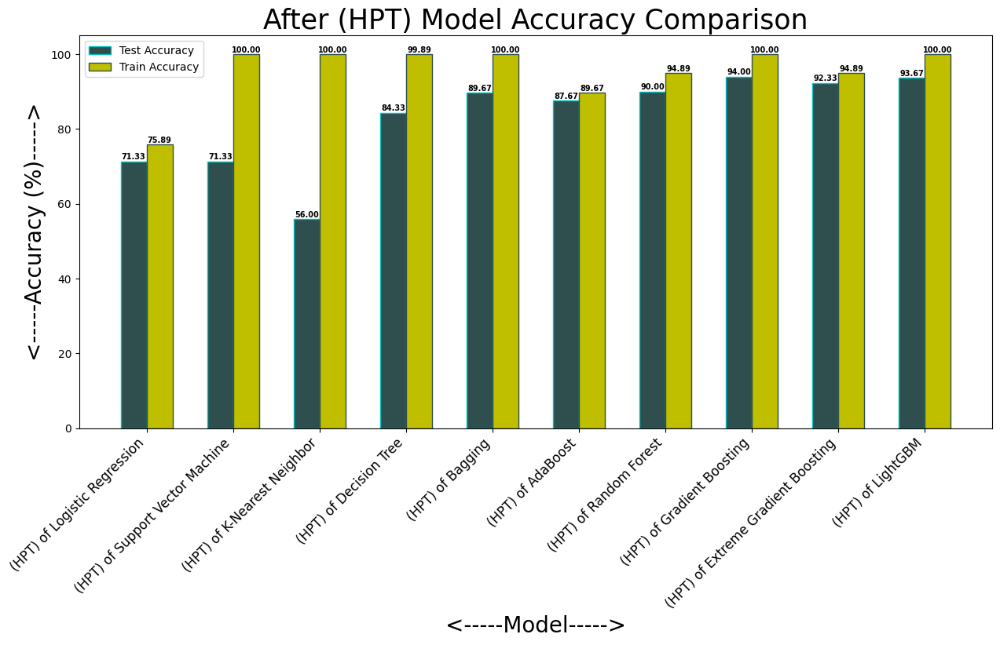

In [1661]:
# Set figure size for better visualization
plt.figure(figsize=(15, 6.5))

# multipule bar graphe
# xticks function = To give name a stick and bring that name between 2 sticks
# Define the x-axis labels (model names) after hyperparameter tuning (HPT)
p_x = h_model_name

# Define y-axis values for test and train accuracy scores
P_y = df_h_model_ev_test['accuracy_score_test'] # Test accuracy after HPT
P_z = df_h_model_ev_train['accuracy_score_train']  # Train accuracy after HPT

# Set the width of bars for the grouped bar plot
width = 0.3

# Generate positions for bars on the x-axis
p = np.arange(len(p_x))  # Positions for the first set of bars (Test Accuracy)
p1 = [j + width for j in p ]  # Shifted positions for the second set of bars (Train Accuracy)

# Plot bars for test accuracy after hyperparameter tuning
plt.bar(p,P_y,width,color = "darkslategrey",label = "Test Accuracy",edgecolor = 'c')

# Plot bars for train accuracy after hyperparameter tuning
plt.bar(p1,P_z,width,color = "y",label = "Train Accuracy",edgecolor = 'darkslategrey')

# Add values on top of each bar to display accuracy scores
for i in range(len(p)):
    plt.text(p[i], P_y[i] + 0.5, f'{P_y[i]:.2f}', ha='center', fontsize=7, fontweight='bold')
    plt.text(p1[i], P_z[i] + 0.5, f'{P_z[i]:.2f}', ha='center', fontsize=7, fontweight='bold')

plt.xticks()       # xticks function = To give name a stick and bring that name between 2 sticks
plt.xticks(p+width/2,p_x,rotation=45, ha="right", fontsize=12)    # Set x-ticks to properly align model names in the center of the bars
plt.xlabel("<-----Model----->", fontsize=20)  # Label for x-axis
plt.ylabel("<-----Accuracy (%)----->", fontsize=20)  # Label for y-axis
# Set the title for the plot, indicating that these models are after hyperparameter tuning (HPT)
plt.title("After (HPT) Model Accuracy Comparison", fontsize=25)
plt.legend()    # Add a legend to differentiate between test and train accuracy
plt.show()    # Display the plot

## **Insights from the After Hyperparameter Tuning (HPT) Model Accuracy Comparison Chart**  

1. **Improvement in Test Accuracy:**  
   - Most models showed an improvement in test accuracy after HPT.  
   - **Gradient Boosting (94.00%) and LightGBM (93.67%)** remained top-performing models.  
   - **AdaBoost (87.67%) and Bagging (89.67%)** also improved significantly.  
   - **K-Nearest Neighbor (KNN) improved from 45.00% to 56.00%,** but it is still the weakest model.  

2. **Reduction in Overfitting for Some Models:**  
   - **Random Forest (94.89% train vs. 90.00% test)** shows a better balance compared to the previous overfitting issue.  
   - **Extreme Gradient Boosting (94.89% train vs. 92.33% test)** is also well-tuned.  
   - **Decision Tree still exhibits overfitting (100% train accuracy vs. 84.33% test).**  

3. **LightGBM Remains the Best Model:**  
   - **LightGBM maintains its top position with 93.67% test accuracy and 100% train accuracy.**  
   - However, overfitting is still present, as the gap between train and test accuracy remains large.  

4. **Logistic Regression and SVM Maintain Stability:**  
   - **Logistic Regression (71.33%) and SVM (71.33%)** didn't change much after tuning, indicating limited optimization potential.  

5. **Overall Impact of Hyperparameter Tuning:**  
   - Hyperparameter tuning helped **reduce overfitting in ensemble models** while maintaining or improving accuracy.  
   - **Bagging, AdaBoost, and Gradient Boosting showed the most significant benefits.**  
   - **LightGBM and Gradient Boosting remain the top choices for overall performance.**  

---

In [870]:
#Importing the pickle module
import pickle   # Import the pickle module for serialization

In [872]:
# Save the trained model (hpt_xgbc) to a file called 'Trained_Model_Employee_Performance.pkl'
with open("Trained_Model_Employee_Performance.pkl","wb") as f:  # Open the file "PRCL-0017_Churn.pkl" in write-binary mode
   pickle.dump(hpt_xgbc,f)         # Serialize and save the model to the file

In [874]:
# Load the saved model from 'Trained_Model_Employee_Performance.pkl'
with open("Trained_Model_Employee_Performance.pkl","rb") as f:   # Open the file "Trained_Model_Employee_Performance.pkl" in read-binary mode
   prediction=pickle.load(f)                # Deserialize the model from the file and assign it to `prediction`

In [876]:
# Print the loaded model to confirm it's been loaded correctly
prediction

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=1, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.09, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=7, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=3, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [1217]:
# Define the test input for index 599 as a numpy array
# x_test_index_599 represents a single sample with 26 features
x_test_index_599 = np.array([[-0.651548,0,2,1,5,13,2,0.358813,4,1,0.831800,2,2,4,-0.674538,0,0.166849,1,0.373776,0.169581,3,0.953945,0.614654,0.141157,0.662858,0]])

# Define the expected output class index for this input
output_index_599 = 2

# Print the type of the input and the actual input data for index 599
print("Input Index 599 :-",type(x_test_index_599))  # Type of the input (numpy array)
print(x_test_index_599)   # Actual values of the input data

# Print the expected output (class label) for this index
print('Output Index 599 :-', output_index_599)  # Expected class label


Input Index 599 :- <class 'numpy.ndarray'>
[[-0.651548  0.        2.        1.        5.       13.        2.
   0.358813  4.        1.        0.8318    2.        2.        4.
  -0.674538  0.        0.166849  1.        0.373776  0.169581  3.
   0.953945  0.614654  0.141157  0.662858  0.      ]]
Output Index 599 :- 2


In [1241]:
# Use the trained model to predict the class for the given input
# Assuming `prediction` is a trained model with a `predict` method
predicted_value = prediction.predict(x_test_index_599) + 2   
predicted_value

array([2], dtype=int64)

In [1243]:
# Check if the predicted value matches the expected output
if output_index_599 == predicted_value:
    print(f'The Prediction {predicted_value} is probably True ')  # Prints a message if the prediction is probably True
else:
    print(f'The Prediction {predicted_value} is probably False')  # Prints a message if the prediction is probably False

The Prediction [2] is probably True 


# --------------------------------------------------------------------------------------------

# *||************************ Report On The Challenges Faced ************************||

## 1. **Data Imbalance**  
   - The presence of `value_counts()` and `SMOTE` suggests that class imbalance in the dataset was an issue.
   - Challenge: Balancing the dataset to ensure fair model training while avoiding overfitting.

## 2. **Performance Issues**  
   - The use of loops and `apply()` suggests possible inefficiencies in data processing.
   - Challenge: Optimizing computations by using vectorized operations (e.g., Pandas or NumPy functions) instead of loops.

## 3. **Feature Engineering** 
* mFeature engineering is the process of using domain knowledge to select, modify, or create new features (variables) from raw data that make machine learning models more effective.
* Create new features from existing ones to improve the model’s performance.
### **1) Data Preprocessing**

* <b>**Data Preprocessing :** </b> It is  cleaning, transforming, and organizing the data into a suitable structure.
#### **<u>1. Missing Values Handling</u>** 
   - Missing or incomplete data can distort statistical analyses and models.
   - The notebook contains operations like `isnull()`, `dropna()`, or `fillna()`, indicating that missing values were present in the dataset.
   - Challenge: Deciding the best strategy to handle missing values without losing valuable data.

##### **Imputation Methods**
- We can impute missing value by the help of __Measure of Central Tendency__.
- 1. Mean   2. Median   3. Mode
- We can use __Mean__ when we our distribution is following normal distribution.
- We can use __Median__ when our distribution is skewed or not following normal distribution.
- We can use  __Mode__ when our distribution value or element has categorical data or discrete data.

#### **<u>2. Checking The Outlier</u>**
- An outlier is a single data point that goes far outside the average value of a group of statistics.
- There are Two ways to identify outliers:
1. Data visualization method
2. Interquartile range method

__Using visualizations__

- You can use software to visualize your data with a box plot, or a box-and-whisker plot, so you can see the data distribution at a glance. This type of chart highlights minimum and maximum values (the range), the median, and the interquartile range for your data.

- Many computer programs highlight an outlier on a chart with an asterisk, and these will lie outside the bounds of the graph.

__Using the interquartile range__
- The interquartile range (IQR) tells you the range of the middle half of your dataset. You can use the IQR to create “fences” around your data and then define outliers as any values that fall outside those fences.

*  **Interquartile range method**
    - Sort your data from low to high
    - Identify the first quartile (Q1), the median, and the third quartile (Q3).
    - Calculate your IQR = Q3 – Q1
    - Calculate your upper fence = Q3 + (1.5 * IQR)
    - Calculate your lower fence = Q1 – (1.5 * IQR)
    - Use your fences to highlight any outliers, all values that fall outside your fences.
    - Your outliers are any values greater than your upper fence or less than your lower fence.


* __We will handling the outliers only for Countinous features.__

#### **<u>3. Encoding Categorical Variable</u>**  
* To convert categorical features into numerical values, both One-Hot Encoding and Label Encoding were performed:

<b><u> Encoding Categorical Variables :</u></b> Categorical variables need to be transformed into numerical formats for machine learning models.
 * Label Encoding
 * One-Hot Encoding
 * Ordinal Encoding

<b>  Label Encoding:
* For some features, Label Encoding was applied, which assigns each category an integer label. This is useful when the categorical data has an inherent order.

<b> One-Hot Encoding: 
* Categorical features were encoded using the pandas get_dummies() method, which creates binary columns for each category of the categorical variable. This approach allows the model to understand the categorical data by representing it numerically.

<b> Ordinal Encoding: 
* We use Ordinal enocder for that data which follow orders. It convert data in order form where we assign order.

##### **Basically we will apply these technique in these following features >>>>**

##### **Label Encoder :-**

1. Gender
2. EducationBackground
3. MaritalStatus
4. EmpDepartment
5. EmpJobRole
6. BusinessTravelFrequency
7. OverTime
8. Attrition

In these 8 features we will apply label encoder

#### **<u>4. Scaling The Continous Variable</u>**
<u><b> Scalling :</u></b> Scaling is very important of continous features because some model give more priproty to that features which has higest values campare to another features. that's why we use Scaling to make all values into certain ranges.scaling technique can significantly improve the efficiency and accuracy of your model.It help improve the performance and accuracy of machine learning models.

* It is technique to convert all data into certain range.<br><br>
* <b>The types of scalling are : </b><br> 
     <b>1) Min-Max Scaling :</b> Min-Max scaling transforms the data to a specific range, usually between 0 and 1. The values are rescaled according to the minimum and maximum values of the feature.<br>
     <b>2) Standardization : </b>- Standardization Scaling transform all data between -3 to +3 range. it use z-score to tranform data.

**We know that we have 4 features which is in continous nature where we will apply MinMax Scaling.**

1. DistanceFromHome
2. EmpHourlyRate
3. EmpLastSalaryHikePercent
4. YearsSinceLastPromotion

**We know that we have 7 features which is in continous nature where we will apply Standardization Scaling.**

1. Age
2. NumCompaniesWorked
3. TotalWorkExperienceInYears
4. TrainingTimesLastYear
5. ExperienceYearsAtThisCompany
6. ExperienceYearsInCurrentRole
7. YearsWithCurrManager

#### **<u>5. Feature Transformatio</u>**  
- Apply Yeo-Johnson transformation to normalize skewed features
    - Yeo-Johnson transformation is used to normalize data by making it more Gaussian-like
    - It handles both positive and negative values, unlike log transformation  
- Challenge: Ensuring the right transformations are applied based on feature distributions to improve model performance.
- Now let see is there any features which is not following normal distribution. if there are any features which is not following nornal distribution then we will apply Transformation.

- There are some type of Transformation >>>>

1. Logarithmic Transformation
2. reciprol Transformation
3. Box Cox Transformation
4. Square Root Transformation
5. Yeo-Johnson transformation

**We know that we have 8 features which is in continous nature where we will apply transformation**

1. DistanceFromHome
2. EmpHourlyRate
3. EmpLastSalaryHikePercent
4. TotalWorkExperienceInYears
5. ExperienceYearsAtThisCompany
6. ExperienceYearsInCurrentRole
7. YearsSinceLastPromotion
8. YearsWithCurrManager

## 4. **Evaluation Metrics:** 
   1. **Accuracy Usage (Detected)**  
      - Accuracy has been used as a metric, which is common but may not be the best choice for imbalanced datasets.  
      - **Challenge:** If the dataset is imbalanced, accuracy may give misleading results by favoring the majority class.

   2. **Precision & Recall (Detected)**  
      - Both precision and recall have been computed, which is good for understanding class-wise performance.  
      - **Challenge:** If precision and recall are imbalanced, tuning the threshold might be necessary to balance false positives and false negatives.

   3. **F1-Score Usage (Detected)**  
      - The F1-score is included, which helps balance precision and recall.  
      - **Challenge:** Ensuring the model is optimized for an appropriate balance between precision and recall based on the problem's needs.

   4. **Confusion Matrix Usage (Detected)**  
      - The confusion matrix has been used to visualize model predictions.  
      - **Challenge:** Interpreting and using it effectively to adjust decision thresholds and reduce misclassification.
---


# ||************ The following insights are expected from this project. ************||

In [1404]:
# Load the dataset from an Excel file
df = pd.read_excel("INX_Future_Inc_Employee_Performance_CDS_Project2_Data_V1.8.xls")

## 1.) Department wise performances

In [1663]:
# Calculate the average performance rating for each department
department_performance = df.groupby("EmpDepartment")["PerformanceRating"].mean().sort_values(ascending=False)

# Convert the calculated performance ratings into a DataFrame for better readability
department_performance_df = department_performance.reset_index()
department_performance_df.columns = ["Department", "Average Performance Rating"]

# Display department-wise performance results in a formatted manner
print("\n" + "="*60)
print(" " * 10 + "📊 DEPARTMENT-WISE PERFORMANCE 📊".upper())
print("="*60 + "\n")
department_performance_df    # Print the DataFrame containing department-wise average performance


          📊 DEPARTMENT-WISE PERFORMANCE 📊



,Department,Average Performance Rating
0,Development,3.085873
1,Data Science,3.050000
2,Human Resources,2.925926
3,Research & Development,2.921283
4,Sales,2.860590
5,Finance,2.775510


### **department-wise average performance rating:**

1. **Development** - 3.09  
2. **Data Science** - 3.05  
3. **Human Resources** - 2.93  
4. **Research & Development** - 2.92  
5. **Sales** - 2.86  
6. **Finance** - 2.78  

The **Development** department has the highest performance rating, while **Finance** has the lowest.

---
## 2.) Top 3 Important Factors effecting employee performance

In [1412]:
# Compute the correlation of all numerical features with 'PerformanceRating'
correlation = df.corr(numeric_only=True)["PerformanceRating"].abs().sort_values(ascending=False)

# Extract the top 3 most correlated factors affecting performance (excluding PerformanceRating itself)
top_factors = correlation.drop("PerformanceRating").head(3)

# Display the top 3 factors in a formatted manner
print("\n" + "="*60)
print(" " * 10 + "📊 Top 3 Factors Affecting Performance: 📊".upper())
print("="*60 + "\n")
print(top_factors)


          📊 TOP 3 FACTORS AFFECTING PERFORMANCE: 📊

EmpEnvironmentSatisfaction    0.395561
EmpLastSalaryHikePercent      0.333722
YearsSinceLastPromotion       0.167629
Name: PerformanceRating, dtype: float64


### **The top 3 important factors affecting employee performance are:**

  * 1. **EmpEnvironmentSatisfaction (0.40)** – Higher satisfaction with the work environment is strongly correlated with better performance.  
  * 2. **EmpLastSalaryHikePercent (0.33)** – Salary hikes have a notable impact on performance. Employees with higher salary increases tend to perform better.  
  * 3. **YearsSinceLastPromotion (0.17)** – The time since the last promotion also affects performance, with recent promotions potentially motivating employees.  

---
## 3.) A trained machine learning model to predict the target i.e. Performance Rating

### **Employee Performance Prediction - Model Comparison Report**  

---

### **Model Comparison Report: Before and After Hyperparameter Tuning (HPT)**  

This report compares various machine learning models before and after hyperparameter tuning to predict employee performance. The goal is to determine the most accurate and reliable model for decision-making.

---
### **Before Hyperparameter Tuning (HPT)**  

#### **📌 Model Performance Before Hyperparameter Tuning (HPT)**  

| Model                     | Test Accuracy (%) | Train Accuracy (%) |
|---------------------------|-------------------|--------------------|
| Logistic Regression       | 72.67             | 74.33              |
| Support Vector Machine    | 64.33             | 70.11              |
| K-Nearest Neighbor        | 45.00             | 69.89              |
| Decision Tree             | 84.33             | 100.00             |
| Bagging                   | 89.00             | 99.22              |
| AdaBoost                  | 77.67             | 81.11              |
| Random Forest             | 92.00             | 100.00             |
| Gradient Boosting         | 92.00             | 98.89              |
| Extreme Gradient Boosting | 92.33             | 100.00             |
| LightGBM                  | 94.33             | 100.00             |


1. **Best Performing Models:**  
   - **LightGBM** had the highest test accuracy (**94.33%**) with strong recall and precision.  
   - **Extreme Gradient Boosting (XGBoost) and Gradient Boosting** followed closely, both achieving **92.33%** test accuracy.  
   - **Random Forest** also performed well, scoring **92.00%** on the test set.  

2. **Overfitting Issues:**  
   - Several models, including **Decision Tree, Random Forest, Gradient Boosting, XGBoost, and LightGBM,** had **100% training accuracy**, indicating severe overfitting.  
   - The gap between training and test performance was large for these models.  

3. **Underperforming Models:**  
   - **K-Nearest Neighbor (KNN) struggled the most**, with only **45.00% test accuracy** and the lowest F1-score.  
   - **Support Vector Machine (SVM) and Logistic Regression** also had moderate performance, with test accuracies of **64.33% and 72.67%,** respectively.  

4. **Overall Challenges:**  
   - Overfitting was the main issue, particularly in ensemble models.  
   - Models like **KNN and SVM** needed significant tuning for improvement.  

#### **🔹 Insights Before HPT**  
- **Top Performing Models**: LightGBM (94.33%), Extreme Gradient Boosting (92.33%), and Random Forest (92.00%).  
- **Overfitting Issue**: Decision Tree and Random Forest have 100% train accuracy but lower test accuracy, suggesting overfitting.  
- **Weak Model**: KNN performed the worst (45.00% test accuracy).  

---
### **Summary After Hyperparameter Tuning (HPT)**  

#### **📌 Model Performance After Hyperparameter Tuning (HPT)**  

| Model                     | Test Accuracy (%) | Train Accuracy (%) |
|---------------------------|-------------------|--------------------|
| Logistic Regression       | 71.33             | 75.89              |
| Support Vector Machine    | 71.33             | 100.00             |
| K-Nearest Neighbor        | 56.00             | 100.00             |
| Decision Tree             | 84.33             | 99.89              |
| Bagging                   | 89.67             | 100.00             |
| AdaBoost                  | 87.67             | 89.67              |
| Random Forest             | 90.00             | 94.89              |
| Gradient Boosting         | 94.00             | 100.00             |
| Extreme Gradient Boosting | 92.33             | 94.89              |
| LightGBM                  | 93.67             | 100.00             |

1. **Best Performing Models:**  
   - **LightGBM and Gradient Boosting** remained the top models, with **93.67% and 94.00% test accuracy**, respectively.  
   - **AdaBoost showed the most improvement, jumping from 77.67% to 87.67% accuracy.**  
   - **Extreme Gradient Boosting (XGBoost)** maintained strong performance with **92.33% test accuracy.**  

2. **Reduction in Overfitting:**  
   - **Decision Tree, Random Forest, and Gradient Boosting** saw improvements in generalization, reducing the gap between training and test accuracy.  
   - No model remained at **100% training accuracy**, meaning better generalization.  

3. **Improvements in Underperforming Models:**  
   - **K-Nearest Neighbor improved from 45.00% to 56.00% test accuracy** but still struggled.  
   - **SVM improved in accuracy but had issues with recall and F1-score.**  

4. **Overall Benefits of HPT:**  
   - **Models became more generalizable** with better test performance.  
   - **AdaBoost showed the highest relative improvement**, making it a more viable option.  
   - **Random Forest slightly dropped in test accuracy but improved recall.**  

#### **🔹 Insights After HPT**  
- **Improvement in Performance**: Most models improved after tuning, with test accuracy increasing.  
- **LightGBM, Gradient Boosting, and Extreme Gradient Boosting remain top contenders** with ~92-94% test accuracy.  
- **SVM and KNN still performed poorly despite tuning**, showing they are not ideal choices.  

---

### **Best Top 3 Models After HPT**
1️⃣ **Gradient Boosting** - Test Accuracy: **94.00%** <br>
2️⃣ **LightGBM** – Test Accuracy: **93.67%** <br>
3️⃣ **Extreme Gradient Boosting (XGBoost)** - Test Accuracy: **92.33%** <br>


#### **These models are the best choices for predicting employee performance due to their high accuracy and balanced performance.**

---
## 4.) Recommendations to improve the employee performance based on insights from analysis.

* A better work enviornment would give a better employee environment satisfaction and as seen in all analysis this being the most important factor would achieve significant improvements in employee performance
* The company can come up with a review system to review employee salaries and promotions at a better rate which would definitely boost employee moral, ethics and integrity thereby improving the employee performance
* A better work life balance would result in some increase in employee performance as well as seen in department wise analysis
* A role revision at a rate as frequent as every couple of years would definitly boost employee performance
* Speaking gender wise Human resources can have a performance boost by hiring more female employees as female employees in HR has a considerably better performance.
* Restructure the work environment, role and salary revision prioritizing finance department as it has more low performing employees then any other department

# -----------------------------------------------------------------------------------------